<a href="https://colab.research.google.com/github/pedromperezc/EY_CHALLENGE/blob/master/notebooks/MODEL_BUILDING_NOTEBOOK.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 2022 EY Challenge Level 1: Local Frog Discovery Tool notebook

EY and Microsoft proposed that we find a predictive model that allows us to predict the geographical distribution of frog species on the earth's surface to build a better world. It is the aim of this work. We wanted to create the best model possible that allows us to understand environmental health using frogs as indicators.

In this work, we create a model to predict the distribution of the frog species (Littoral Fallax) in the Australian continent using machine learning. We build our model using climate information available in the Microsoft Terraclime database.

The objective of this challenge was to use the presence of frog species as biomarkers to understand the environmental health of a given region. We want to predict the occurrence of the Littoral Fallax frog species in the Australian continent using environmental information extracted from Microsoft Terraclime.



# INSTALLATIONS

In [ ]:
!pip install optuna -q

     |████████████████████████████████| 308 kB 22.4 MB/s 
     |████████████████████████████████| 209 kB 48.9 MB/s 
     |████████████████████████████████| 81 kB 9.1 MB/s 
     |████████████████████████████████| 78 kB 5.1 MB/s 
     |████████████████████████████████| 146 kB 69.6 MB/s 
     |████████████████████████████████| 112 kB 45.7 MB/s 
     |████████████████████████████████| 49 kB 5.6 MB/s 


In [ ]:
!pip install pystac_client -q

     |████████████████████████████████| 137 kB 23.2 MB/s 
     |████████████████████████████████| 62 kB 389 kB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-colab 1.0.0 requires requests~=2.23.0, but you have requests 2.28.0 which is incompatible.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0.8.3 which is incompatible.


In [ ]:
!pip install planetary_computer -q

     |████████████████████████████████| 11.1 MB 31.6 MB/s 


In [ ]:
!pip install fsspec -q

     |████████████████████████████████| 140 kB 23.2 MB/s 


In [ ]:
!pip install requests -q

In [ ]:
!pip install aiohttp -q

     |████████████████████████████████| 1.1 MB 20.7 MB/s 
     |████████████████████████████████| 94 kB 3.8 MB/s 
     |████████████████████████████████| 144 kB 57.2 MB/s 
     |████████████████████████████████| 271 kB 47.6 MB/s 


In [ ]:
!pip install xarray[io] -q

     |████████████████████████████████| 45 kB 3.8 MB/s 
     |████████████████████████████████| 2.3 MB 55.2 MB/s 
     |████████████████████████████████| 19.3 MB 1.1 MB/s 
     |████████████████████████████████| 153 kB 58.8 MB/s 
     |████████████████████████████████| 55 kB 3.9 MB/s 
     |████████████████████████████████| 114 kB 43.6 MB/s 
     |████████████████████████████████| 6.2 MB 9.4 MB/s 


In [ ]:
!pip install zarr -q

In [ ]:
!pip install contextily -q

# IMPORTING DEPENDENCIES


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Supress Warnings 
import warnings
warnings.filterwarnings('ignore')

# Import common libraies
import numpy as np
import matplotlib.pyplot as plt
import math
import scipy.stats as stats


# Import Planetary Computer tools
import pystac_client
import planetary_computer
import pandas as pd
import os
import seaborn as sns
import imageio
from IPython.display import Image
import fsspec
import xarray as xr
from itertools import cycle
import contextily as cx
import pystac


#transformations:
from sklearn.preprocessing import QuantileTransformer
from sklearn.preprocessing import StandardScaler, scale
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import MaxAbsScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import PowerTransformer
from sklearn.preprocessing import Normalizer
from sklearn.preprocessing import KBinsDiscretizer
from sklearn.compose import ColumnTransformer

#pipeline model selecction
from imblearn.pipeline import Pipeline as Pipeline
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.calibration import CalibratedClassifierCV, CalibrationDisplay
from sklearn.model_selection import train_test_split # To split data
from sklearn.metrics import f1_score, accuracy_score, ConfusionMatrixDisplay, classification_report, roc_auc_score
from sklearn.model_selection import cross_val_score

#Models
from sklearn.cluster import KMeans
import lightgbm as lgb
from sklearn.linear_model import LogisticRegression, SGDClassifier, LogisticRegressionCV
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier, GradientBoostingClassifier
from sklearn.ensemble import BaggingClassifier, AdaBoostClassifier
from xgboost import XGBClassifier, XGBRFClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.svm import LinearSVC
from sklearn.tree import DecisionTreeClassifier

#Sampling
from imblearn.under_sampling import RandomUnderSampler
from imblearn.under_sampling import InstanceHardnessThreshold
from imblearn.over_sampling import SMOTE


#general
from matplotlib.pyplot import figure
from math import radians
from sklearn.metrics.pairwise import haversine_distances
from math import radians
from pathlib import Path
import random

#hyperparameter optimization
from hyperopt import tpe, hp, fmin, STATUS_OK,Trials
from hyperopt.pyll.base import scope
import optuna

In [ ]:
!pip freeze

absl-py==1.0.0
affine==2.3.1
aiohttp==3.8.1
aiosignal==1.2.0
alabaster==0.7.12
albumentations==0.1.12
alembic==1.8.0
altair==4.2.0
appdirs==1.4.4
argon2-cffi==21.3.0
argon2-cffi-bindings==21.2.0
arviz==0.12.1
asciitree==0.3.3
astor==0.8.1
astropy==4.3.1
astunparse==1.6.3
async-timeout==4.0.2
asynctest==0.13.0
atari-py==0.2.9
atomicwrites==1.4.0
attrs==21.4.0
audioread==2.1.9
autograd==1.4
autopage==0.5.1
Babel==2.10.1
backcall==0.2.0
beautifulsoup4==4.6.3
bleach==5.0.0
blis==0.4.1
bokeh==2.3.3
Bottleneck==1.3.4
branca==0.5.0
bs4==0.0.1
CacheControl==0.12.11
cached-property==1.5.2
cachetools==4.2.4
catalogue==1.0.0
certifi==2022.5.18.1
cffi==1.15.0
cfgrib==0.9.10.1
cftime==1.6.0
chardet==3.0.4
charset-normalizer==2.0.12
click==7.1.2
click-plugins==1.1.1
cliff==3.10.1
cligj==0.7.2
cloudpickle==1.3.0
cmaes==0.8.2
cmake==3.22.4
cmd2==2.4.1
cmdstanpy==0.9.5
colorcet==3.0.0
colorlog==6.6.0
colorlover==0.3.0
community==1.0.0b1
contextily==1.2.0
contextlib2==0.5.5
convertdate==2.4.0
coverage==

# UTILITY FUNTIONS

In [ ]:
def display_dataset_distributions (df):
    """Generate plots to understand the distribution of the variables."""

    features = df.columns
    for col in features:
        df_aux = df[df[col].notnull()][col]
        plt.figure(figsize=(15,4))
        plt.subplot(131)
        sns.histplot(data=df_aux,kde=True, label="skew: " + str(np.round(df_aux.skew(),2)))
        plt.legend()
        plt.subplot(132)
        sns.boxplot(x=df[col])
        plt.subplot(133)
        stats.probplot(df_aux, plot=plt)
        plt.tight_layout()
        plt.show()

In [ ]:
def filter_bbox(frogs, bbox):
    """returns a filter dataframe"""
    frogs = frogs[lambda x: 
        (x.decimalLongitude >= bbox[0]) &
        (x.decimalLatitude >= bbox[1]) &
        (x.decimalLongitude <= bbox[2]) &
        (x.decimalLatitude <= bbox[3])
    ]
    return frogs

def get_frogs(file, year_range=None, bbox=None):
    """Returns the dataframe of all frog occurrences for the bounding box specified."""
    columns = ['gbifID','eventDate','country','continent','stateProvince','decimalLatitude','decimalLongitude','species']
    country_names = {
        'AU':'Australia', 'CR':'Costa Rica', 'ZA':'South Africa','MX':'Mexico','HN':'Honduras',
        'MZ':'Mozambique','BW':'Botswana','MW':'Malawi','CO':'Colombia','PA':'Panama','NI':'Nicaragua',
        'BZ':'Belize','ZW':'Zimbabwe','SZ':'Eswatini','ZM':'Zambia','GT':'Guatemala','LS':'Lesotho',
        'SV':'El Salvador', 'AO':'Angola', np.nan:'unknown or invalid'
    }
    continent_names = {
        'AU':'Australia', 'CR':'Central America', 'ZA':'Africa','MX':'Central America','HN':'Central America',
        'MZ':'Africa','BW':'Africa','MW':'Africa','CO':'Central America','PA':'Central America',
        'NI':'Central America','BZ':'Central America','ZW':'Africa','SZ':'Africa','ZM':'Africa',
        'GT':'Central America','LS':'Africa','SV':'Central America','AO':'Africa', np.nan:'unknown or invalid' 
    }
    frogs = (
        pd.read_csv('/content/drive/MyDrive/EY/occurrence.txt', sep='\t', parse_dates=['eventDate'])
        .assign(
            country =  lambda x: x.countryCode.map(country_names),
            continent =  lambda x: x.countryCode.map(continent_names),
            species = lambda x: x.species.str.title()
        )
        [columns])
    if year_range is not None:
      frogs = frogs[lambda x: (x.eventDate.dt.year >= year_range[0]) & (x.eventDate.dt.year <= year_range[1])]
    if bbox is not None:
      frogs = filter_bbox(frogs, bbox)
    return frogs

In [ ]:
def get_weather_data(box, period):
  collection = pystac.read_file("https://planetarycomputer.microsoft.com/api/stac/v1/collections/terraclimate")
  asset = collection.assets["zarr-https"]
  store = fsspec.get_mapper(asset.href)
  data = xr.open_zarr(store, **asset.extra_fields["xarray:open_kwargs"])

  min_lon, min_lat, max_lon, max_lat = box

  clipped_data = data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat),time=slice(period[0], period[1]))
  assets=['ws','pet', 'tmax', 'tmin', 'ppt', 'soil', 'def', 'vap', 'vpd', 'aet', 'srad', 'q', 'pdsi', 'def']
  parsed_data = clipped_data[assets]
  mean_data = parsed_data.mean(dim="time")
  year_data = parsed_data.groupby("time.year").mean("time")
  month_data = parsed_data.groupby("time.month").mean("time")

  # Bio 1 — Annual Mean Temperature
  mean_data["bio1"] = ((year_data.tmax + year_data.tmin)/2).mean(dim='year')

  # Bio 2 — Annual Mean Diurnal Range
  mean_data["bio2"] = (month_data.tmax - month_data.tmin).mean(dim='month')

  # Bio 5—Max Temperature of Warmest Month
  mean_data["bio5"] = month_data.tmax.max(dim='month')

  # Bio 6 — Min Temperature of Coldest Month
  mean_data["bio6"] = month_data.tmin.max(dim='month')

  # Bio 7 — Annual Temperature Range
  mean_data["bio7"] = mean_data.bio5 - mean_data.bio6

  # Bio 3 —Isothermality quantifies how large the dayto-night temperatures oscillate relative to the summerto-winter (annual) oscillations.
  mean_data["bio3"] = mean_data["bio2"] / mean_data["bio7"] * 100


  # Bio 4 — Temperature Seasonality (Standard Deviation) The amount of temperature variation over a given year (or averaged years) based on the standard 
  # deviation (variation) of monthly temperature averages.
  mean_data["bio4"] = ((month_data.tmax + month_data.tmin)/2).std(dim='month')
  
  mean_data["bio4a"] = ((month_data.tmax + month_data.tmin)/2).std(dim='month') / ((month_data.tmax + month_data.tmin)/2).mean(dim='month')

  # Bio 8 — Mean Temperature of Wettest Quarter (enero, febrero a marzo)
  mean_data["bio8"] = ((month_data.sel(month=slice(1,3)).tmax +month_data.sel(month=slice(1,3)).tmin)/2).mean(dim="month")

  #  Bio 9 — Mean Temperature of Driest Quarter (julio, agosto, septiembre)
  mean_data["bio9"] = ((month_data.sel(month=slice(7,9)).tmax +month_data.sel(month=slice(7,9)).tmin)/2).mean(dim="month")

  # Bio 11 Mean Temperature of Coldest Quarter 
  mean_data["bio11"] = ((month_data.sel(month=slice(7,9)).tmax +month_data.sel(month=slice(7,9)).tmin)/2).mean(dim="month")

  # Bio 12 Annual Precipitation
  mean_data["bio12"] =  month_data.ppt.sum(dim="month")

  # Bio 13—Precipitation of Wettest Month
  mean_data["bio13"] = month_data.sel(month=1).ppt 

  # Bio 14—Precipitation of Driest Month
  mean_data["bio14"] = month_data.sel(month=9).ppt

  # Bio 15—Precipitation Seasonality (CV)
  mean_data["bio15"] = month_data.ppt.std(dim='month') / month_data.ppt.mean(dim="month")

  # Bio 18—Precipitation of Warmest Quarter
  mean_data["bio18"] = month_data.sel(month=slice(1,3)).ppt.mean(dim="month")

  # Bio 19—Precipitation of Coldest Quarter 
  mean_data["bio19"] = month_data.sel(month=slice(7,9)).ppt.mean(dim="month")

 

  return mean_data



In [ ]:
def join_frogs(frogs, data):
    """Collects the data for each frog location and joins it onto the frog data 

    Arguments:
    frogs -- dataframe containing the response variable along with ["decimalLongitude", "decimalLatitude", "key"]
    data -- xarray dataarray of features, indexed with geocoordinates
    """
    frogs["key"] = [x for x in range(len(frogs))]
    return frogs.merge(
        (
            data
            .rename('data')
            .sel(
                lat=xr.DataArray(frogs.decimalLatitude, dims="key", coords={"key": frogs.key}), 
                lon=xr.DataArray(frogs.decimalLongitude, dims="key", coords={"key": frogs.key}),
                method="nearest"
            )
            .to_dataframe()
            .assign(val = lambda x: x.iloc[:, -1])
            [['val']]
            .reset_index()
            .drop_duplicates()
            .pivot(index="key", columns="variable", values="val")
            .reset_index()
        ),
        on = ['key'],
        how = 'inner',
        suffixes=('', '_drop')
    )

In [ ]:
def get_frog_data(rango):
  """returns a new filtered dataset with frog information."""
  
  min_lon, min_lat = (110, -45)  # Lower-left corner
  max_lon, max_lat = (155, -10)  # Upper-right corner
  bbox = (min_lon, min_lat, max_lon, max_lat)
  all_frog_data = get_frogs('occurrence.txt', year_range=rango, bbox=bbox)
  all_frog_data = all_frog_data[all_frog_data["country"] == "Australia"]
  all_frog_data["eventYear"] = all_frog_data.eventDate.dt.year
  all_frog_data["eventMonth"] = all_frog_data.eventDate.dt.month
  target_species = 'Litoria Fallax'

  all_frog_data = (all_frog_data.assign(occurrenceStatus = lambda x: np.where(x.species == target_species, 1, 0)))
  return all_frog_data

In [ ]:
def get_new_points(weather_data, box, density, distance):
    """Generates pseudoabsence data.
    
    Parameters
    ==========
    
        :param lat_min: 
        :type lat_min: double
        #... fill docs
        :rtype: tuple
        :returns: (lats, lons), where lats and lons are arrays of ps-absence point coordinates
        
    """
    # you can use poisson distribution here to include additional portion of randomness
    lon_min, lat_min, lon_max, lat_max = box
    number_of_points = (lat_max - lat_min) * (lon_max - lon_min) * density
    pseudoabsence_latitudes = np.random.uniform(lat_min, lat_max, number_of_points)
    pseudoabsence_longitudes = np.random.uniform(lon_min, lon_max, number_of_points)

    d = {'decimalLatitude': pseudoabsence_latitudes , 'decimalLongitude': pseudoabsence_longitudes, 'key': [x for x in range(len(pseudoabsence_longitudes))]}
    puntos = pd.DataFrame(data=d)

    puntos_weather = join_frogs(puntos, weather_data)
    puntos_weather = puntos_weather.dropna()
    puntos_weather.index = [x for x in range(len(puntos_weather))]
    puntos_weather["occurrenceStatus"] = 0

    return puntos_weather

In [ ]:
def generar_weather_data(frog_data, period, año, distancia, folder):
  """ function in charge of creating and storing a new dataframe with the information of the frogs and the weather."""

  min_lon, min_lat = (110, -45)  # Lower-left corner
  max_lon, max_lat = (155, -10)  # Upper-right corner
  bbox = (min_lon, min_lat, max_lon, max_lat)

  mean_data = get_weather_data(bbox, period)
  weather_data = mean_data.to_array().compute()
  weather_data.to_netcdf(folder + "weather_data_" + str(año) + ".nc")
  target_frog_data = frog_data[frog_data.occurrenceStatus == 1]
  new_pseudo_absence_points = get_new_points(weather_data, bbox, 20, distancia)

  frog_data_weather = join_frogs(frog_data, weather_data)
  frog_data_weather = (frog_data_weather.drop(['gbifID', 'eventDate', 'country', 'continent', 'stateProvince','species', 'eventYear','eventMonth','key'], 1))
  df = pd.concat([frog_data_weather, new_pseudo_absence_points])
  df = (df.drop(['key'], 1))

  filepath = Path(folder + "all_frog_data_weather_" + str(año) + ".csv")
  filepath.parent.mkdir(parents=True, exist_ok=True) 
  df.to_csv(filepath)

  return weather_data, df

# TARGET DATASET


Analysis of the data sets to summarize their main characteristics, often using statistical graphics and other data visualization methods.


**Litoria fallax**

*Eastern Dwarf Tree Frog*

* The eastern dwarf tree frog (Litoria fallax), also known as the eastern sedge-frog, is a small and very common tree frog found on the eastern coast of Australia, from around Cairns, Queensland, to around Ulladulla, New South Wales. Individual frogs of this species are often found elsewhere, having been accidentally relocated by transported fruit boxes. Confirmed sightings of breeding pairs have confirmed their survival in Victoria's cooler climate. [Wikepedia](https://en.wikipedia.org/wiki/Eastern_dwarf_tree_frog)

* A small species of frog reaching up to 2.5 cm in body length. It has a bright green or bronze back, with a bronze stripe from the tip of the snout along the sides if the back is green, or small green patches if the back is bronze. There is a white stripe from under the eye to the arm. The belly is white, and the male has a yellow throat. The pupil is horizontal, and the iris is gold. The front sides of the lower legs and the groin are orange. Fingers are slightly webbed and toes are three-quarters webbed, both with small discs. [frogid.](https://www.frogid.net.au/frogs/litoria-fallax)

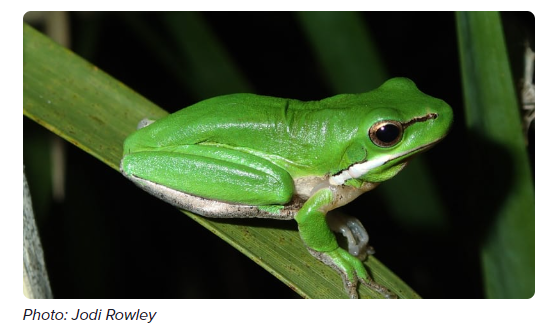

* Distribution: 
Found along most of the east coast and ranges from northern QLD to southern NSW, including some areas further inland. It has also been accidentally transported to Melbourne, VIC, where there are now some breeding populations.[frogid.](https://www.frogid.net.au/frogs/litoria-fallax)
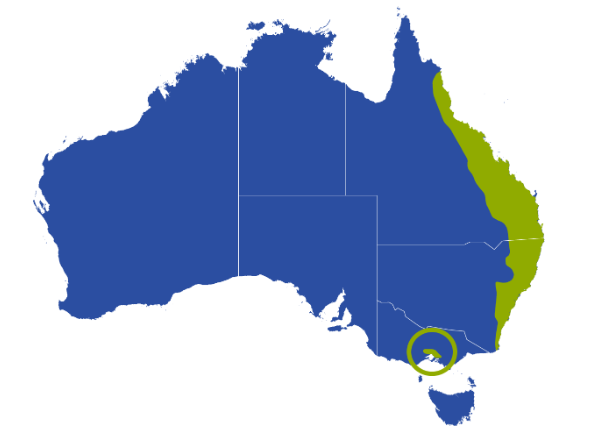


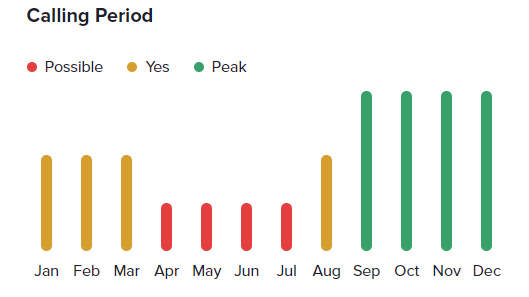

## Spatial and Temporal  sampling

* We used observations of frog species between the years 2015 and 2020 within the Australian territory.
* We used observations of the species Crinia Signifera, Crinia Glauerti, Ranoidea Australis, and Austrochaperina Pluvialis as pseudo absence observations (78207 observations).
* We used a total of 29,224 observations of Littoral Fallax frogs.
We generated 14,215 new observations as pseudo absence across Australia and added them to the dataset.






In [ ]:
# Load in data
min_lon, min_lat = (110, -45)  # Lower-left corner
max_lon, max_lat = (155, -10)  # Upper-right corner
bbox = (min_lon, min_lat, max_lon, max_lat)
# all_frog_data = get_frogs('occurrence.txt', year_range=(1900, 2022), bbox=bbox)
all_frog_data = get_frogs('/content/drive/MyDrive/EY/occurrence.txt', year_range=(2015, 2020), bbox=bbox)

In [ ]:
all_frog_data = all_frog_data[all_frog_data["country"] == "Australia"]

In [ ]:
all_frog_data["eventYear"] = all_frog_data.eventDate.dt.year
all_frog_data["eventMonth"] = all_frog_data.eventDate.dt.month

In [ ]:
all_frog_data

,gbifID,eventDate,country,continent,stateProvince,decimalLatitude,decimalLongitude,species,eventYear,eventMonth
0,2574007008,2020-01-23 01:38:00,Australia,Australia,New South Wales,-32.719457,152.159267,Litoria Fallax,2020,1
7,1944370584,2018-04-18 19:05:00,Australia,Australia,New South Wales,-33.693144,151.320884,Litoria Fallax,2018,4
17,2423011701,2019-08-28 09:24:00,Australia,Australia,New South Wales,-33.925746,151.164082,Litoria Fallax,2019,8
21,2236299662,2018-02-13 23:02:00,Australia,Australia,New South Wales,-31.732415,152.088515,Litoria Fallax,2018,2
23,2563750401,2017-10-25 21:07:00,Australia,Australia,New South Wales,-32.968624,151.644194,Litoria Fallax,2017,10
...,...,...,...,...,...,...,...,...,...,...
193718,3468633397,2020-09-20 00:00:00,Australia,Australia,Victoria,-38.148540,144.361350,Crinia Signifera,2020,9
193719,2420099324,2016-09-17 00:00:00,Australia,Australia,Victoria,-37.845236,144.354168,Crinia Signifera,2016,9
193720,2420099687,2016-05-15 00:00:00,Australia,Australia,Victoria,-38.176213,144.355254,Crinia Signifera,2016,5
193722,3468633550,2020-04-20 00:00:00,Australia,Australia,Victoria,-38.345510,144.153550,Crinia Signifera,2020,4


In [ ]:
all_frog_data.species.value_counts()

Crinia Signifera             67543
Litoria Fallax               28528
Crinia Glauerti               7979
Ranoidea Australis            1518
Austrochaperina Pluvialis      164
Name: species, dtype: int64

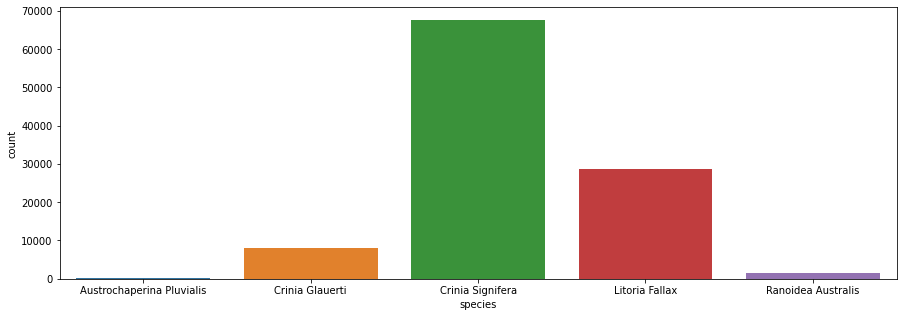

In [ ]:
sum_frogs = all_frog_data.groupby("species").count().reset_index()
sum_frogs = sum_frogs[["species", "gbifID"]]
sum_frogs.columns = ["species", "count"]

fig, ax = plt.subplots(figsize = (15, 5))
sns.barplot(x="species", y="count", data=sum_frogs)

In [ ]:
all_frog_data.eventYear.value_counts()

2020    41844
2019    26770
2018    25689
2017     6757
2016     2460
2015     2212
Name: eventYear, dtype: int64

In [ ]:
target_species = 'Litoria Fallax'

all_frog_data = (
    all_frog_data
    # Assign the occurrenceStatus to 1 for the target species and 0 for all other species.
    # as well as a key for joining (later)
    .assign(
        occurrenceStatus = lambda x: np.where(x.species == target_species, 1, 0)
    )
)


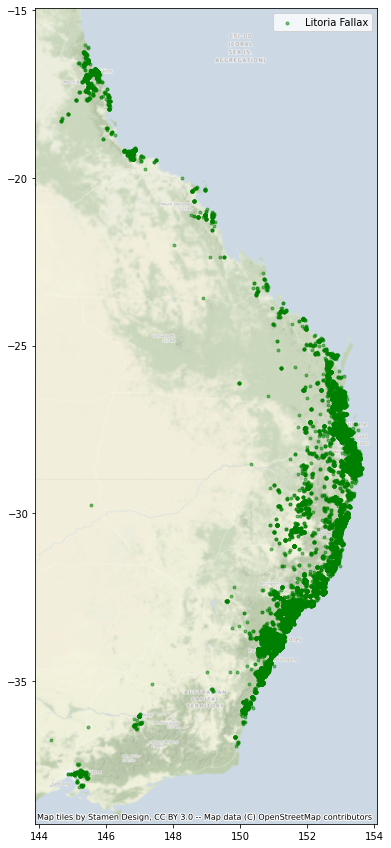

In [ ]:
fig, ax = plt.subplots(figsize = (15, 15))

filt = all_frog_data.occurrenceStatus == 1
ax.scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude,
           color = 'green', marker='.', alpha=0.5, label=target_species)

ax.legend()
cx.add_basemap(ax, crs={'init':'epsg:4326'}, alpha=0.5)

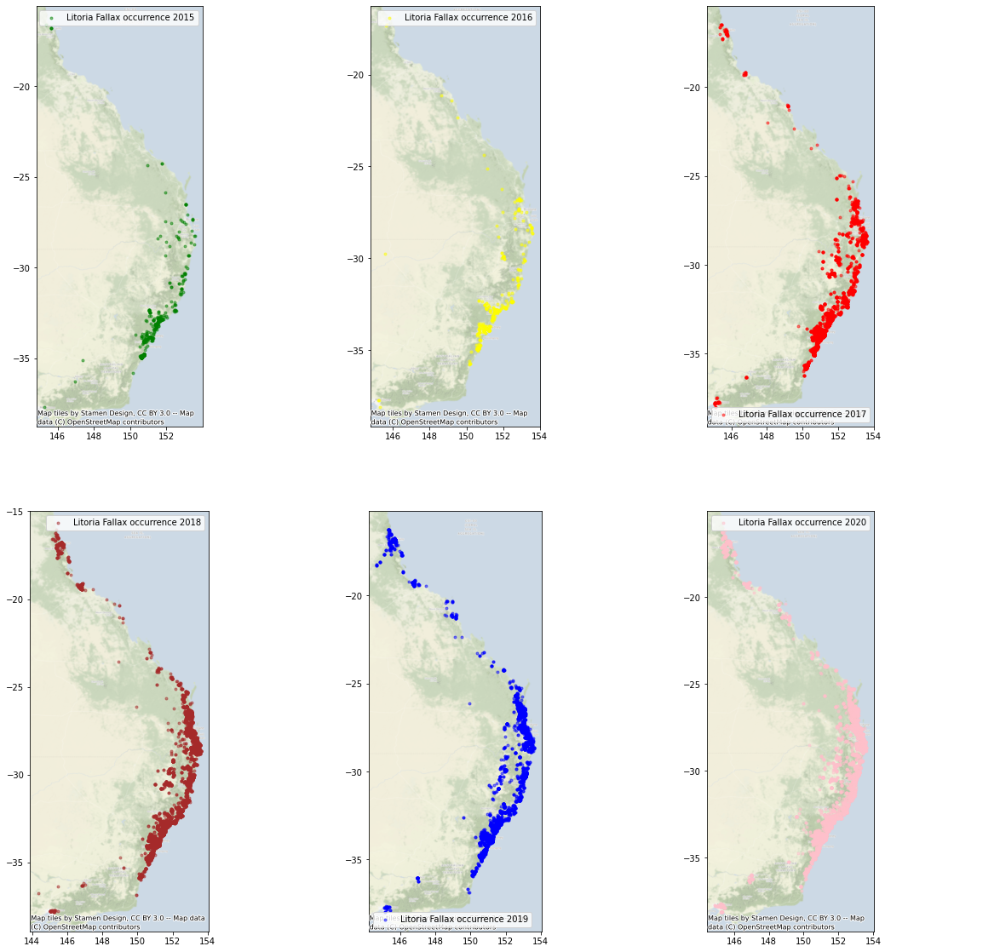

In [ ]:
fig, ax = plt.subplots(2,3, figsize = (20, 20))

filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventYear ==2015)
ax[0,0].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude,
           color = 'green', marker='.', alpha=0.5, label="Litoria Fallax occurrence 2015")
ax[0,0].legend()
cx.add_basemap(ax[0,0], crs={'init':'epsg:4326'}, alpha=0.5)



filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventYear ==2016)
ax[0,1].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude,
           color = 'yellow', marker='.', alpha=0.5, label="Litoria Fallax occurrence 2016")
ax[0,1].legend()
cx.add_basemap(ax[0,1], crs={'init':'epsg:4326'}, alpha=0.5)



filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventYear ==2017)
ax[0,2].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude,
           color = 'red', marker='.', alpha=0.5, label="Litoria Fallax occurrence 2017")
ax[0,2].legend()
cx.add_basemap(ax[0,2], crs={'init':'epsg:4326'}, alpha=0.5)



filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventYear ==2018)
ax[1,0].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude,
           color = 'brown', marker='.', alpha=0.5, label="Litoria Fallax occurrence 2018")
ax[1,0].legend()
cx.add_basemap(ax[1,0], crs={'init':'epsg:4326'}, alpha=0.5)



filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventYear ==2019)
ax[1,1].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude,
           color = 'blue', marker='.', alpha=0.5, label="Litoria Fallax occurrence 2019")
ax[1,1].legend()
cx.add_basemap(ax[1,1], crs={'init':'epsg:4326'}, alpha=0.5)



filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventYear ==2020)
ax[1,2].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude,
           color = 'pink', marker='.', alpha=0.5, label="Litoria Fallax occurrence 2020")
ax[1,2].legend()
cx.add_basemap(ax[1,2], crs={'init':'epsg:4326'}, alpha=0.5)

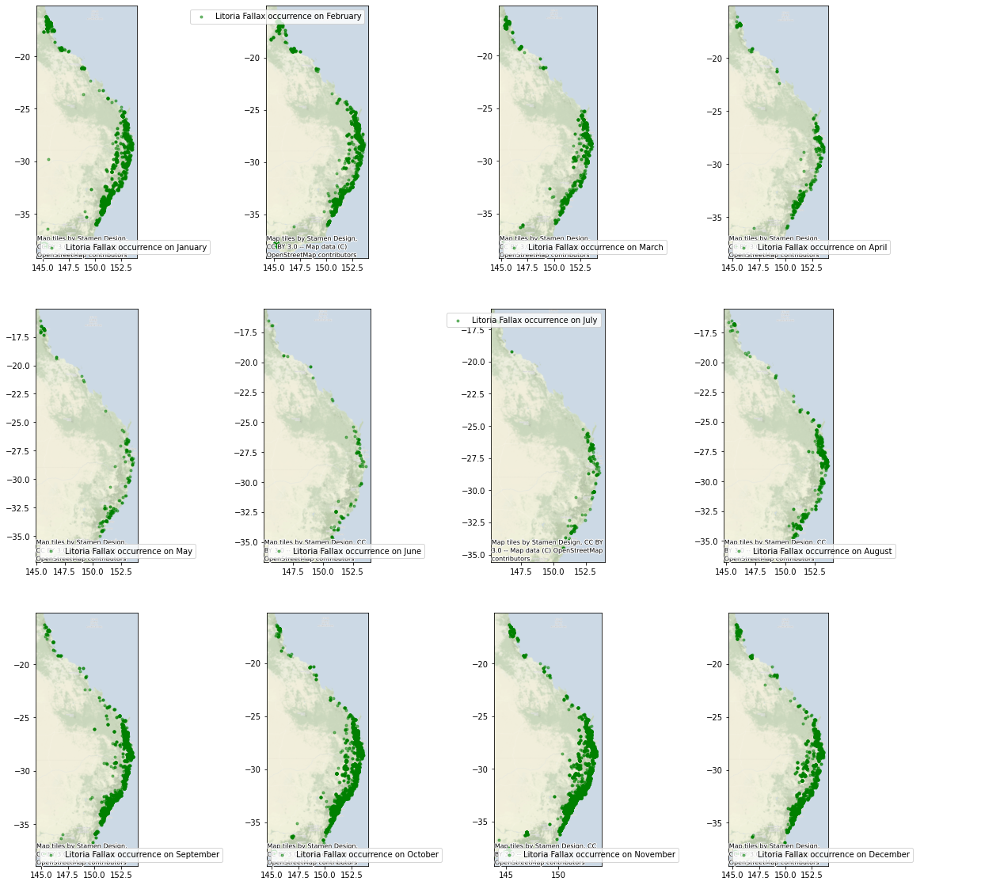

In [ ]:
# January, February, March, April, May, June, July, August, September, October, November, December

fig, ax = plt.subplots(3,4, figsize = (20, 20))

filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==1)
ax[0,0].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude,
           color = 'green', marker='.', alpha=0.5, label="Litoria Fallax occurrence on January")
ax[0,0].legend()
cx.add_basemap(ax[0,0], crs={'init':'epsg:4326'}, alpha=0.5)



filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==2)
ax[0,1].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude,
           color = 'green', marker='.', alpha=0.5, label="Litoria Fallax occurrence on February")
ax[0,1].legend()
cx.add_basemap(ax[0,1], crs={'init':'epsg:4326'}, alpha=0.5)



filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==3)
ax[0,2].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude,
           color = 'green', marker='.', alpha=0.5, label="Litoria Fallax occurrence on March")
ax[0,2].legend()
cx.add_basemap(ax[0,2], crs={'init':'epsg:4326'}, alpha=0.5)



filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==4)
ax[0,3].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude,
           color = 'green', marker='.', alpha=0.5, label="Litoria Fallax occurrence on April")
ax[0,3].legend()
cx.add_basemap(ax[0,3], crs={'init':'epsg:4326'}, alpha=0.5)



filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==5)
ax[1,0].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude,
           color = 'green', marker='.', alpha=0.5, label="Litoria Fallax occurrence on May")
ax[1,0].legend()
cx.add_basemap(ax[1,0], crs={'init':'epsg:4326'}, alpha=0.5)



filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==6)
ax[1,1].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude,
           color = 'green', marker='.', alpha=0.5, label="Litoria Fallax occurrence on June")
ax[1,1].legend()
cx.add_basemap(ax[1,1], crs={'init':'epsg:4326'}, alpha=0.5)



filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==7)
ax[1,2].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude,
           color = 'green', marker='.', alpha=0.5, label="Litoria Fallax occurrence on July")
ax[1,2].legend()
cx.add_basemap(ax[1,2], crs={'init':'epsg:4326'}, alpha=0.5)



filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==8)
ax[1,3].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude,
           color = 'green', marker='.', alpha=0.5, label="Litoria Fallax occurrence on August")
ax[1,3].legend()
cx.add_basemap(ax[1,3], crs={'init':'epsg:4326'}, alpha=0.5)



filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==9)
ax[2,0].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude,
           color = 'green', marker='.', alpha=0.5, label="Litoria Fallax occurrence on September")
ax[2,0].legend()
cx.add_basemap(ax[2,0], crs={'init':'epsg:4326'}, alpha=0.5)



filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==10)
ax[2,1].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude,
           color = 'green', marker='.', alpha=0.5, label="Litoria Fallax occurrence on October")
ax[2,1].legend()
cx.add_basemap(ax[2,1], crs={'init':'epsg:4326'}, alpha=0.5)



filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==11)
ax[2,2].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude,
           color = 'green', marker='.', alpha=0.5, label="Litoria Fallax occurrence on November")
ax[2,2].legend()
cx.add_basemap(ax[2,2], crs={'init':'epsg:4326'}, alpha=0.5)



filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==12)
ax[2,3].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude,
           color = 'green', marker='.', alpha=0.5, label="Litoria Fallax occurrence on December")
ax[2,3].legend()
cx.add_basemap(ax[2,3], crs={'init':'epsg:4326'}, alpha=0.5)

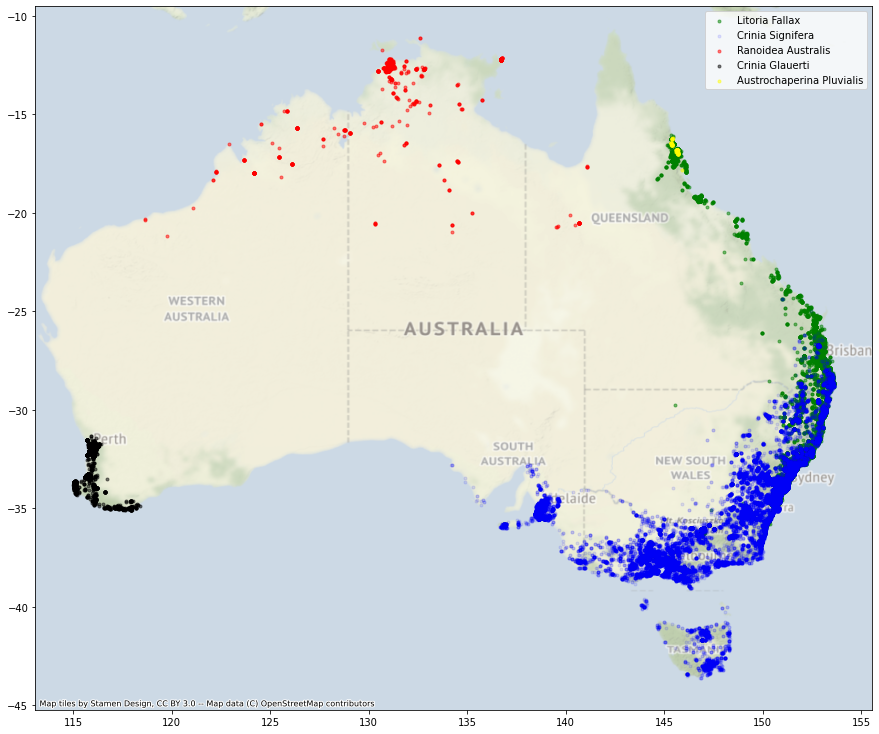

In [ ]:
fig, ax = plt.subplots(figsize = (15, 15))

filt = all_frog_data.occurrenceStatus == 1
ax.scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude,
           color = 'green', marker='.', alpha=0.5, label=target_species)

ax.scatter(all_frog_data[all_frog_data.species =='Crinia Signifera'].decimalLongitude, all_frog_data[all_frog_data.species =='Crinia Signifera'].decimalLatitude,
           color = 'blue', marker='.', alpha=0.1, label='Crinia Signifera')

ax.scatter(all_frog_data[all_frog_data.species == 'Ranoidea Australis'].decimalLongitude, all_frog_data[all_frog_data.species == 'Ranoidea Australis'].decimalLatitude,
           color = 'red', marker='.', alpha=0.5, label= 'Ranoidea Australis')

ax.scatter(all_frog_data[all_frog_data.species == 'Crinia Glauerti'].decimalLongitude, all_frog_data[all_frog_data.species == 'Crinia Glauerti'].decimalLatitude,
           color = 'black', marker='.', alpha=0.5, label= 'Crinia Glauerti')

ax.scatter(all_frog_data[all_frog_data.species == 'Austrochaperina Pluvialis'].decimalLongitude, all_frog_data[all_frog_data.species == 'Austrochaperina Pluvialis'].decimalLatitude,
           color = 'yellow', marker='.', alpha=0.5, label= 'Austrochaperina Pluvialis')

ax.legend()



cx.add_basemap(ax, crs={'init':'epsg:4326'}, alpha=0.5)

* The Crinia Gauteri species shares a large part of the territory with the target specie.

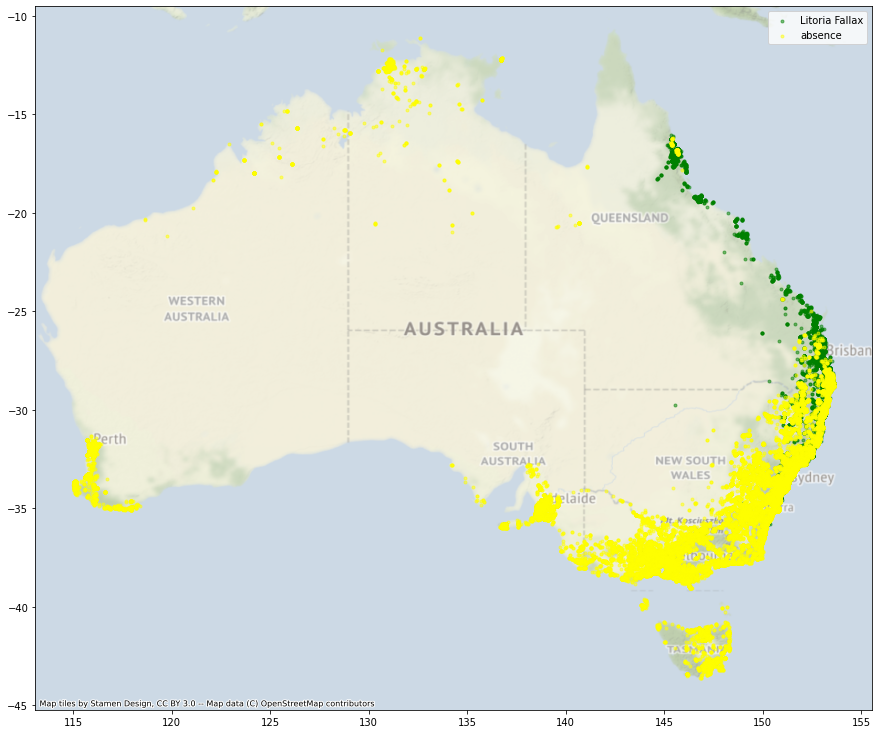

In [ ]:
fig, ax = plt.subplots(figsize = (15, 15))

filt = all_frog_data.occurrenceStatus == 1
ax.scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude,
           color = 'green', marker='.', alpha=0.5, label=target_species)

ax.scatter(all_frog_data[~filt].decimalLongitude, all_frog_data[~filt].decimalLatitude,
           color = 'yellow', marker='.', alpha=0.5, label="absence")

ax.legend()
cx.add_basemap(ax, crs={'init':'epsg:4326'}, alpha=0.5)


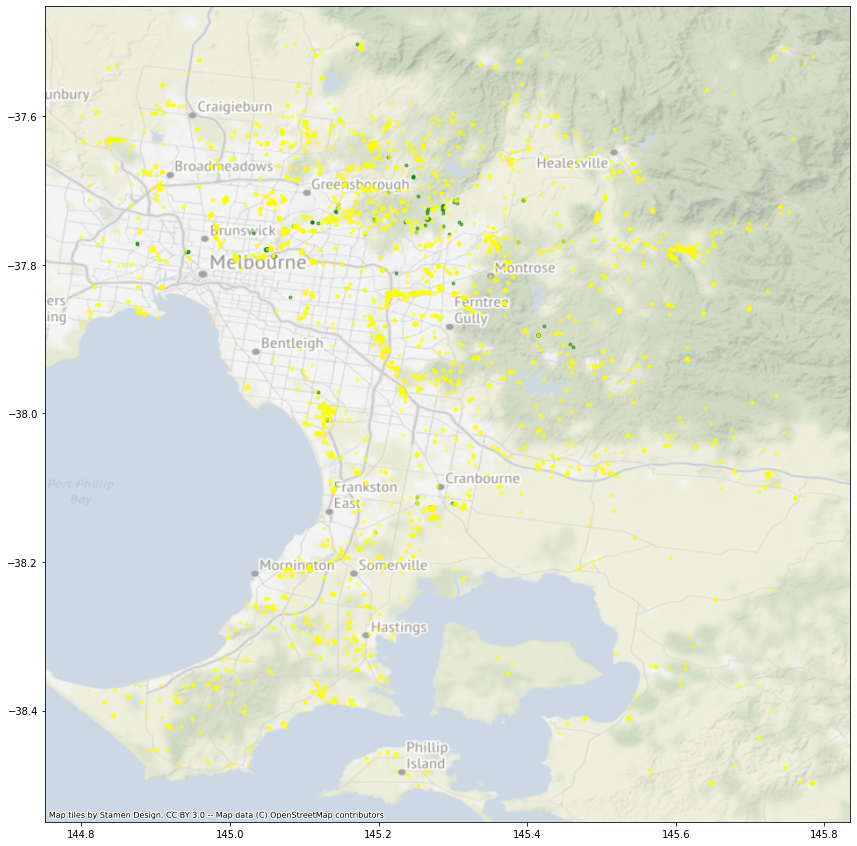

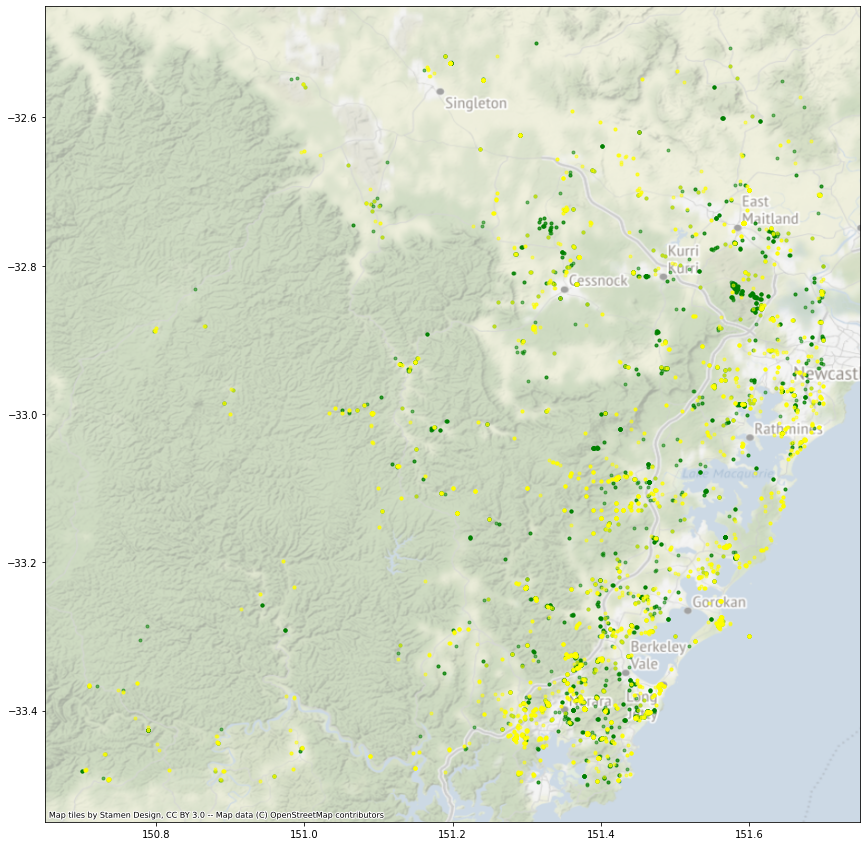

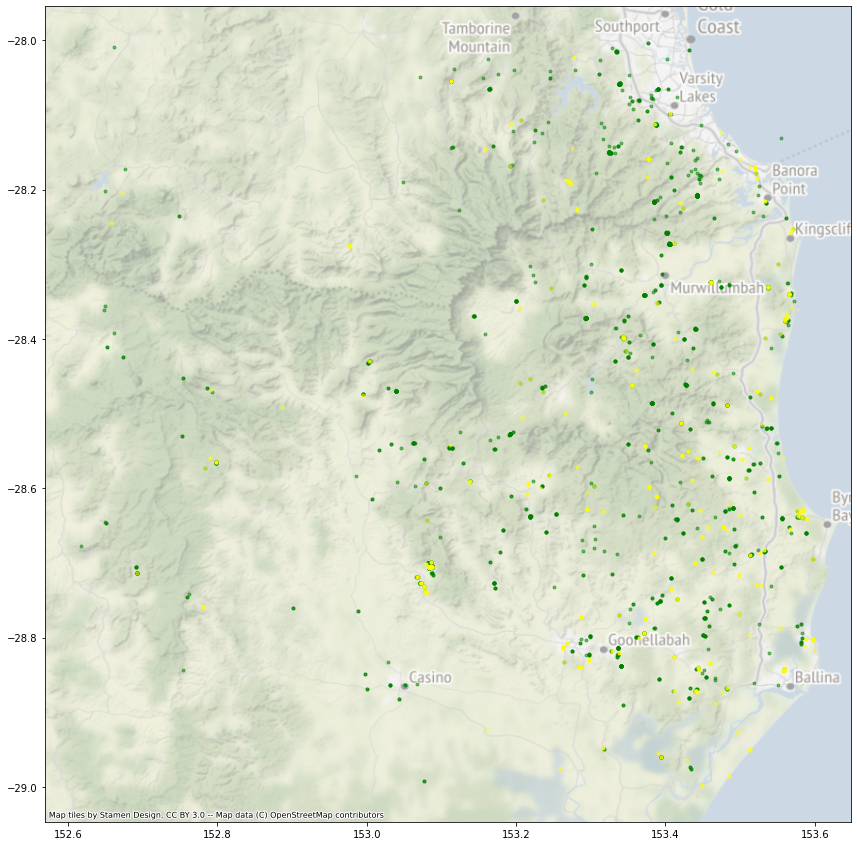

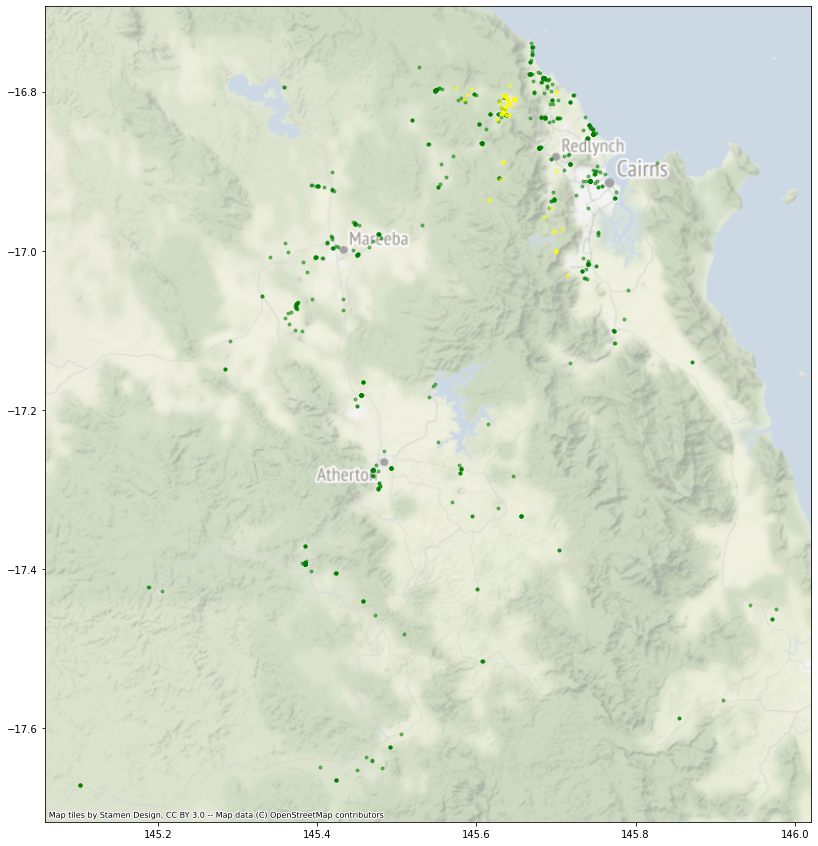

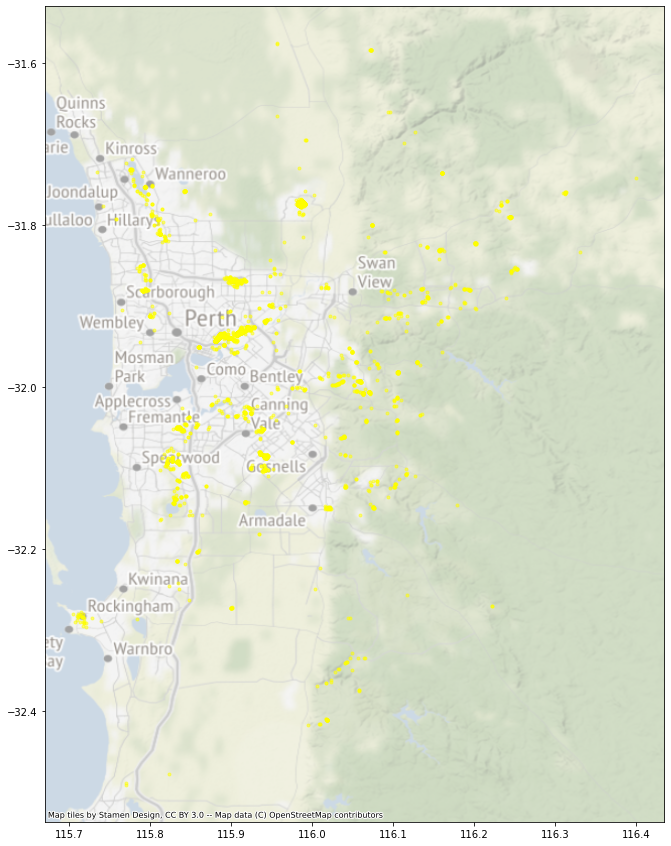

In [ ]:
# Read in test regions
test_1_regions = []
with open('/content/drive/MyDrive/EY/challenge_1_test_regions.txt', 'r') as file: 
    for i, line in enumerate(file):
        if i > 0:
            test_1_regions.append(eval("("+line+")"))

regions = [{'title':i, 'bbox':bbox} for i, bbox in enumerate(test_1_regions)]
for coordenates in regions:

  fig, ax = plt.subplots(figsize = (15, 15))
  filt = all_frog_data.occurrenceStatus == 1

  coord = all_frog_data[(all_frog_data.decimalLongitude >= coordenates["bbox"][0]) & (all_frog_data.decimalLongitude <= coordenates["bbox"][2]) & (all_frog_data.decimalLatitude >= coordenates["bbox"][1]) & (all_frog_data.decimalLatitude <= coordenates["bbox"][3])]

  ax.scatter(coord[filt].decimalLongitude, coord[filt].decimalLatitude,
            color = 'green', marker='.', alpha=0.5, label=target_species)
  ax.scatter(coord[~filt].decimalLongitude, coord[~filt].decimalLatitude,
            color = 'yellow', marker='.', alpha=0.5, label="Absence")
  
  cx.add_basemap(ax, crs={'init':'epsg:4326'}, alpha=0.5)


In [ ]:
species_year = pd.DataFrame( all_frog_data.groupby(["species", "eventYear"]).sum()["eventMonth"] ).reset_index()
species_year.columns = ["species", "year", "count"]
species_year.columns

Index(['species', 'year', 'count'], dtype='object')

<Figure size 1440x1440 with 0 Axes>

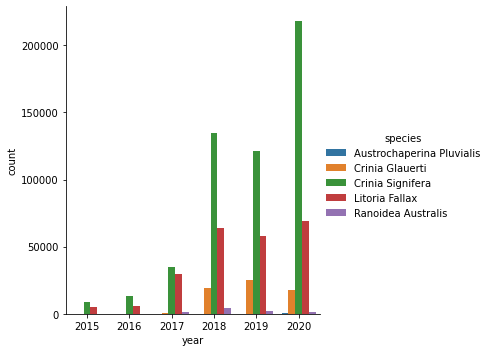

In [ ]:
plt.figure(figsize=(20,20))
ax = sns.catplot(x="year", y="count", hue="species", kind="bar", data=species_year)
plt.show()

* the years with the greatest presence of the Litoria Fallax species were 2017, 2018, 2019 and 2020

In [ ]:
species_month = pd.DataFrame( all_frog_data.groupby(["species", "eventMonth"]).sum()["eventYear"] ).reset_index()
species_month.columns = ["species", "month", "count"]

<Figure size 1440x1440 with 0 Axes>

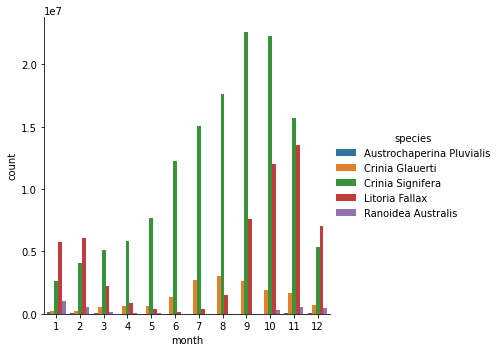

In [ ]:
plt.figure(figsize=(20,20))
ax = sns.catplot(x="month", y="count", hue="species", kind="bar", data=species_month)
plt.show()

<Figure size 1440x1440 with 0 Axes>

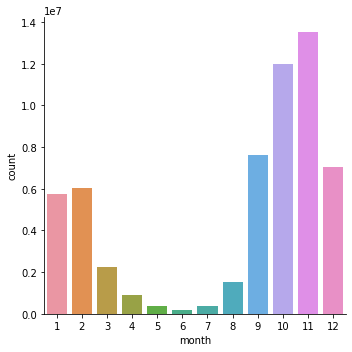

In [ ]:
plt.figure(figsize=(20,20))
ax = sns.catplot(x="month", y="count", kind="bar", data=species_month[species_month.species == 'Litoria Fallax'])
plt.show()

* There is a greater presence of Litorial Fallax in the months of September, October, November and December.

# PREDICTOR DATASET

* We only used climatological information obtained from Microsoft Terraclime between 2015 and 2020 within the Australian territory.
* We selected 13 variables from the original dataset from Microsoft Terraclime.
* We created 17 new variables to try to predict the effect of seasonality.
* We removed all records with missing values.
* We transformed the variables using the yeo-johnson method since it was the one that produced the best result.




In [ ]:
min_lon, min_lat = (110, -45)  # Lower-left corner
max_lon, max_lat = (155, -10)  # Upper-right corner
box = (min_lon, min_lat, max_lon, max_lat)
period = ('2010-01-01','2021-12-31')

In [ ]:
collection = pystac.read_file("https://planetarycomputer.microsoft.com/api/stac/v1/collections/terraclimate")
asset = collection.assets["zarr-https"]
store = fsspec.get_mapper(asset.href)
data = xr.open_zarr(store, **asset.extra_fields["xarray:open_kwargs"])

min_lon, min_lat, max_lon, max_lat = box

clipped_data = data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat),time=slice(period[0], period[1]))
assets=['ppt_station_influence', 'vap_station_influence', 'tmax_station_influence', 'tmin_station_influence', 'ws','pet', 'tmax', 'tmin', 'ppt', 'soil', 'def', 'vap', 'vpd', 'aet', 'srad', 'q', 'pdsi', 'def']
parsed_data = clipped_data[assets]
mean_data = parsed_data.mean(dim="time")
year_data = parsed_data.groupby("time.year").mean("time")
month_data = parsed_data.groupby("time.month").mean("time")

weather_data = get_weather_data(box, ('2019-01-01','2019-12-31'))

## Data Analysis Primary Climate Variables
Now we will look closer at some of this data using plotting and statistics.

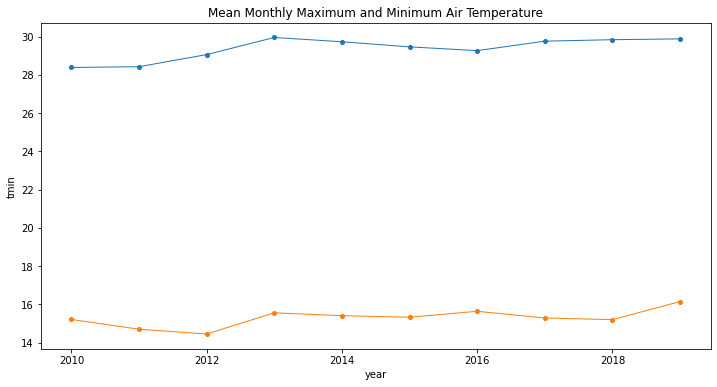

In [ ]:
fig = plt.figure(figsize=(12, 6))
year_data["tmax"].mean(dim=["lat","lon"]).plot(marker='o',markersize=4,linewidth=1)
year_data["tmin"].mean(dim=["lat","lon"]).plot(marker='o',markersize=4,linewidth=1)
plt.title("Mean Monthly Maximum and Minimum Air Temperature")
plt.show()

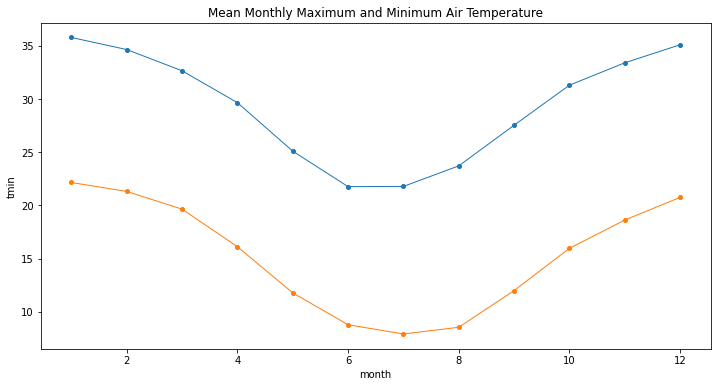

In [ ]:
fig = plt.figure(figsize=(12, 6))
month_data["tmax"].mean(dim=["lat","lon"]).plot(marker='o',markersize=4,linewidth=1)
month_data["tmin"].mean(dim=["lat","lon"]).plot(marker='o',markersize=4,linewidth=1)
plt.title("Mean Monthly Maximum and Minimum Air Temperature")
plt.show()

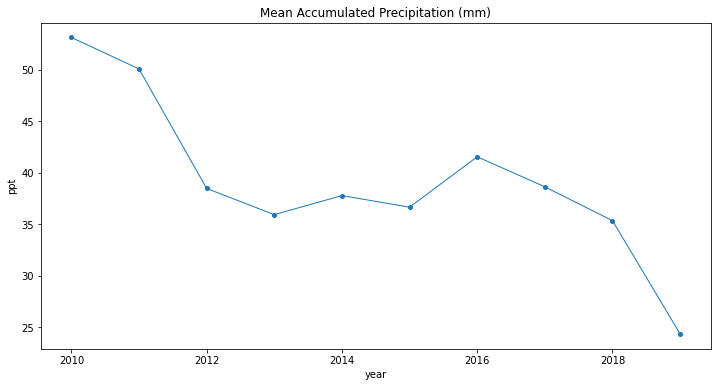

In [ ]:
# Precipitation
precip = (year_data["ppt"]).mean(dim=["lat","lon"])
precip.plot(figsize=(12, 6),marker='o',markersize=4,linewidth=1)
plt.title("Mean Accumulated Precipitation (mm)")
plt.show()

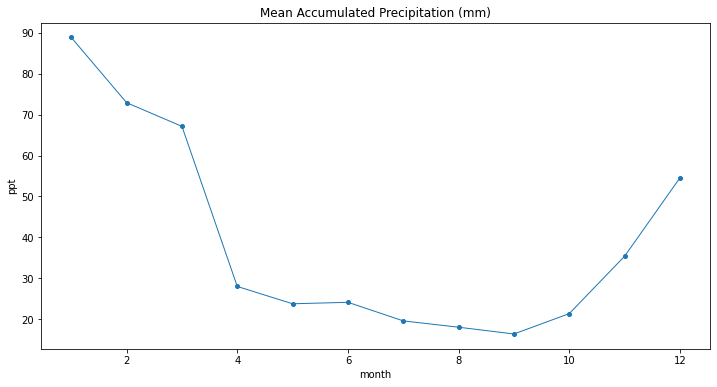

In [ ]:
# Precipitation
precip = (month_data["ppt"]).mean(dim=["lat","lon"])
precip.plot(figsize=(12, 6),marker='o',markersize=4,linewidth=1)
plt.title("Mean Accumulated Precipitation (mm)")
plt.show()

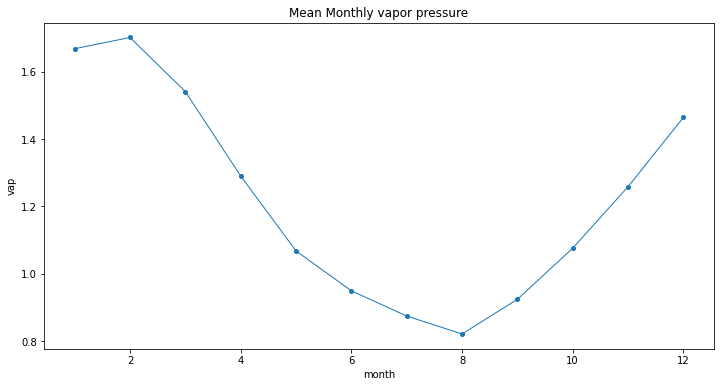

In [ ]:
fig = plt.figure(figsize=(12, 6))
month_data["vap"].mean(dim=["lat","lon"]).plot(marker='o',markersize=4,linewidth=1)
plt.title("Mean Monthly vapor pressure")
plt.show()

## Bio predictors

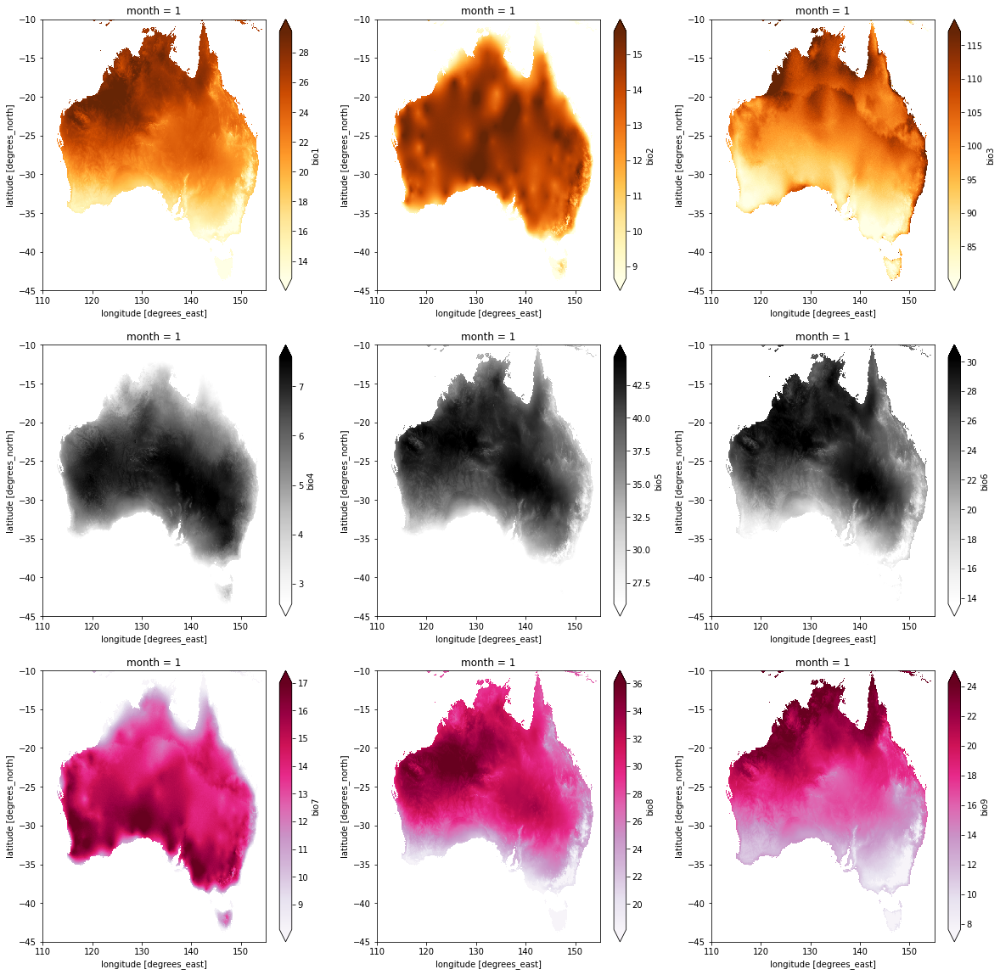

In [ ]:
fig, ax = plt.subplots(3,3, figsize=(20, 20))

xr.plot.imshow(weather_data.bio1, 'lon', 'lat', cmap='YlOrBr', ax=ax[0,0], robust=True)
xr.plot.imshow(weather_data.bio2, 'lon', 'lat', cmap='YlOrBr', ax=ax[0,1], robust=True) 
xr.plot.imshow(weather_data.bio3, 'lon', 'lat', cmap='YlOrBr', ax=ax[0,2], robust=True)

xr.plot.imshow(weather_data.bio4, 'lon', 'lat', cmap='Greys', ax=ax[1,0], robust=True)
xr.plot.imshow(weather_data.bio5, 'lon', 'lat', cmap='Greys', ax=ax[1,1], robust=True) 
xr.plot.imshow(weather_data.bio6, 'lon', 'lat', cmap='Greys', ax=ax[1,2], robust=True) 

xr.plot.imshow(weather_data.bio7, 'lon', 'lat', cmap='PuRd', ax=ax[2,0], robust=True)
xr.plot.imshow(weather_data.bio8, 'lon', 'lat', cmap='PuRd', ax=ax[2,1], robust=True) 
xr.plot.imshow(weather_data.bio9, 'lon', 'lat', cmap='PuRd', ax=ax[2,2], robust=True)



## Def Climatic Water Deficit


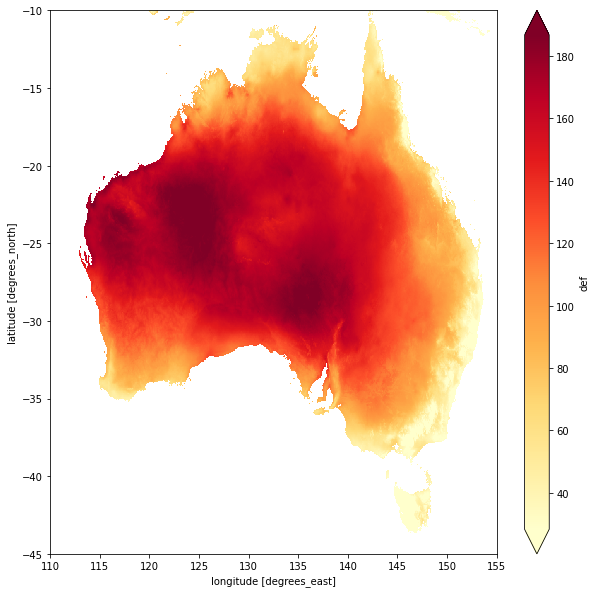

In [ ]:
fig, ax = plt.subplots(figsize=(10, 10))
xr.plot.imshow( mean_data["def"], 'lon', 'lat', cmap='YlOrRd', ax=ax, robust=True) 

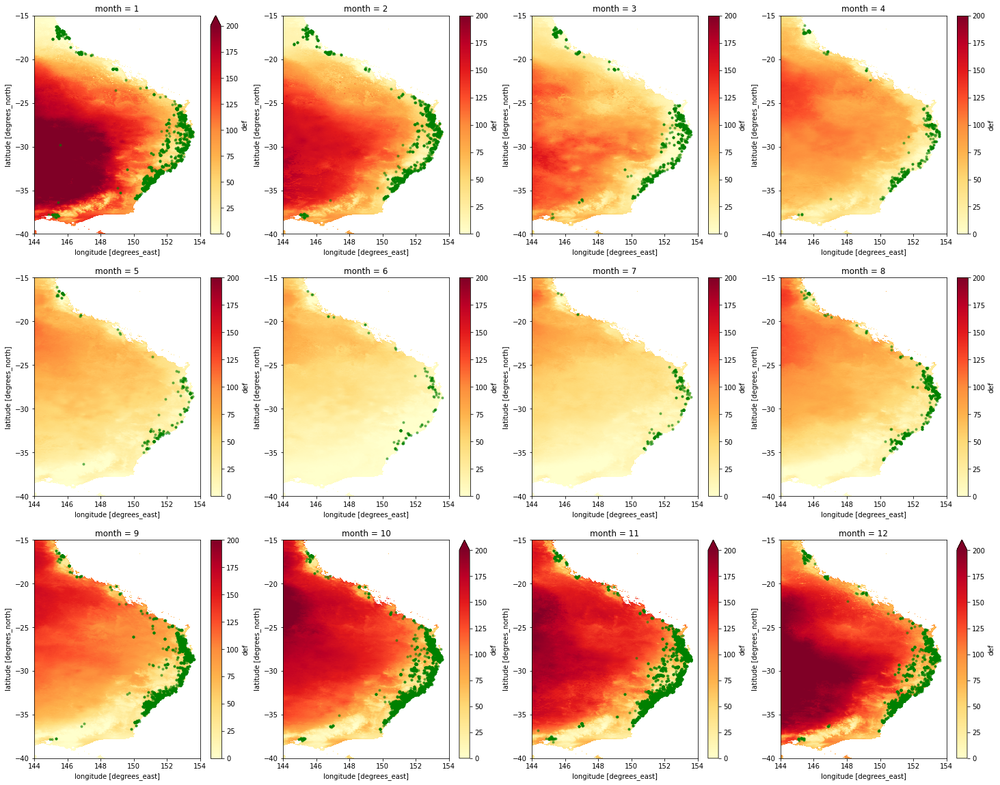

In [ ]:
fig, ax = plt.subplots(3,4, figsize=(25, 20))

min_lon = 144
max_lon = 154
min_lat = -40
max_lat = -15

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=1)["def"], 'lon', 'lat', cmap='YlOrRd', ax=ax[0,0], robust=True, vmin=0, vmax=200)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==1)
ax[0,0].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=2)["def"], 'lon', 'lat', cmap='YlOrRd', ax=ax[0,1], robust=True, vmin=0, vmax=200)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==2)
ax[0,1].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=3)["def"], 'lon', 'lat', cmap='YlOrRd', ax=ax[0,2], robust=True, vmin=0, vmax=200)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==3)
ax[0,2].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=4)["def"], 'lon', 'lat', cmap='YlOrRd', ax=ax[0,3], robust=True, vmin=0, vmax=200)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==4)
ax[0,3].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)



xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=5)["def"], 'lon', 'lat', cmap='YlOrRd', ax=ax[1,0], robust=True, vmin=0, vmax=200)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==5)
ax[1,0].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=6)["def"], 'lon', 'lat', cmap='YlOrRd', ax=ax[1,1], robust=True, vmin=0, vmax=200)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==6)
ax[1,1].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=7)["def"], 'lon', 'lat', cmap='YlOrRd', ax=ax[1,2], robust=True, vmin=0, vmax=200)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==7)
ax[1,2].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=8)["def"], 'lon', 'lat', cmap='YlOrRd', ax=ax[1,3], robust=True, vmin=0, vmax=200)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==8)
ax[1,3].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)



xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=9)["def"], 'lon', 'lat', cmap='YlOrRd', ax=ax[2,0], robust=True, vmin=0, vmax=200)
filt = (all_frog_data.occurrenceStatus ==1) & (all_frog_data.eventMonth ==9)
ax[2,0].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=10)["def"], 'lon', 'lat', cmap='YlOrRd', ax=ax[2,1], robust=True, vmin=0, vmax=200)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==10)
ax[2,1].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=11)["def"], 'lon', 'lat', cmap='YlOrRd', ax=ax[2,2], robust=True, vmin=0, vmax=200)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==11)
ax[2,2].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=12)["def"], 'lon', 'lat', cmap='YlOrRd', ax=ax[2,3], robust=True, vmin=0, vmax=200)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==12)
ax[2,3].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

## Maximum Temperature



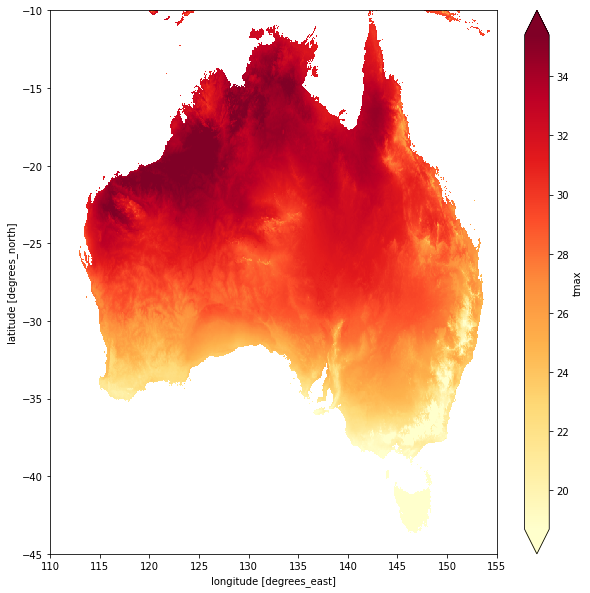

In [ ]:
fig, ax = plt.subplots(figsize=(10, 10))
xr.plot.imshow( mean_data["tmax"], 'lon', 'lat', cmap='YlOrRd', ax=ax, robust=True) 

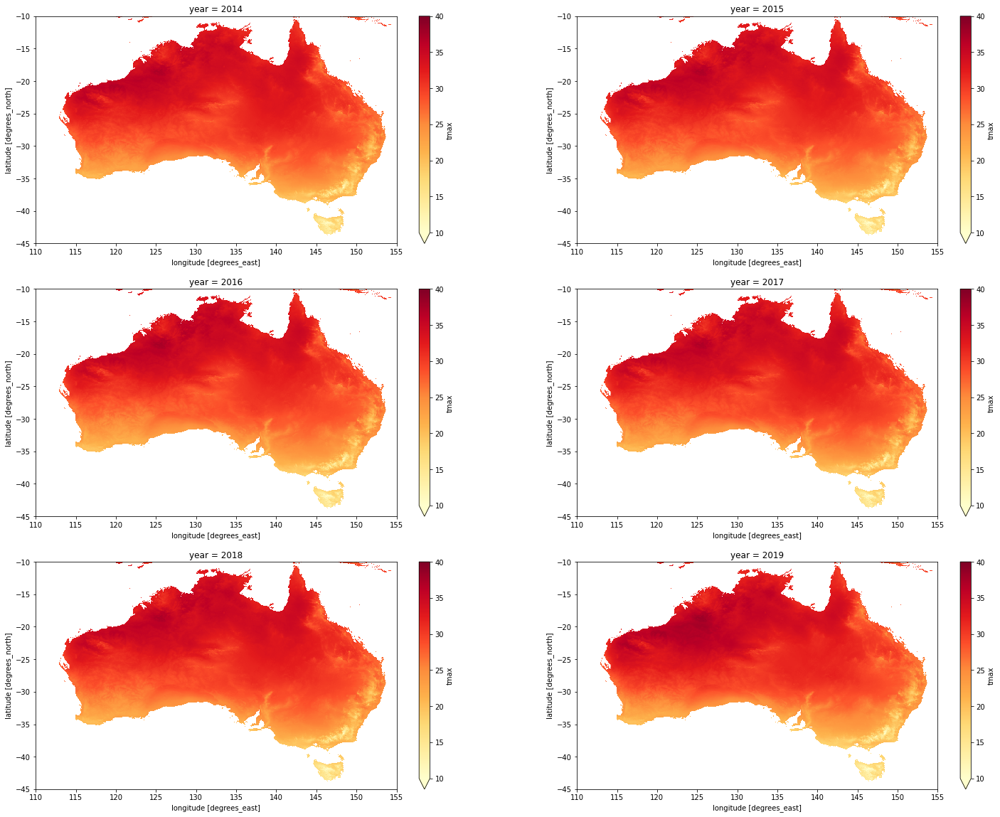

In [ ]:
fig, ax = plt.subplots(3,2, figsize=(25, 20))

xr.plot.imshow(year_data.sel(year=2014)["tmax"], 'lon', 'lat', cmap='YlOrRd', ax=ax[0,0], robust=True, vmin=10, vmax=40)
xr.plot.imshow(year_data.sel(year=2015)["tmax"], 'lon', 'lat', cmap='YlOrRd', ax=ax[0,1], robust=True, vmin=10, vmax=40)

xr.plot.imshow(year_data.sel(year=2016)["tmax"], 'lon', 'lat', cmap='YlOrRd', ax=ax[1,0], robust=True, vmin=10, vmax=40)
xr.plot.imshow(year_data.sel(year=2017)["tmax"], 'lon', 'lat', cmap='YlOrRd', ax=ax[1,1], robust=True, vmin=10, vmax=40)

xr.plot.imshow(year_data.sel(year=2018)["tmax"], 'lon', 'lat', cmap='YlOrRd', ax=ax[2,0], robust=True, vmin=10, vmax=40)
xr.plot.imshow(year_data.sel(year=2019)["tmax"], 'lon', 'lat', cmap='YlOrRd', ax=ax[2,1], robust=True, vmin=10, vmax=40)


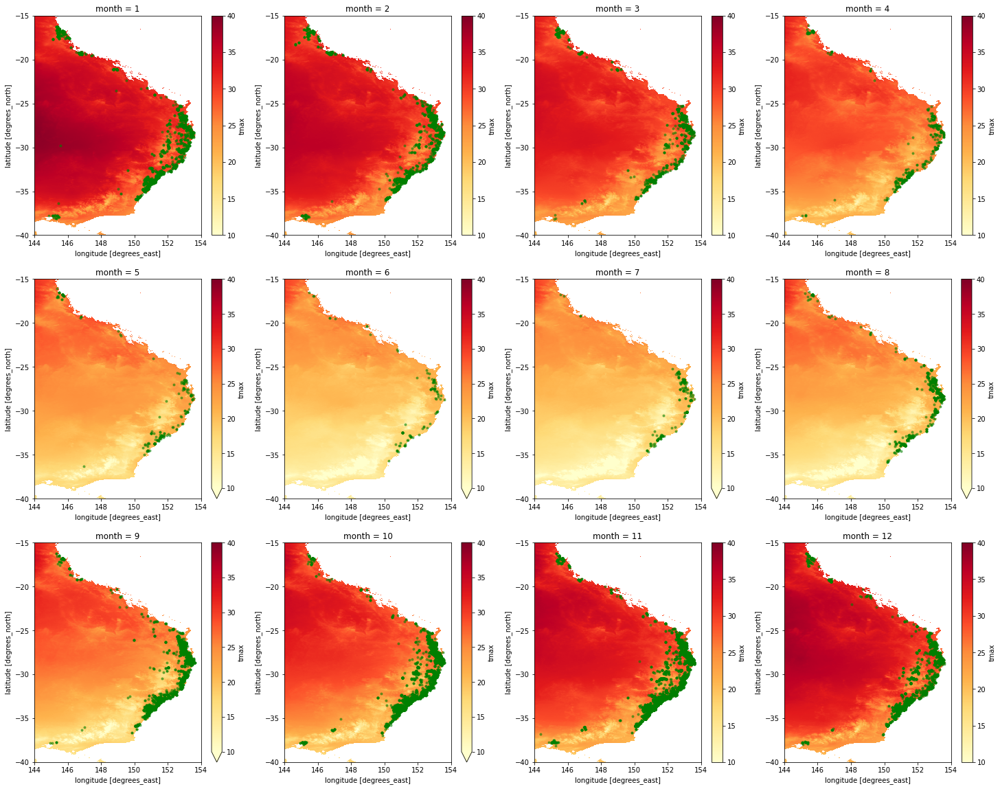

In [ ]:
fig, ax = plt.subplots(3,4, figsize=(25, 20))

min_lon = 144
max_lon = 154
min_lat = -40
max_lat = -15

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=1)["tmax"], 'lon', 'lat', cmap='YlOrRd', ax=ax[0,0], robust=True, vmin=10, vmax=40)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==1)
ax[0,0].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=2)["tmax"], 'lon', 'lat', cmap='YlOrRd', ax=ax[0,1], robust=True, vmin=10, vmax=40)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==2)
ax[0,1].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=3)["tmax"], 'lon', 'lat', cmap='YlOrRd', ax=ax[0,2], robust=True, vmin=10, vmax=40)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==3)
ax[0,2].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=4)["tmax"], 'lon', 'lat', cmap='YlOrRd', ax=ax[0,3], robust=True, vmin=10, vmax=40)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==4)
ax[0,3].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)



xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=5)["tmax"], 'lon', 'lat', cmap='YlOrRd', ax=ax[1,0], robust=True, vmin=10, vmax=40)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==5)
ax[1,0].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=6)["tmax"], 'lon', 'lat', cmap='YlOrRd', ax=ax[1,1], robust=True, vmin=10, vmax=40)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==6)
ax[1,1].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=7)["tmax"], 'lon', 'lat', cmap='YlOrRd', ax=ax[1,2], robust=True, vmin=10, vmax=40)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==7)
ax[1,2].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=8)["tmax"], 'lon', 'lat', cmap='YlOrRd', ax=ax[1,3], robust=True, vmin=10, vmax=40)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==8)
ax[1,3].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)



xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=9)["tmax"], 'lon', 'lat', cmap='YlOrRd', ax=ax[2,0], robust=True, vmin=10, vmax=40)
filt = (all_frog_data.occurrenceStatus ==1) & (all_frog_data.eventMonth ==9)
ax[2,0].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=10)["tmax"], 'lon', 'lat', cmap='YlOrRd', ax=ax[2,1], robust=True, vmin=10, vmax=40)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==10)
ax[2,1].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=11)["tmax"], 'lon', 'lat', cmap='YlOrRd', ax=ax[2,2], robust=True, vmin=10, vmax=40)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==11)
ax[2,2].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=12)["tmax"], 'lon', 'lat', cmap='YlOrRd', ax=ax[2,3], robust=True, vmin=10, vmax=40)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==12)
ax[2,3].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

## Minimum Temperature


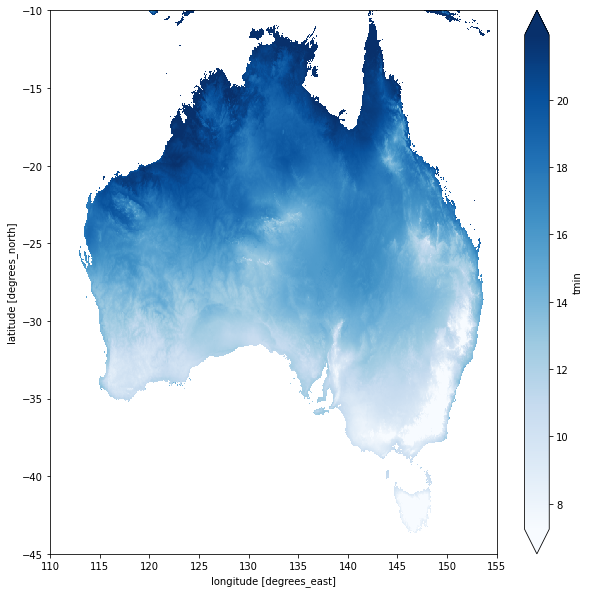

In [ ]:
fig, ax = plt.subplots(figsize=(10, 10))
xr.plot.imshow( mean_data["tmin"], 'lon', 'lat', cmap='Blues', ax=ax, robust=True) 

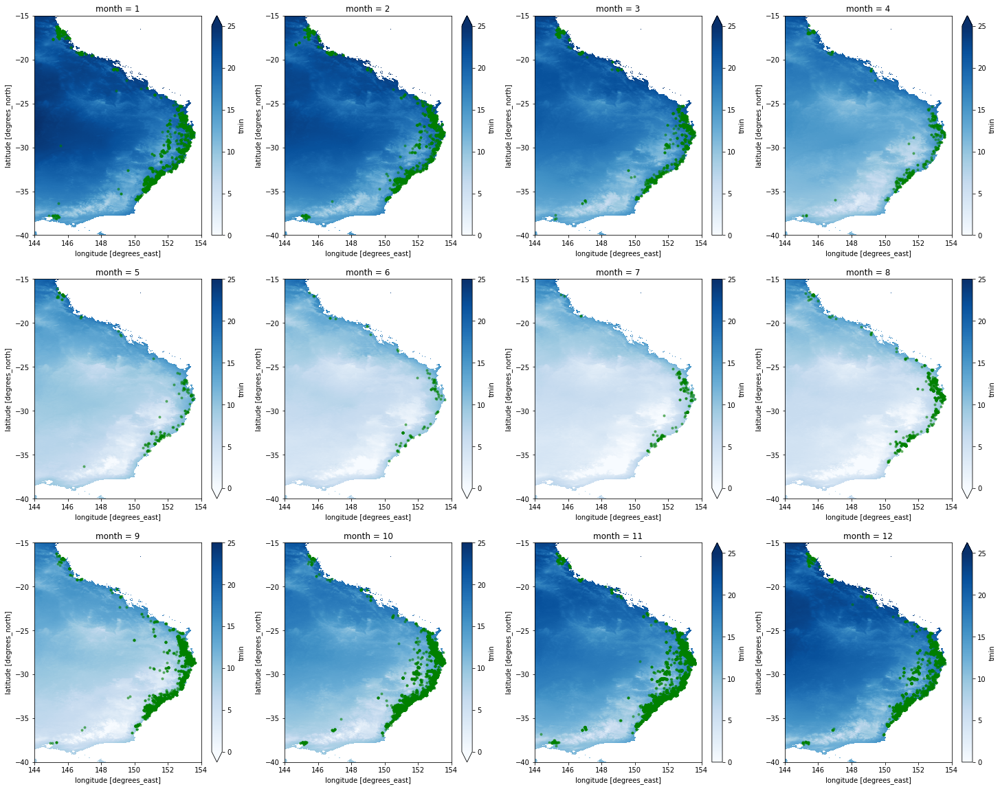

In [ ]:
fig, ax = plt.subplots(3,4, figsize=(25, 20))

min_lon = 144
max_lon = 154
min_lat = -40
max_lat = -15

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=1)["tmin"], 'lon', 'lat', cmap='Blues', ax=ax[0,0], robust=True, vmin=0, vmax=25)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==1)
ax[0,0].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=2)["tmin"], 'lon', 'lat', cmap='Blues', ax=ax[0,1], robust=True, vmin=0, vmax=25)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==2)
ax[0,1].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=3)["tmin"], 'lon', 'lat', cmap='Blues', ax=ax[0,2], robust=True, vmin=0, vmax=25)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==3)
ax[0,2].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=4)["tmin"], 'lon', 'lat', cmap='Blues', ax=ax[0,3], robust=True, vmin=0, vmax=25)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==4)
ax[0,3].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)



xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=5)["tmin"], 'lon', 'lat', cmap='Blues', ax=ax[1,0], robust=True, vmin=0, vmax=25)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==5)
ax[1,0].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=6)["tmin"], 'lon', 'lat', cmap='Blues', ax=ax[1,1], robust=True, vmin=0, vmax=25)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==6)
ax[1,1].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=7)["tmin"], 'lon', 'lat', cmap='Blues', ax=ax[1,2], robust=True, vmin=0, vmax=25)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==7)
ax[1,2].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=8)["tmin"], 'lon', 'lat', cmap='Blues', ax=ax[1,3], robust=True, vmin=0, vmax=25)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==8)
ax[1,3].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)



xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=9)["tmin"], 'lon', 'lat', cmap='Blues', ax=ax[2,0], robust=True, vmin=0, vmax=25)
filt = (all_frog_data.occurrenceStatus ==1) & (all_frog_data.eventMonth ==9)
ax[2,0].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=10)["tmin"], 'lon', 'lat', cmap='Blues', ax=ax[2,1], robust=True, vmin=0, vmax=25)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==10)
ax[2,1].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=11)["tmin"], 'lon', 'lat', cmap='Blues', ax=ax[2,2], robust=True, vmin=0, vmax=25)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==11)
ax[2,2].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=12)["tmin"], 'lon', 'lat', cmap='Blues', ax=ax[2,3], robust=True, vmin=0, vmax=25)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==12)
ax[2,3].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

## Precipitation

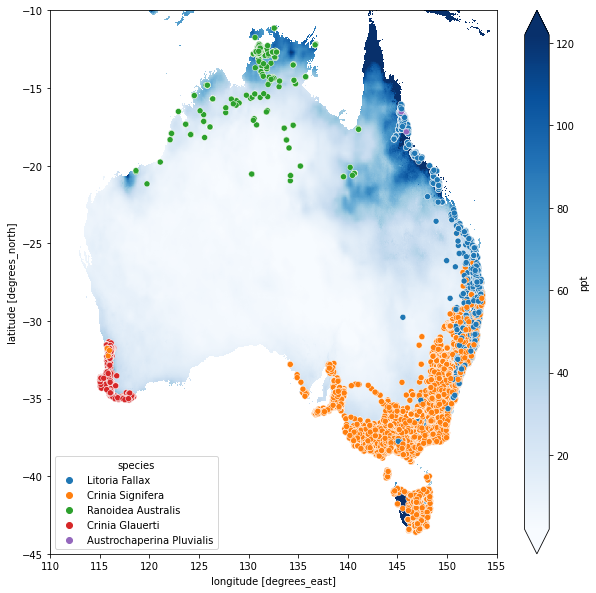

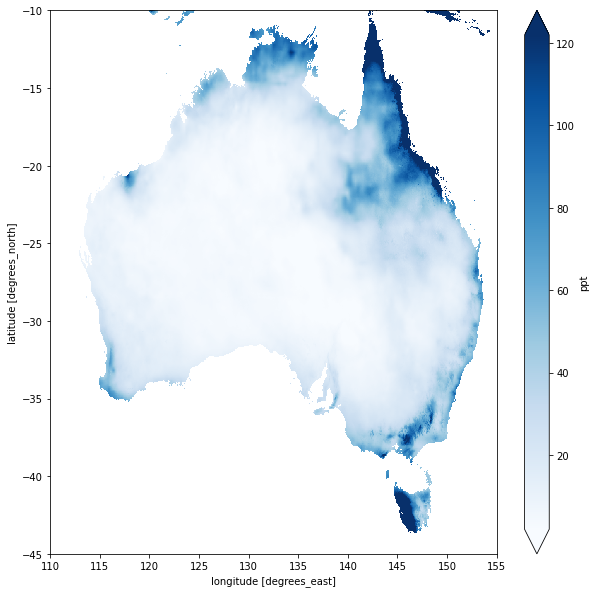

In [ ]:
fig, ax = plt.subplots(figsize=(10, 10))
xr.plot.imshow( parsed_data.ppt.mean(dim=["time"]), 'lon', 'lat', cmap='Blues', ax=ax, robust=True) 
sns.scatterplot(data=all_frog_data, x="decimalLongitude" , y="decimalLatitude", hue="species", ax=ax)

fig, ax = plt.subplots(figsize=(10, 10))
xr.plot.imshow( parsed_data.ppt.mean(dim=["time"]), 'lon', 'lat', cmap='Blues', ax=ax, robust=True) 

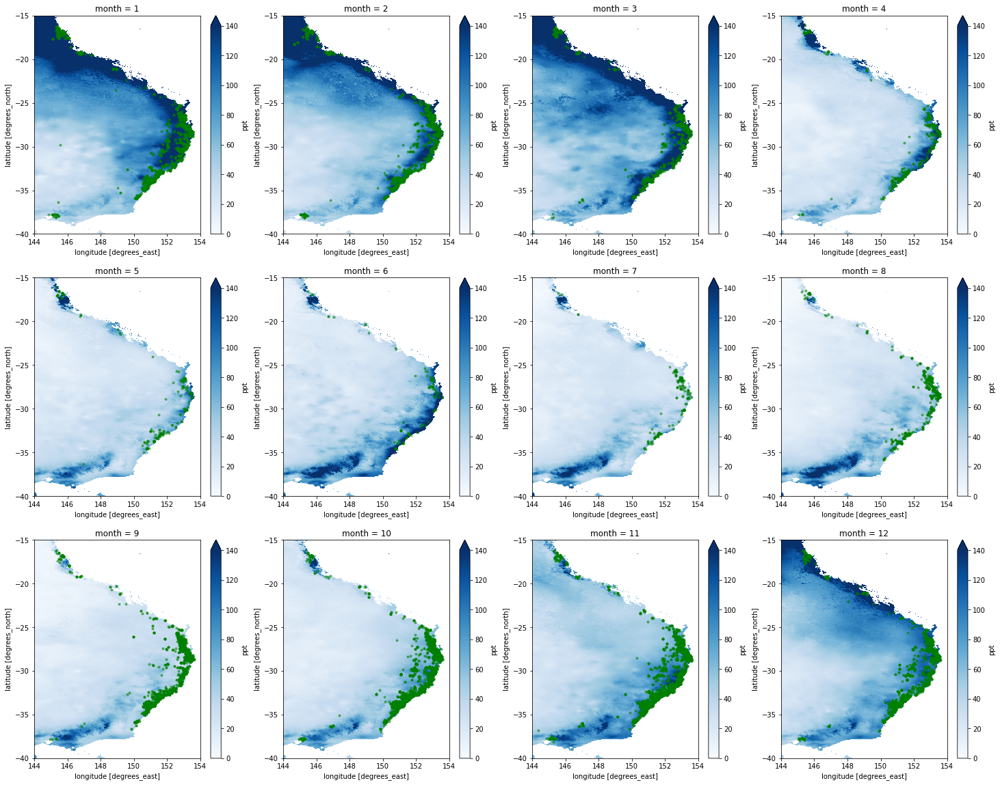

In [ ]:
fig, ax = plt.subplots(3,4, figsize=(25, 20))

min_lon = 144
max_lon = 154
min_lat = -40
max_lat = -15

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=1)["ppt"], 'lon', 'lat', cmap='Blues', ax=ax[0,0], robust=True, vmin=0, vmax=140)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==1)
ax[0,0].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=2)["ppt"], 'lon', 'lat', cmap='Blues', ax=ax[0,1], robust=True, vmin=0, vmax=140)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==2)
ax[0,1].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=3)["ppt"], 'lon', 'lat', cmap='Blues', ax=ax[0,2], robust=True, vmin=0, vmax=140)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==3)
ax[0,2].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=4)["ppt"], 'lon', 'lat', cmap='Blues', ax=ax[0,3], robust=True, vmin=0, vmax=140)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==4)
ax[0,3].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)



xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=5)["ppt"], 'lon', 'lat', cmap='Blues', ax=ax[1,0], robust=True, vmin=0, vmax=140)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==5)
ax[1,0].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=6)["ppt"], 'lon', 'lat', cmap='Blues', ax=ax[1,1], robust=True, vmin=0, vmax=140)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==6)
ax[1,1].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=7)["ppt"], 'lon', 'lat', cmap='Blues', ax=ax[1,2], robust=True, vmin=0, vmax=140)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==7)
ax[1,2].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=8)["ppt"], 'lon', 'lat', cmap='Blues', ax=ax[1,3], robust=True, vmin=0, vmax=140)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==8)
ax[1,3].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)



xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=9)["ppt"], 'lon', 'lat', cmap='Blues', ax=ax[2,0], robust=True, vmin=0, vmax=140)
filt = (all_frog_data.occurrenceStatus ==1) & (all_frog_data.eventMonth ==9)
ax[2,0].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=10)["ppt"], 'lon', 'lat', cmap='Blues', ax=ax[2,1], robust=True, vmin=0, vmax=140)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==10)
ax[2,1].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=11)["ppt"], 'lon', 'lat', cmap='Blues', ax=ax[2,2], robust=True, vmin=0, vmax=140)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==11)
ax[2,2].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=12)["ppt"], 'lon', 'lat', cmap='Blues', ax=ax[2,3], robust=True, vmin=0, vmax=140)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==12)
ax[2,3].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

## Vaporization

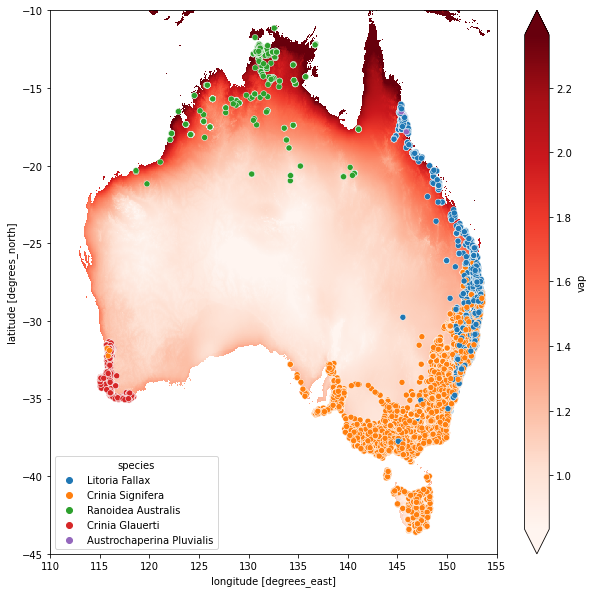

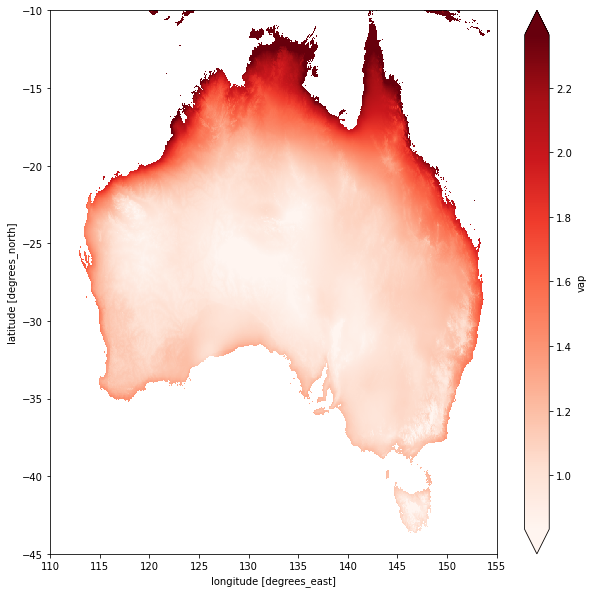

In [ ]:
fig, ax = plt.subplots(figsize=(10, 10))
xr.plot.imshow( parsed_data.vap.mean(dim=["time"]), 'lon', 'lat', cmap='Reds', ax=ax, robust=True) 
sns.scatterplot(data=all_frog_data, x="decimalLongitude" , y="decimalLatitude", hue="species", ax=ax)

fig, ax = plt.subplots(figsize=(10, 10))
xr.plot.imshow( parsed_data.vap.mean(dim=["time"]), 'lon', 'lat', cmap='Reds', ax=ax, robust=True) 

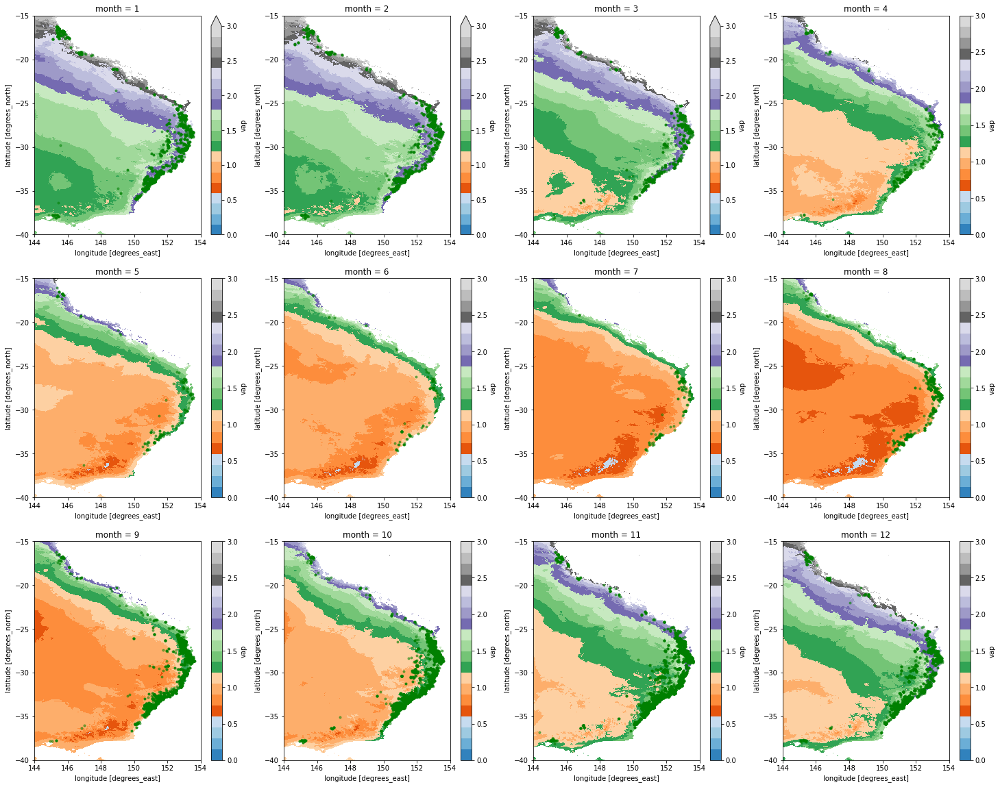

In [ ]:
fig, ax = plt.subplots(3,4, figsize=(25, 20))

min_lon = 144
max_lon = 154
min_lat = -40
max_lat = -15

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=1)["vap"], 'lon', 'lat', cmap='tab20c', ax=ax[0,0], robust=True, vmin=0, vmax=3)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==1)
ax[0,0].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=2)["vap"], 'lon', 'lat', cmap='tab20c', ax=ax[0,1], robust=True, vmin=0, vmax=3)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==2)
ax[0,1].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=3)["vap"], 'lon', 'lat', cmap='tab20c', ax=ax[0,2], robust=True, vmin=0, vmax=3)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==3)
ax[0,2].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=4)["vap"], 'lon', 'lat', cmap='tab20c', ax=ax[0,3], robust=True, vmin=0, vmax=3)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==4)
ax[0,3].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)



xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=5)["vap"], 'lon', 'lat', cmap='tab20c', ax=ax[1,0], robust=True, vmin=0, vmax=3)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==5)
ax[1,0].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=6)["vap"], 'lon', 'lat', cmap='tab20c', ax=ax[1,1], robust=True, vmin=0, vmax=3)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==6)
ax[1,1].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=7)["vap"], 'lon', 'lat', cmap='tab20c', ax=ax[1,2], robust=True, vmin=0, vmax=3)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==7)
ax[1,2].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=8)["vap"], 'lon', 'lat', cmap='tab20c', ax=ax[1,3], robust=True, vmin=0, vmax=3)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==8)
ax[1,3].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)



xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=9)["vap"], 'lon', 'lat', cmap='tab20c', ax=ax[2,0], robust=True, vmin=0, vmax=3)
filt = (all_frog_data.occurrenceStatus ==1) & (all_frog_data.eventMonth ==9)
ax[2,0].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=10)["vap"], 'lon', 'lat', cmap='tab20c', ax=ax[2,1], robust=True, vmin=0, vmax=3)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==10)
ax[2,1].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=11)["vap"], 'lon', 'lat', cmap='tab20c', ax=ax[2,2], robust=True, vmin=0, vmax=3)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==11)
ax[2,2].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

xr.plot.imshow(month_data.sel(lon=slice(min_lon,max_lon),lat=slice(max_lat,min_lat), month=12)["vap"], 'lon', 'lat', cmap='tab20c', ax=ax[2,3], robust=True, vmin=0, vmax=3)
filt = (all_frog_data.occurrenceStatus == 1) & (all_frog_data.eventMonth ==12)
ax[2,3].scatter(all_frog_data[filt].decimalLongitude, all_frog_data[filt].decimalLatitude, color = 'green', marker='.', alpha=0.5)

## Downward Shortwave Radiation Flux at the Surface

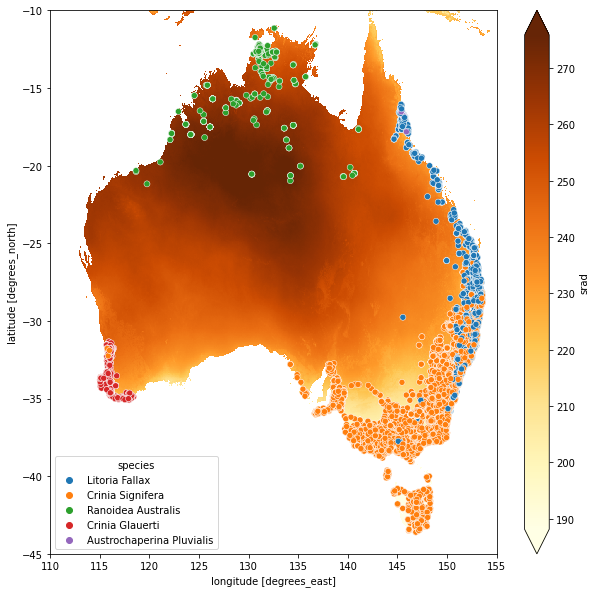

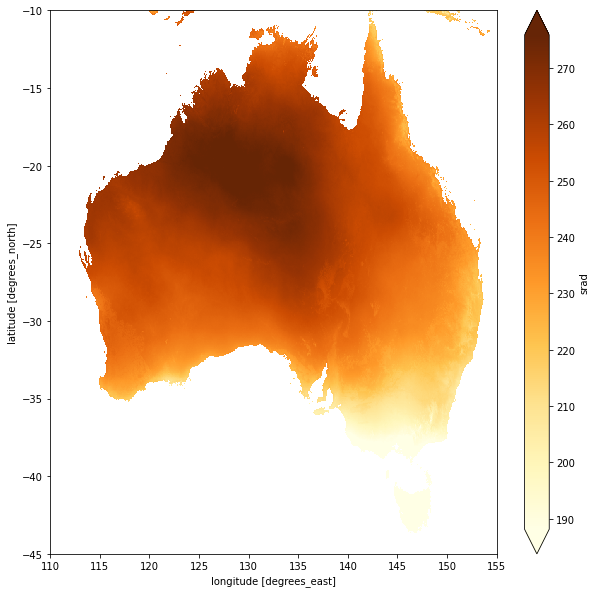

In [ ]:
fig, ax = plt.subplots(figsize=(10, 10))
xr.plot.imshow( parsed_data.srad.mean(dim=["time"]), 'lon', 'lat', cmap='YlOrBr', ax=ax, robust=True) 
sns.scatterplot(data=all_frog_data, x="decimalLongitude" , y="decimalLatitude", hue="species", ax=ax)

fig, ax = plt.subplots(figsize=(10, 10))
xr.plot.imshow( parsed_data.srad.mean(dim=["time"]), 'lon', 'lat', cmap='YlOrBr', ax=ax, robust=True) 


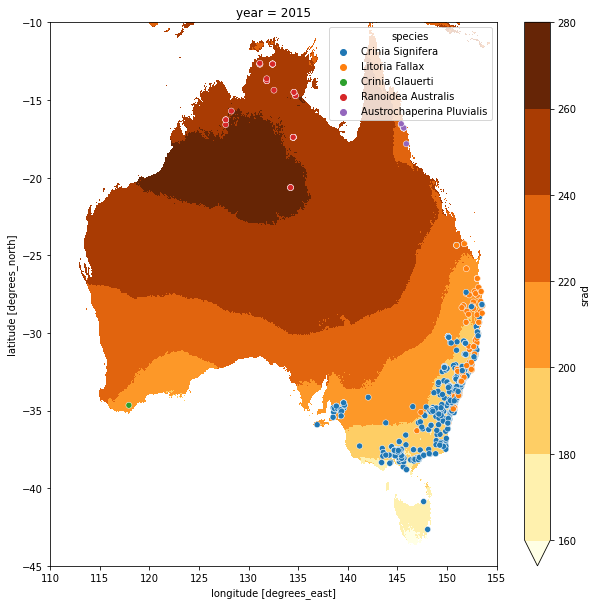

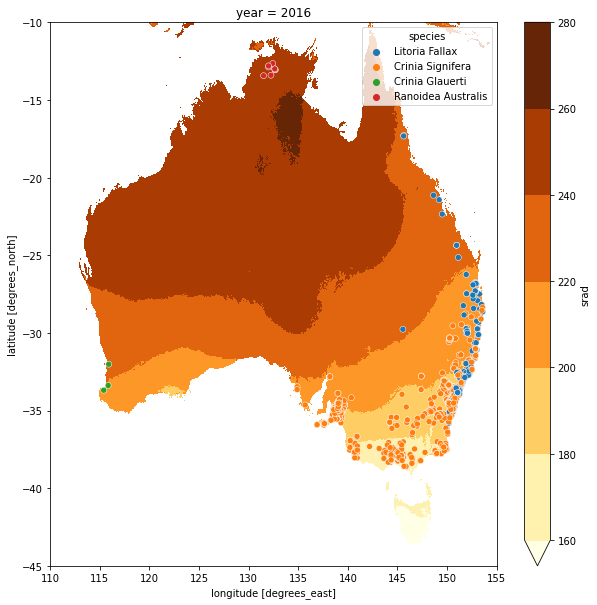

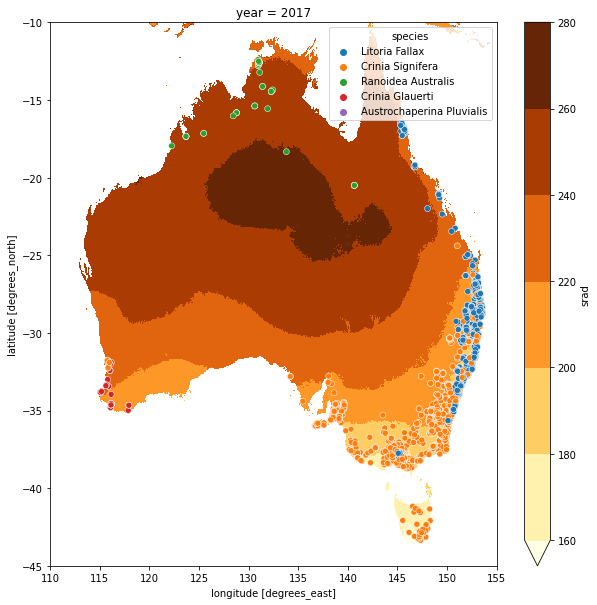

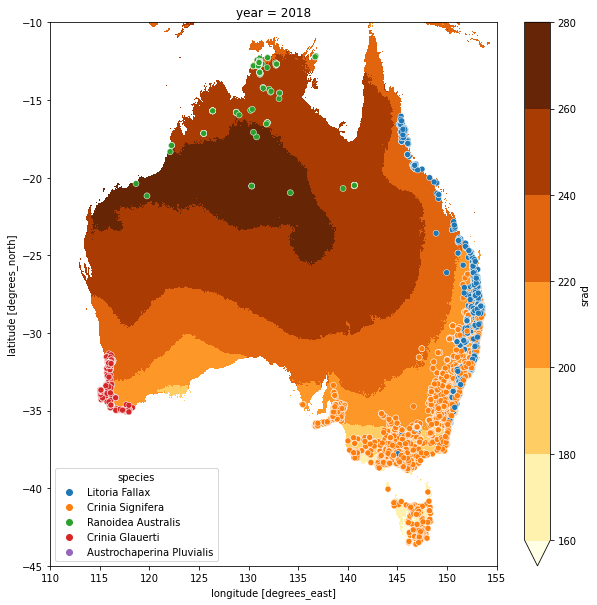

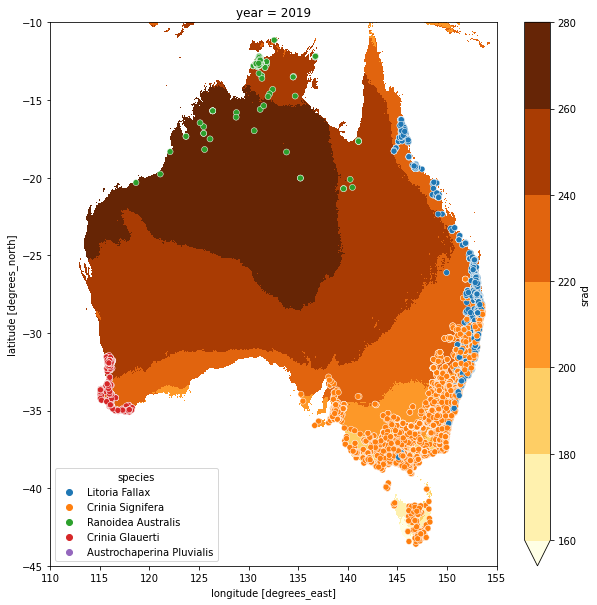

In [ ]:
for year in [2015,2016,2017,2018,2019]:
  fig, ax = plt.subplots(figsize=(10, 10))
  plt.title(year)
  xr.plot.imshow(year_data["srad"].sel(year=year), 'lon', 'lat', cmap='YlOrBr', ax=ax, robust=True, levels=[160,180,200,220,240,260,280]) 
  sns.scatterplot(data=all_frog_data[(all_frog_data["eventYear"]==year)], x="decimalLongitude" , y="decimalLatitude", hue="species", ax=ax)


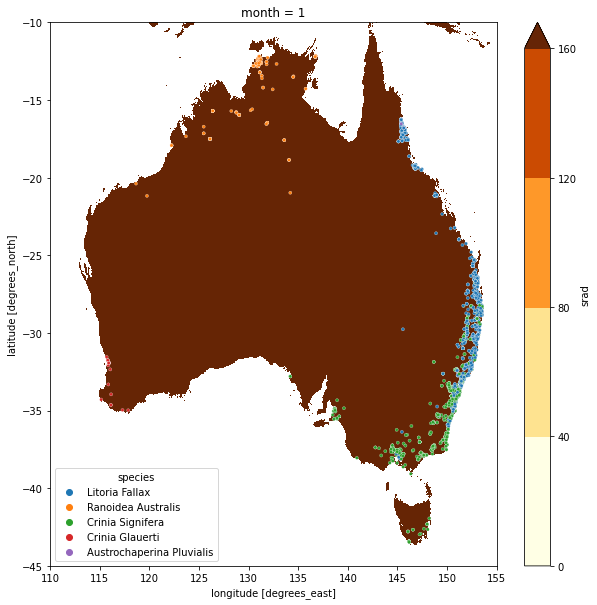

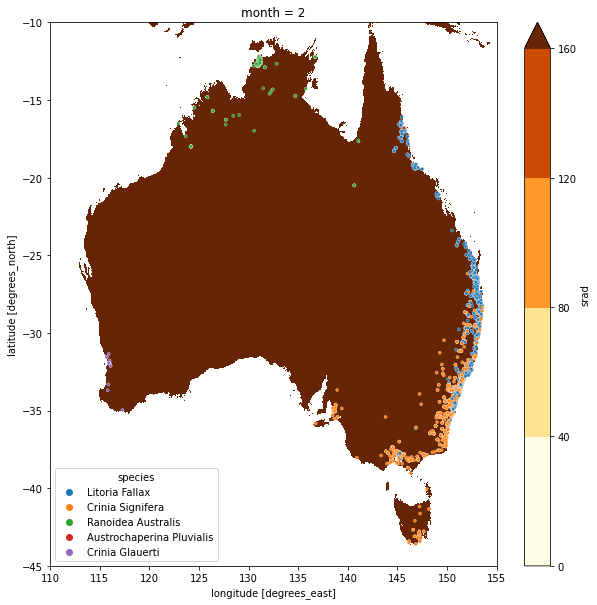

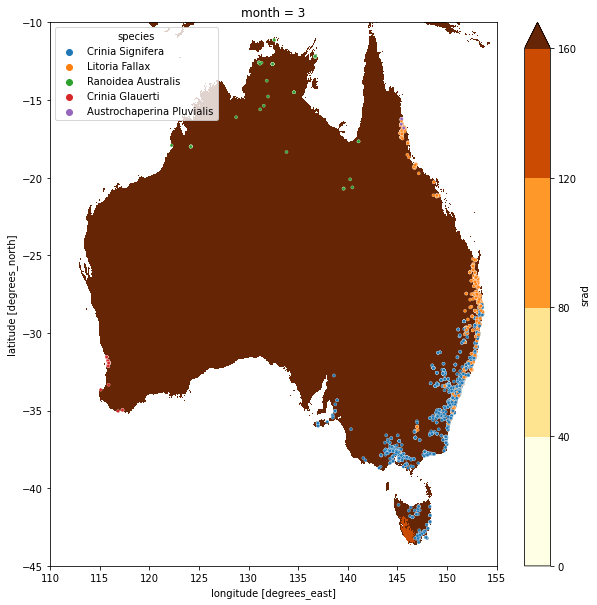

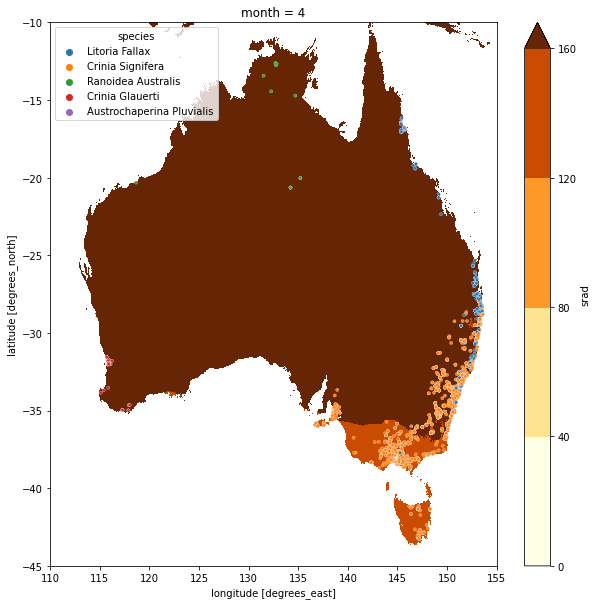

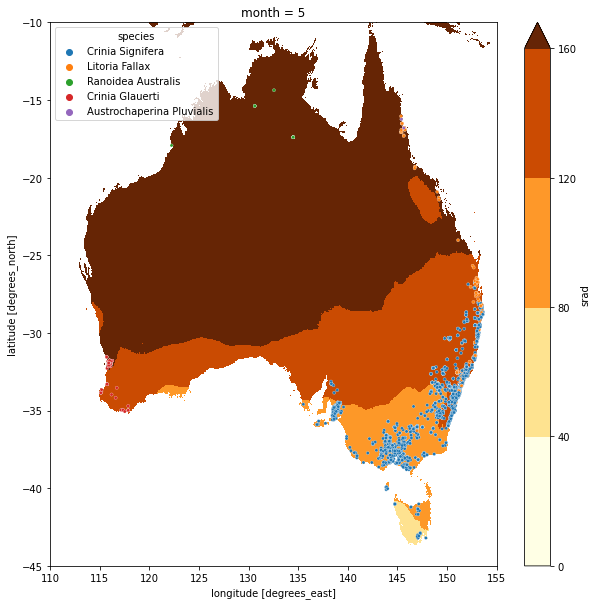

...

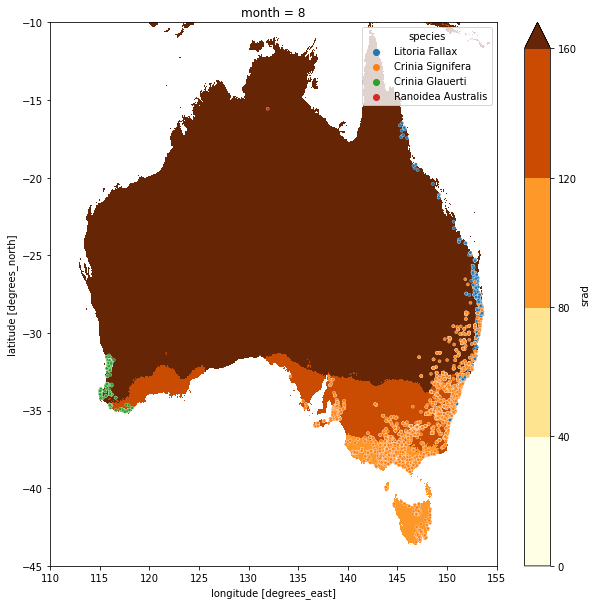

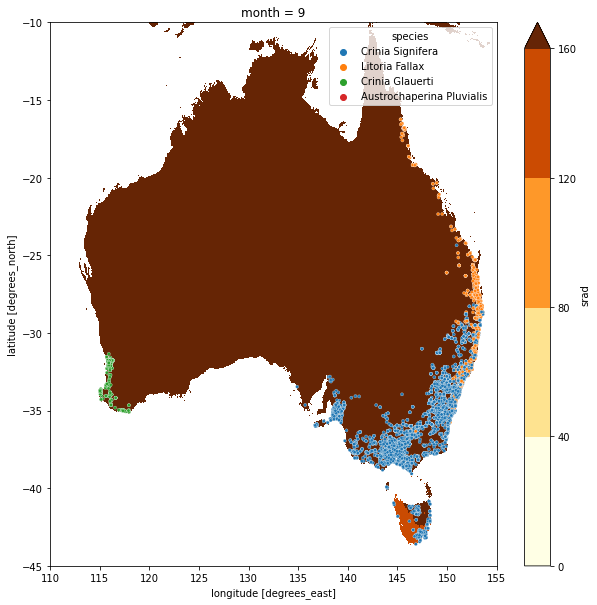

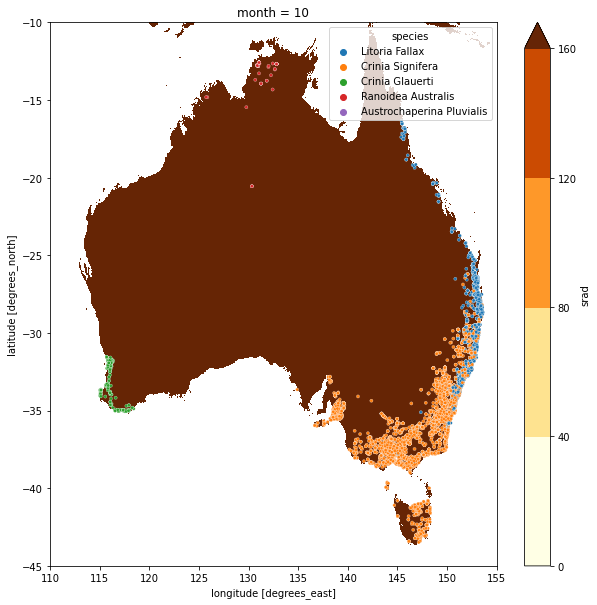

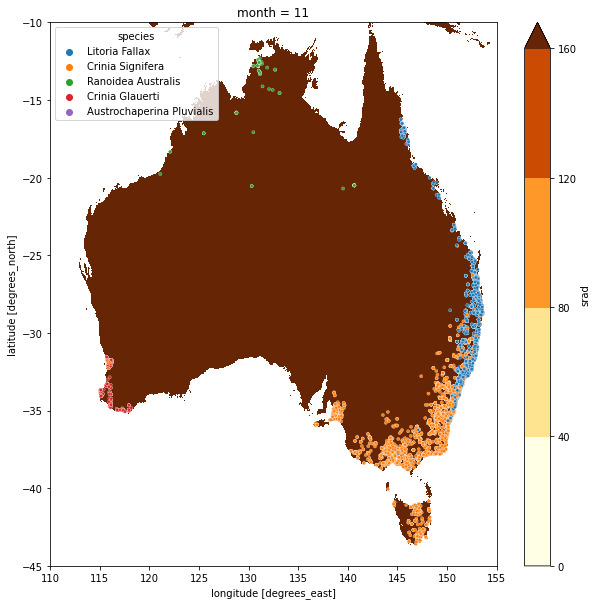

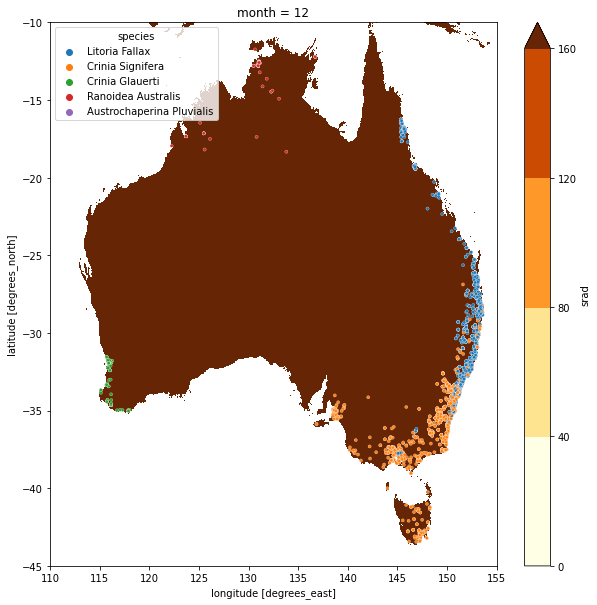

In [ ]:
for month in np.sort(all_frog_data.eventMonth.unique()):
  fig, ax = plt.subplots(figsize=(10, 10))
  plt.title(month)
  xr.plot.imshow(month_data["srad"].sel(month=month), 'lon', 'lat', cmap='YlOrBr', ax=ax, robust=True, levels=[0,40,80,120,160]) 
  sns.scatterplot(data=all_frog_data[(all_frog_data["eventMonth"]==month)], x="decimalLongitude" , y="decimalLatitude", hue="species", ax=ax, color=".2", s=10)


## Palmer Drought Severity Index


In [ ]:
fig, ax = plt.subplots(figsize=(10, 10))
xr.plot.imshow( parsed_data.pdsi.mean(dim=["time"]), 'lon', 'lat', cmap='YlOrBr', ax=ax, robust=True) 
sns.scatterplot(data=all_frog_data, x="decimalLongitude" , y="decimalLatitude", hue="species", ax=ax)

fig, ax = plt.subplots(figsize=(10, 10))
xr.plot.imshow(parsed_data.pdsi.mean(dim=["time"]), 'lon', 'lat', cmap='YlOrBr', ax=ax, robust=True) 

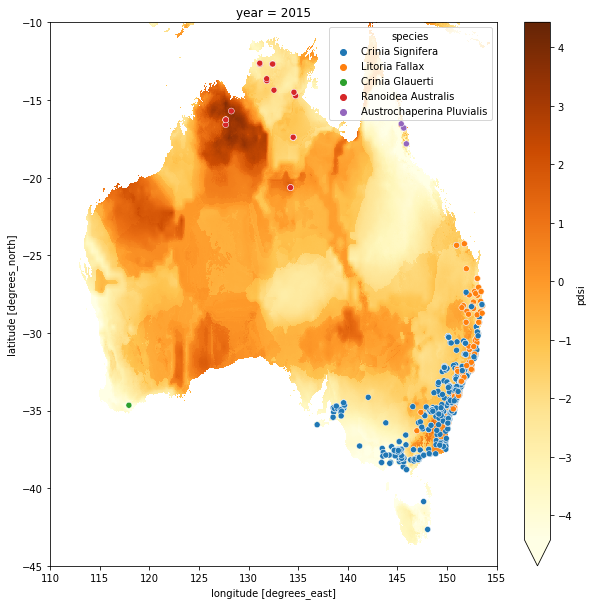

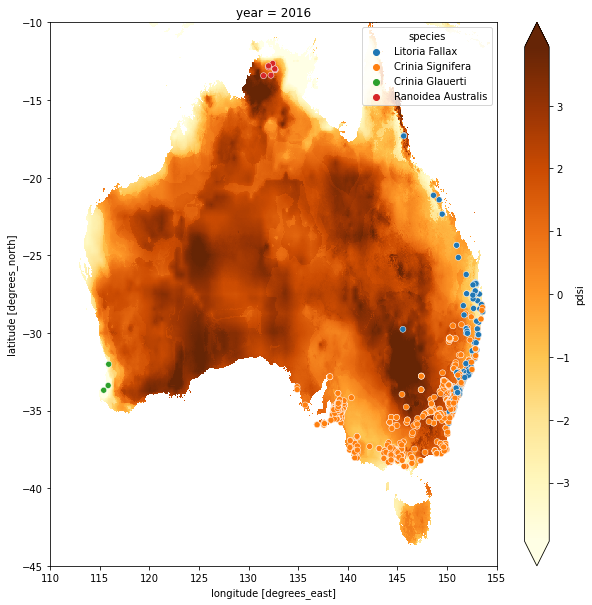

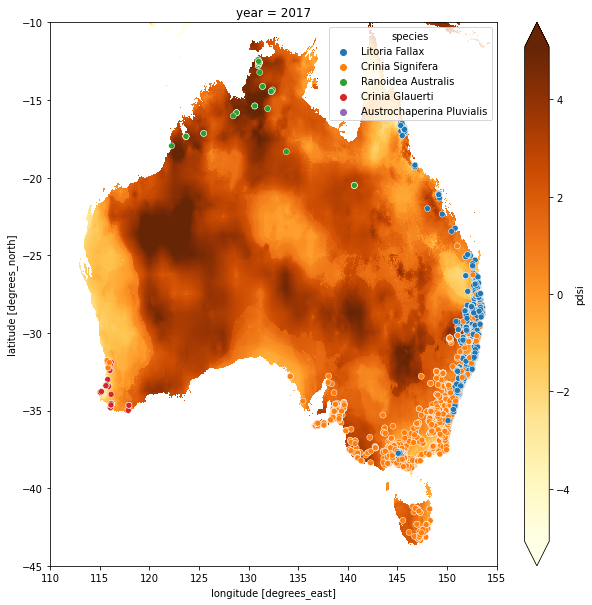

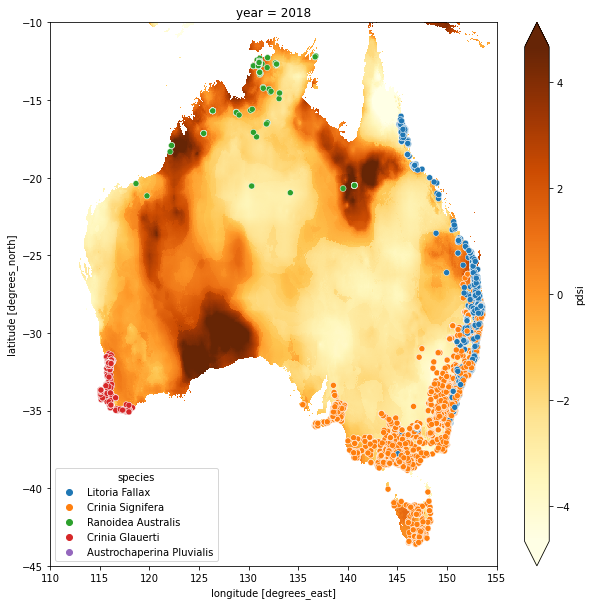

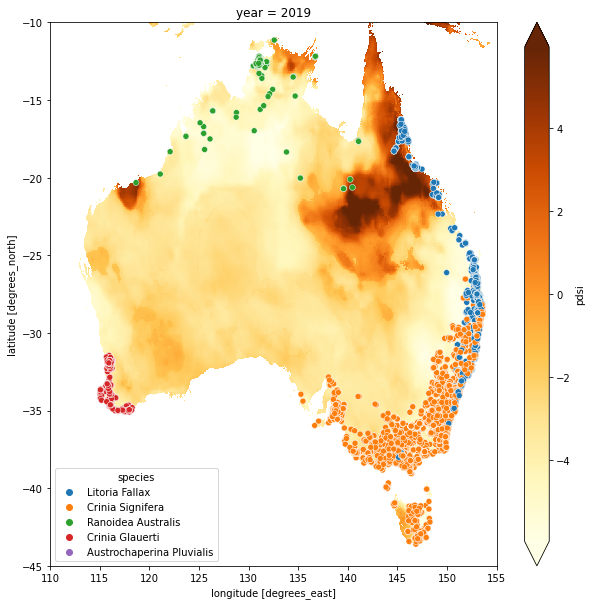

In [ ]:
for year in [2015,2016,2017,2018,2019]:
  fig, ax = plt.subplots(figsize=(10, 10))
  plt.title(year)
  xr.plot.imshow(year_data["pdsi"].sel(year=year), 'lon', 'lat', cmap='YlOrBr', ax=ax, robust=True) 
  sns.scatterplot(data=all_frog_data[(all_frog_data["eventYear"]==year)], x="decimalLongitude" , y="decimalLatitude", hue="species", ax=ax)


## Mean Vapor Pressure Deficit


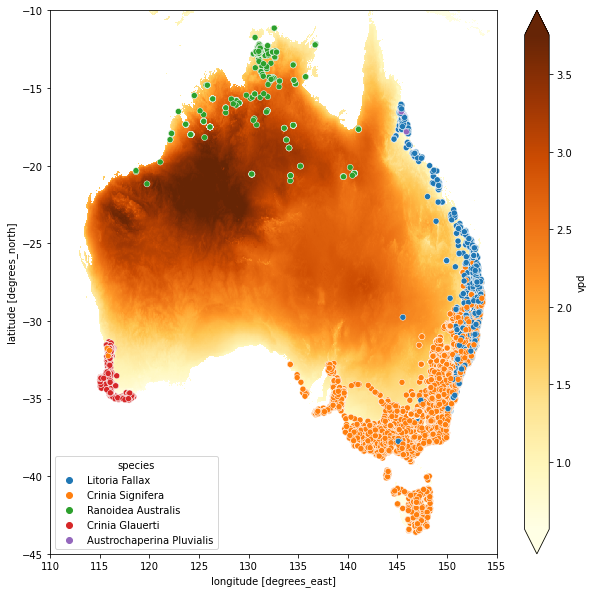

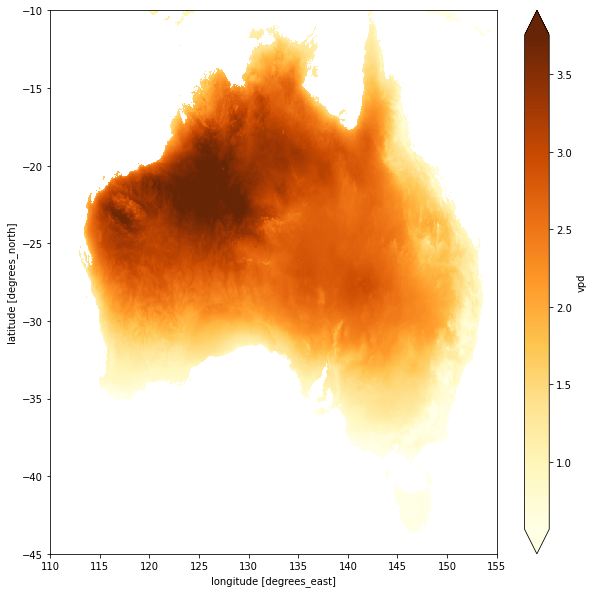

In [ ]:
fig, ax = plt.subplots(figsize=(10, 10))
xr.plot.imshow( parsed_data.vpd.mean(dim=["time"]), 'lon', 'lat', cmap='YlOrBr', ax=ax, robust=True) 
sns.scatterplot(data=all_frog_data, x="decimalLongitude" , y="decimalLatitude", hue="species", ax=ax)

fig, ax = plt.subplots(figsize=(10, 10))
xr.plot.imshow(parsed_data.vpd.mean(dim=["time"]), 'lon', 'lat', cmap='YlOrBr', ax=ax, robust=True) 

# PSEUDO ABSENCE DATA

In [ ]:
# periodo frog data
periodo_frog_data = (2015, 2022)
all_frog_data = get_frog_data(periodo_frog_data)

In [ ]:
all_frog_data.occurrenceStatus.value_counts()

0    78207
1    29224
Name: occurrenceStatus, dtype: int64

In [ ]:
min_lon, min_lat = (110, -45)  # Lower-left corner
max_lon, max_lat = (155, -10)  # Upper-right corner
bbox = (min_lon, min_lat, max_lon, max_lat)
period = ('2019-01-01','2019-12-31')

wether_data_2019 =  get_weather_data(bbox, period)
wether_data_2019 = wether_data_2019.to_array().compute()

In [ ]:
distancia = 2
density = 20
new_points = get_new_points(wether_data_2019, bbox, density, distancia)

In [ ]:
new_points

,decimalLatitude,decimalLongitude,key,aet,bio1,bio11,bio12,bio13,bio14,bio15,...,ppt,q,soil,srad,tmax,tmin,vap,vpd,ws,occurrenceStatus
0,-19.191428,128.493272,1,4.750000,28.091669,21.933334,59.0,18.0,13.0,1.087259,...,4.916667,0.166667,4.416667,277.083344,35.433338,20.750000,0.870000,3.460833,3.175000,0
1,-30.136905,138.438181,2,2.166667,21.783335,14.766667,27.0,6.0,3.0,0.891201,...,2.250000,0.000000,0.000000,249.500000,29.016668,14.550000,0.704167,2.390833,3.808333,0
2,-26.910179,128.042161,7,4.333333,23.700001,17.100000,53.0,26.0,3.0,1.558975,...,4.416667,0.083333,1.000000,254.500000,31.158335,16.241669,0.672500,2.775833,4.350000,0
3,-31.695795,142.036811,10,4.083333,20.462502,13.583333,53.0,14.0,3.0,0.874259,...,4.416667,0.166667,0.000000,236.916672,27.133333,13.791668,0.661667,2.160833,2.916666,0
4,-16.091506,130.717842,12,15.083333,28.245834,23.100000,181.0,47.0,0.0,1.241939,...,15.083333,0.750000,14.500000,263.500000,35.275002,21.216669,1.338333,2.920000,1.975000,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14093,-30.056762,136.900667,31484,2.333333,21.941668,15.350001,30.0,6.0,1.0,0.959166,...,2.500000,0.000000,0.000000,252.416672,29.083334,14.800000,0.703333,2.391666,4.050000,0
14094,-24.614528,117.375718,31491,6.833333,26.775003,19.600004,84.0,16.0,0.0,1.396059,...,7.000000,0.333333,0.000000,259.166656,34.283337,19.266670,0.789167,3.315000,3.108333,0
14095,-33.841681,136.342345,31493,18.583334,17.100002,12.166667,237.0,1.0,47.0,0.807783,...,19.750000,0.916667,1.500000,221.583328,22.575003,11.625000,1.119167,1.021667,3.891667,0
14096,-20.383759,136.159569,31497,13.916667,26.387501,19.883333,174.0,10.0,0.0,2.599811,...,14.500000,0.750000,2.750000,269.416656,33.733334,19.041670,0.897500,3.050833,3.075000,0


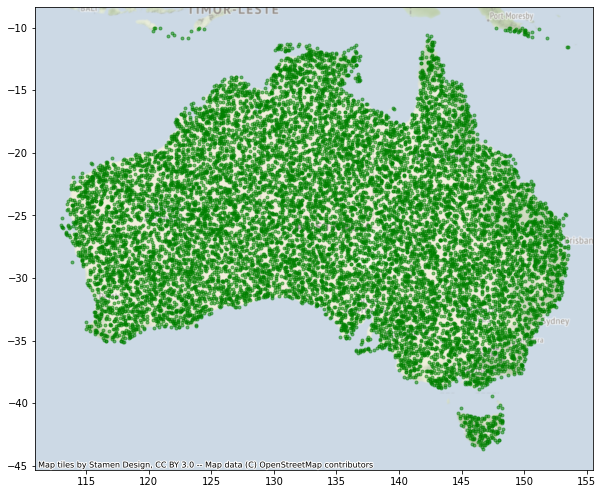

In [ ]:
fig, ax = plt.subplots(figsize = (10, 10))

ax.scatter(new_points.decimalLongitude, new_points.decimalLatitude,
          color = 'green', marker='.', alpha=0.5)

cx.add_basemap(ax, crs={'init':'epsg:4326'}, alpha=0.5)

# DATA GENERATION:

In [ ]:
# periodo frog data
folder = "/content/drive/MyDrive/EY/dataset/final/"
periodo_frog_data = (2015, 2022)
all_frog_data = get_frog_data(periodo_frog_data)

In [ ]:
# año 2019
period = ('2019-01-01','2019-12-31')
weather_data_2019, frog_data_2019 = generar_weather_data(all_frog_data , period, 2019, 2, folder)

In [ ]:
# año 2018
period = ('2018-01-01','2018-12-31')
weather_data_2018, frog_data_2018 = generar_weather_data(all_frog_data , period, 2018, 2, folder)

In [ ]:
# año 2017
period = ('2017-01-01','2017-12-31')
weather_data_2017, frog_data_2017 = generar_weather_data(all_frog_data , period, 2017, 2, folder)

In [ ]:
# año 2016
period = ('2016-01-01','2016-12-31')
weather_data_2016, frog_data_2016 = generar_weather_data(all_frog_data , period, 2016, 2, folder)

In [ ]:
# año 2015
period = ('2016-01-01','2016-12-31')
weather_data_2015, frog_data_2015 = generar_weather_data(all_frog_data , period, 2015, 2, folder)

# VARIABLES DISTRIBUTIONS

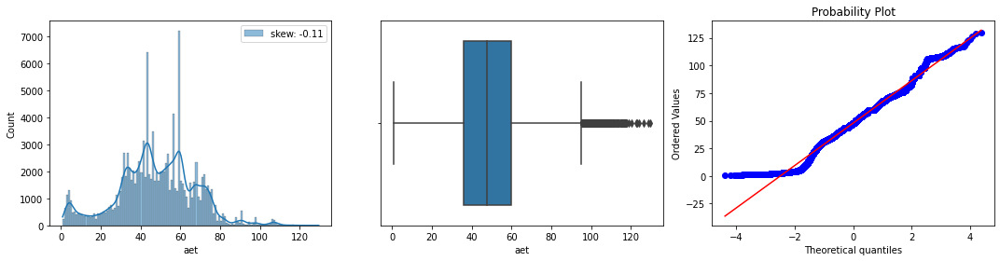

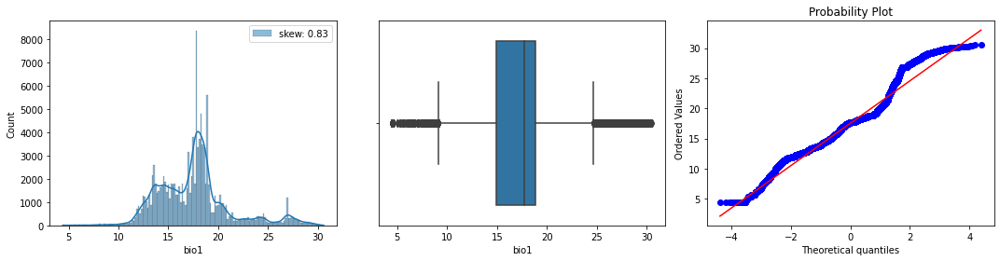

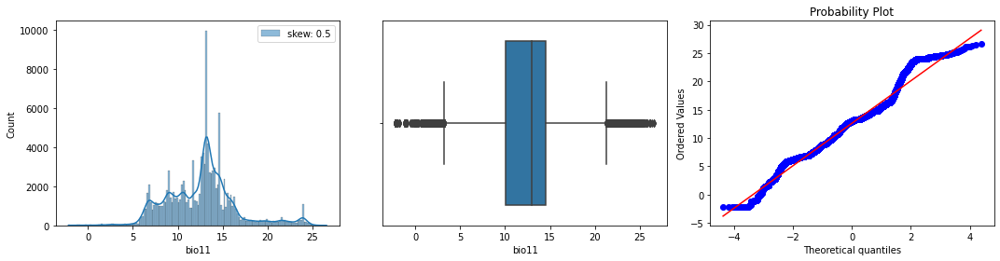

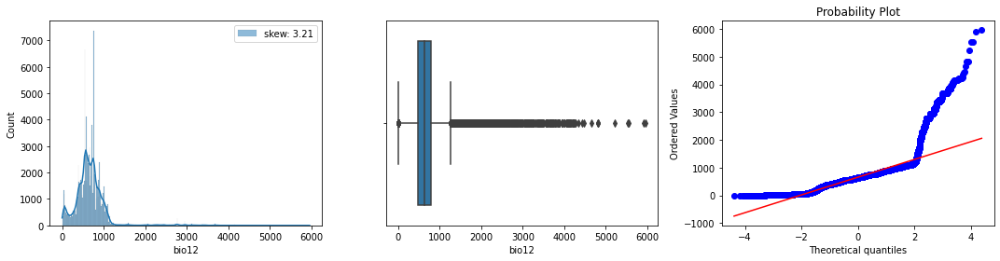

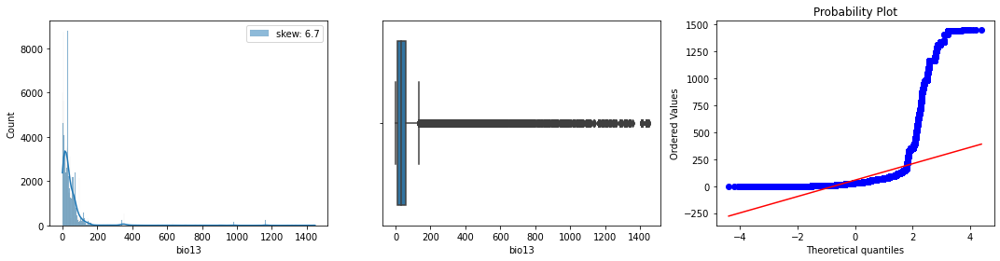

...

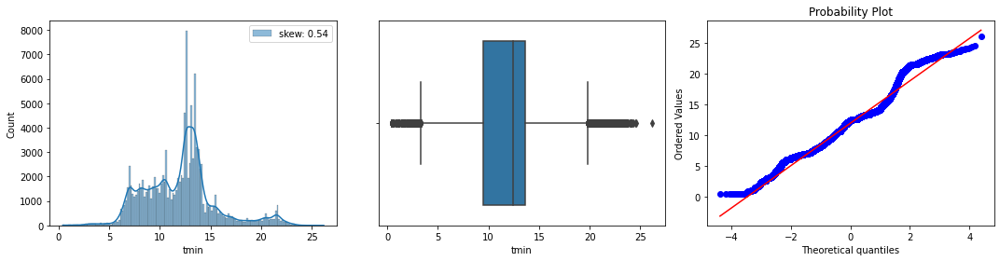

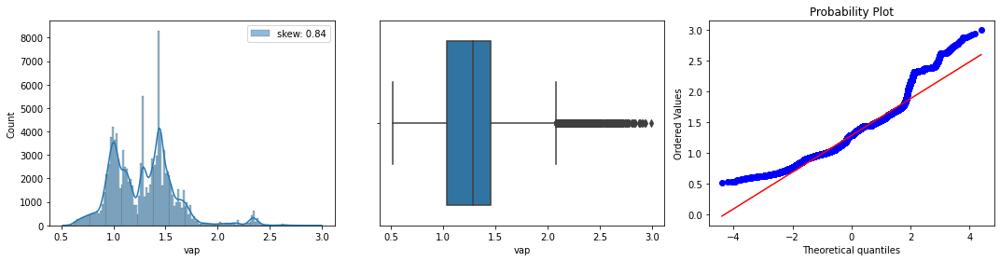

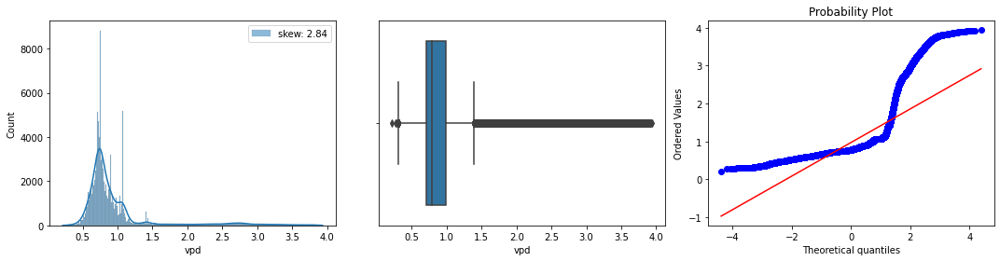

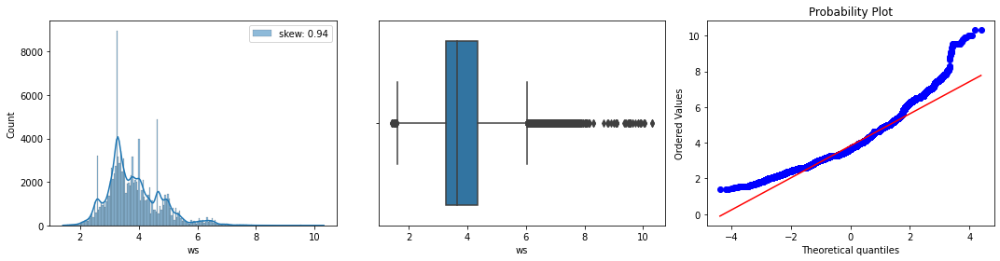

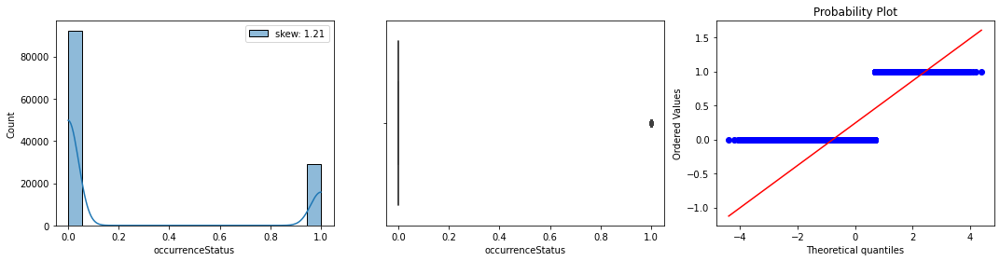

In [ ]:
numeric_features = ['aet', 'bio1', 'bio11', 'bio12', 'bio13', 'bio14', 'bio15', 'bio18',
       'bio19', 'bio2', 'bio3', 'bio4', 'bio4a', 'bio5', 'bio6', 'bio7',
       'bio8', 'bio9', 'def', 'pdsi', 'pet', 'ppt', 'q', 'soil', 'srad',
       'tmax', 'tmin', 'vap', 'vpd', 'ws', 'occurrenceStatus']

df = frog_data_2019[numeric_features]

display_dataset_distributions(df)

# CORRELATION BETWEEN VARIABLES

In [ ]:
df = frog_data_2019

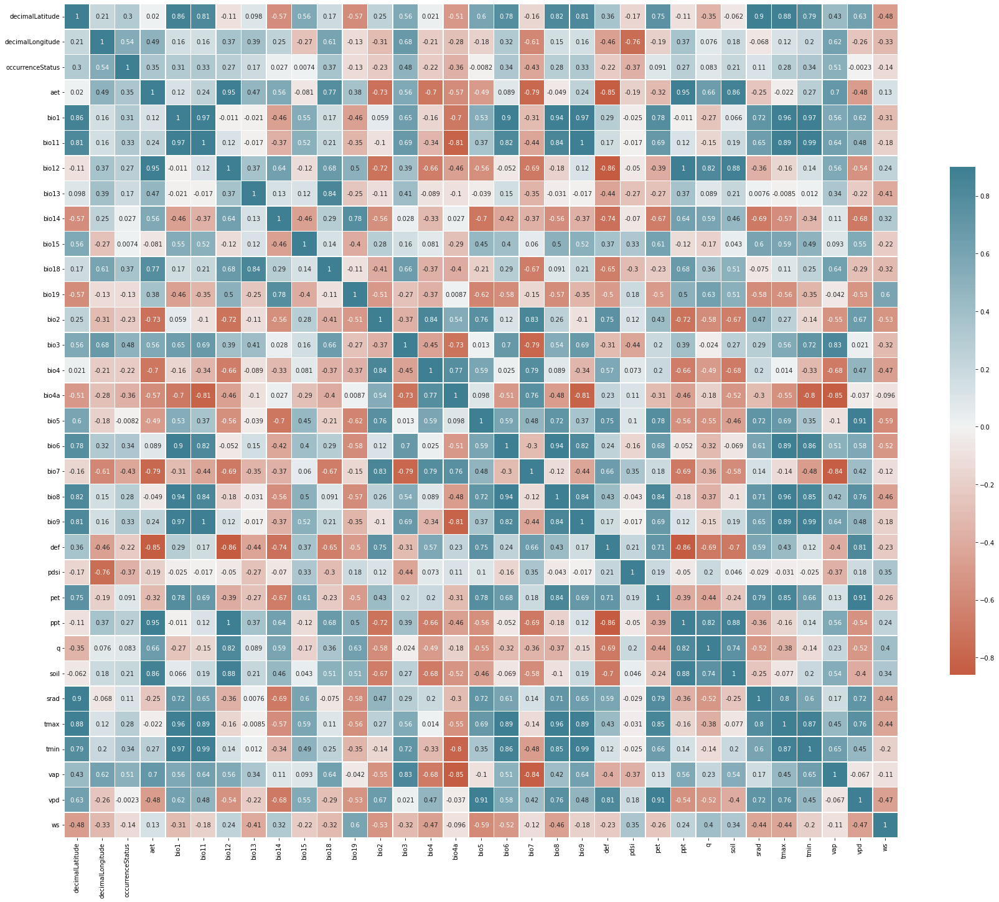

In [ ]:
# We evaluate monotonic relationships with Spearman's correlation.
fig = plt.figure(figsize=(30,30))
sns.heatmap(df.corr(method='spearman'), cmap=sns.diverging_palette(20, 220, n=200), vmax=.9, center=0,square=True, linewidths=.5, cbar_kws={"shrink": .5},annot=True)
plt.show()

There are variables highly correlational with our target variable.

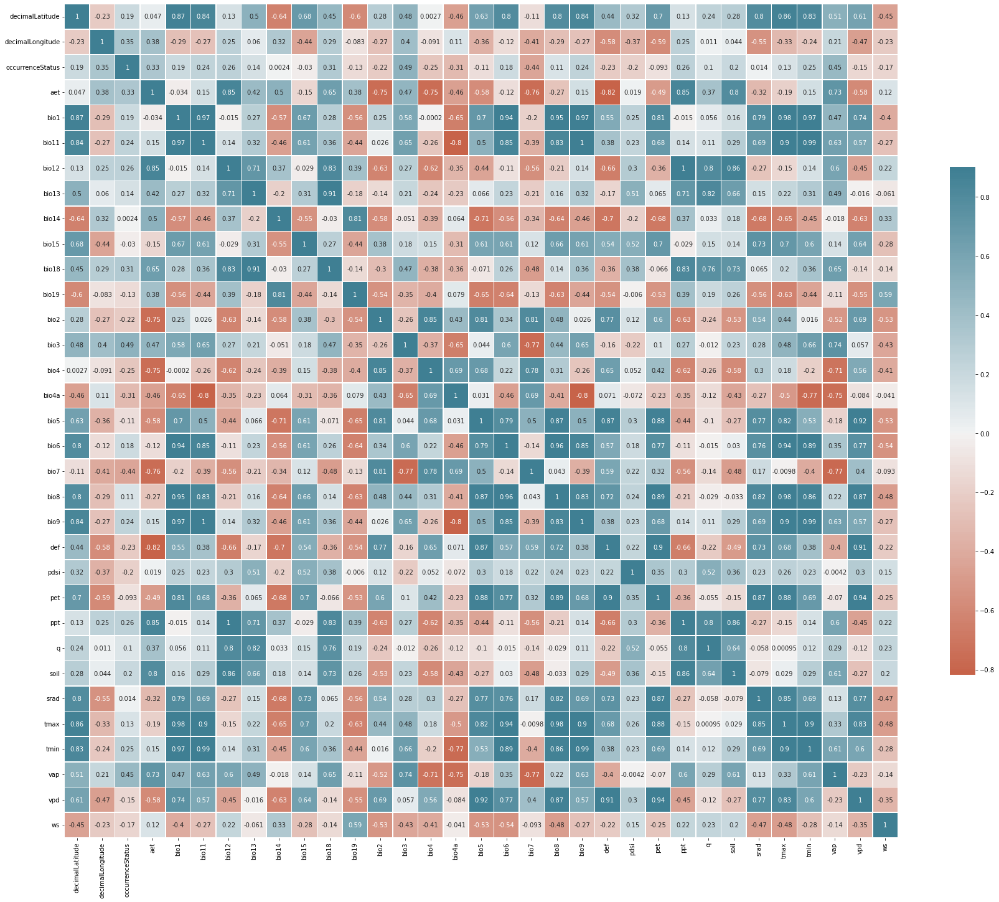

In [ ]:
# We evaluate linear relationships with Pearson's correlation.

fig = plt.figure(figsize=(30,30))
sns.heatmap(df.corr(method='pearson'), cmap=sns.diverging_palette(20, 220, n=200), vmax=.9, center=0,square=True, linewidths=.5, cbar_kws={"shrink": .5},annot=True)
plt.show()

There are variables highly correlational with our target variable.

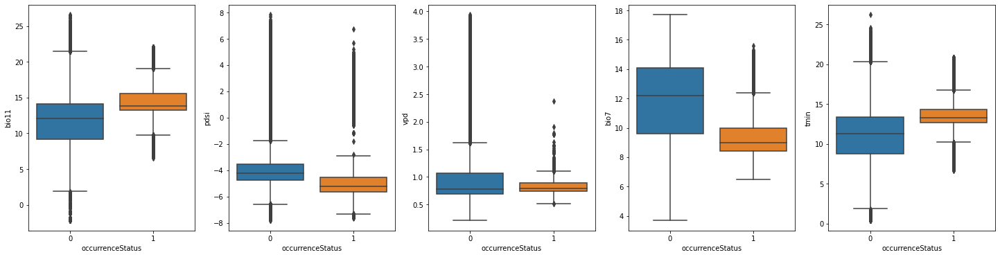

In [ ]:
fig, axes = plt.subplots(1, 5, figsize=(25, 6))
sns.boxplot(x="occurrenceStatus", y='bio11', data=df, ax=axes[0])
sns.boxplot(x="occurrenceStatus", y='pdsi', data=df, ax=axes[1])
sns.boxplot(x="occurrenceStatus", y='vpd', data=df, ax=axes[2])
sns.boxplot(x="occurrenceStatus", y='bio7', data=df, ax=axes[3])
sns.boxplot(x="occurrenceStatus", y='tmin', data=df, ax=axes[4])
plt.show()

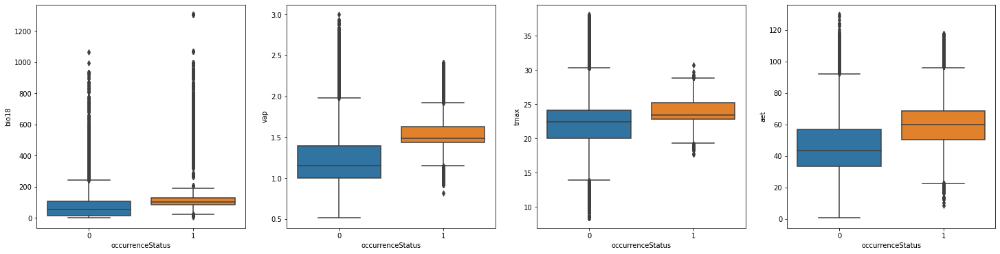

In [ ]:
fig, axes = plt.subplots(1, 4, figsize=(25, 6))
sns.boxplot(x="occurrenceStatus", y='bio18', data=df, ax=axes[0])
sns.boxplot(x="occurrenceStatus", y='vap', data=df, ax=axes[1])
sns.boxplot(x="occurrenceStatus", y='tmax', data=df, ax=axes[2])
sns.boxplot(x="occurrenceStatus", y='aet', data=df, ax=axes[3])
plt.show()

# K MEANS

We used the K-Means clustering method to create data grouping into clusters based on the similarity of the variables.

We just tried to discover clusters on the dataset, and we are not using this for future predictions.

In [ ]:
df = frog_data_2019
df = df.dropna()

In [ ]:
df.columns

Index(['decimalLatitude', 'decimalLongitude', 'occurrenceStatus', 'aet',
       'bio1', 'bio11', 'bio12', 'bio13', 'bio14', 'bio15', 'bio18', 'bio19',
       'bio2', 'bio3', 'bio4', 'bio4a', 'bio5', 'bio6', 'bio7', 'bio8', 'bio9',
       'def', 'pdsi', 'pet', 'ppt', 'q', 'soil', 'srad', 'tmax', 'tmin', 'vap',
       'vpd', 'ws'],
      dtype='object')

In [ ]:
df_aux = (df.drop(['decimalLatitude', 'decimalLongitude', 'occurrenceStatus'], 1))

In [ ]:
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=5, init='k-means++', n_init=10).fit(df_aux)

In [ ]:
df["cluster"] = kmeans.labels_

No handles with labels found to put in legend.


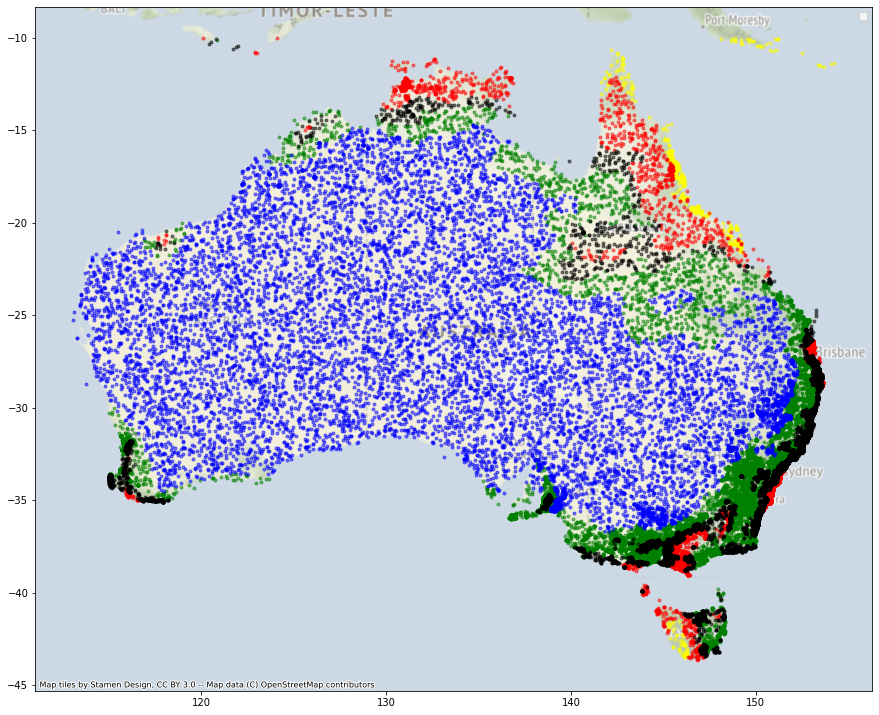

In [ ]:
fig, ax = plt.subplots(figsize = (15, 15))

for i, color in enumerate(['green', 'yellow', 'red', 'blue', 'black', ]):

# 'brown', 'orange', 'pink', 'white', 'magenta', 'C0', 'C1'

  ax.scatter(df[df.cluster == i].decimalLongitude,df[df.cluster == i].decimalLatitude,
            color = color, marker='.', alpha=0.5)


ax.legend()
cx.add_basemap(ax, crs={'init':'epsg:4326'}, alpha=0.5)


We didn't use any geospatial information and we obtained a good result.

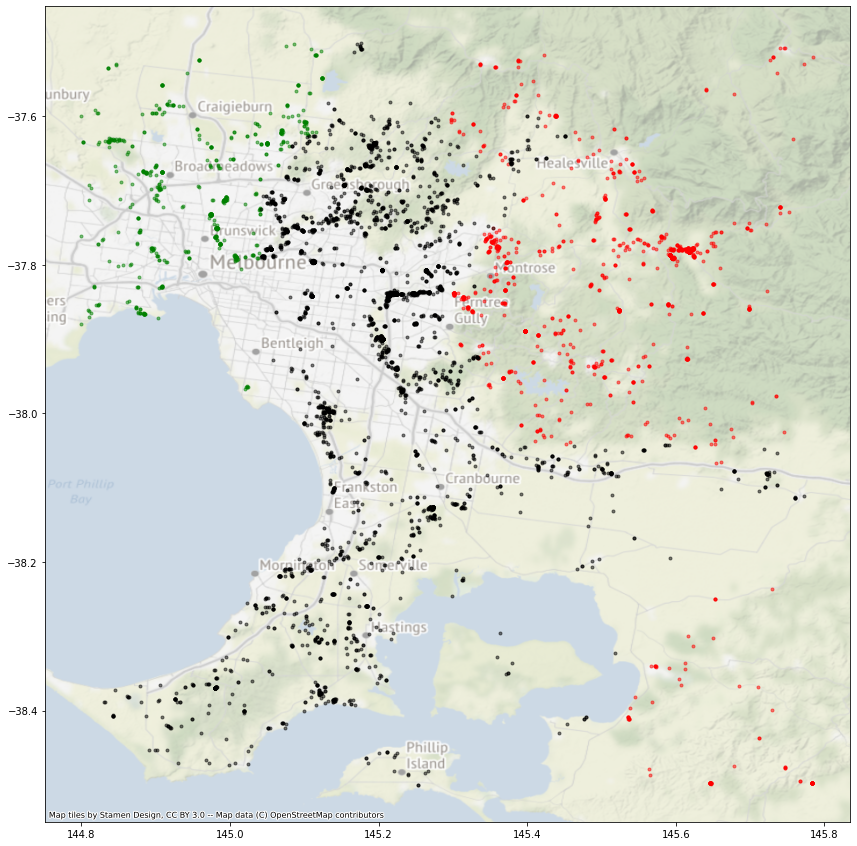

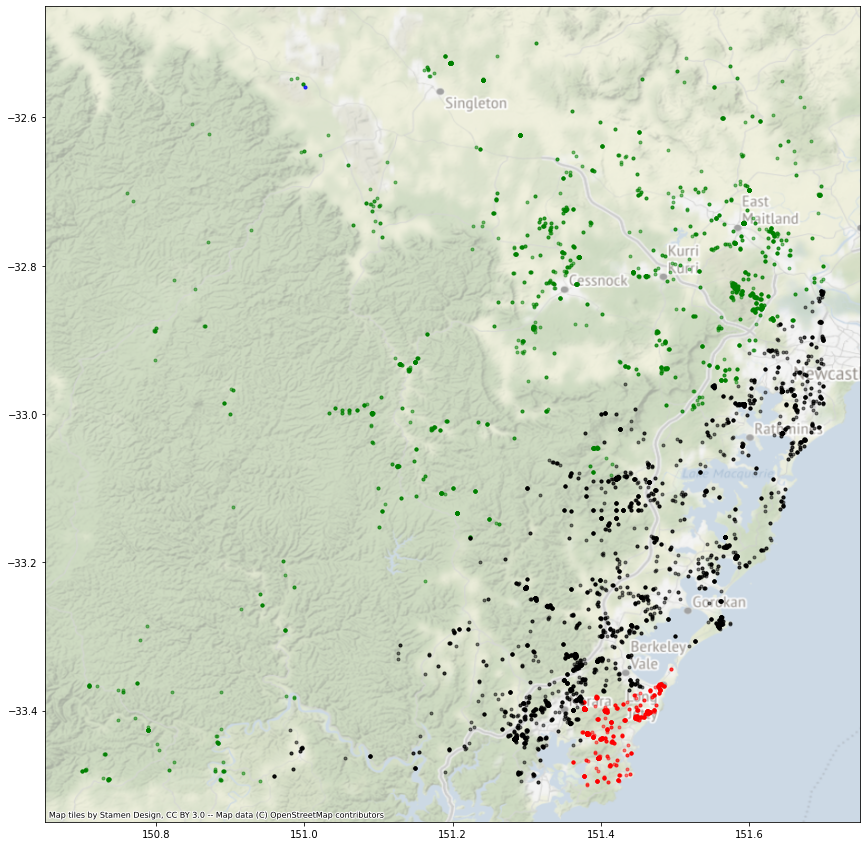

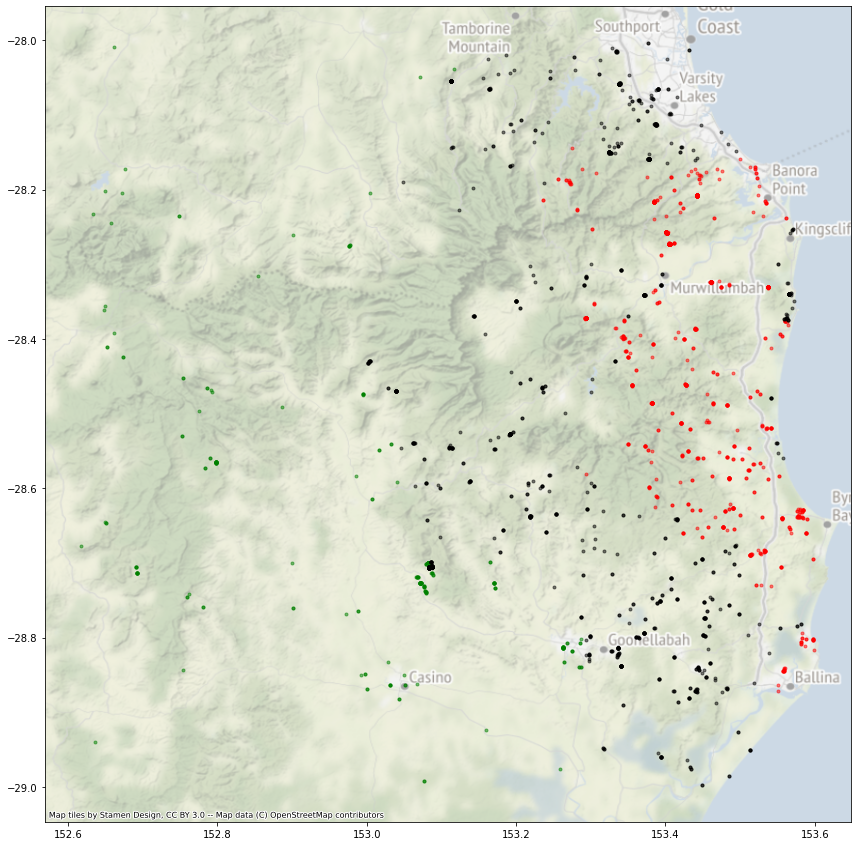

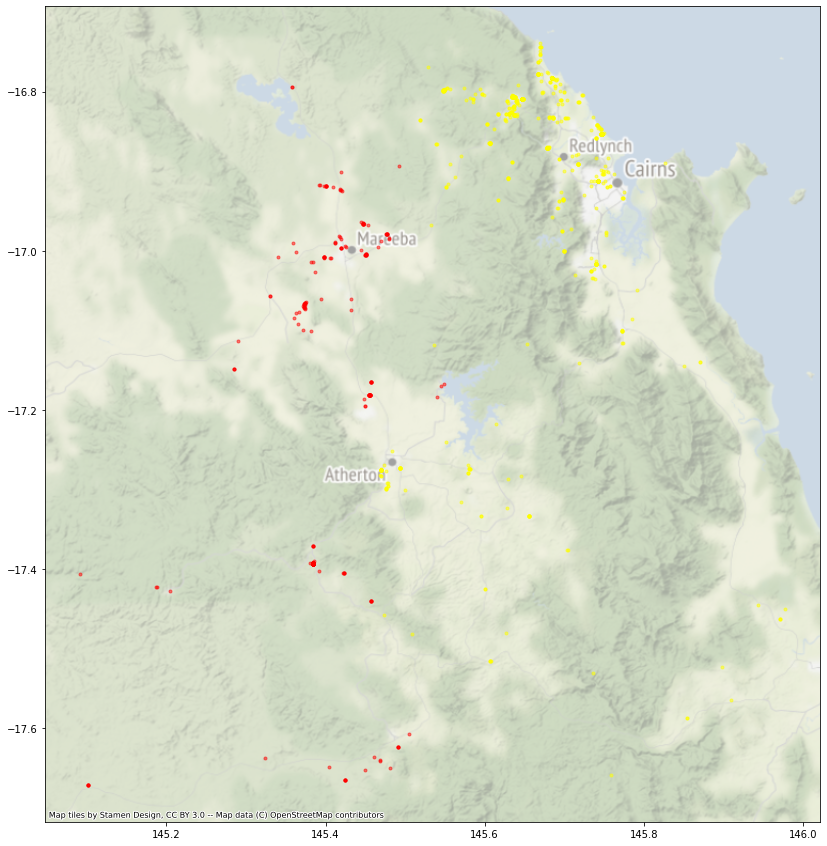

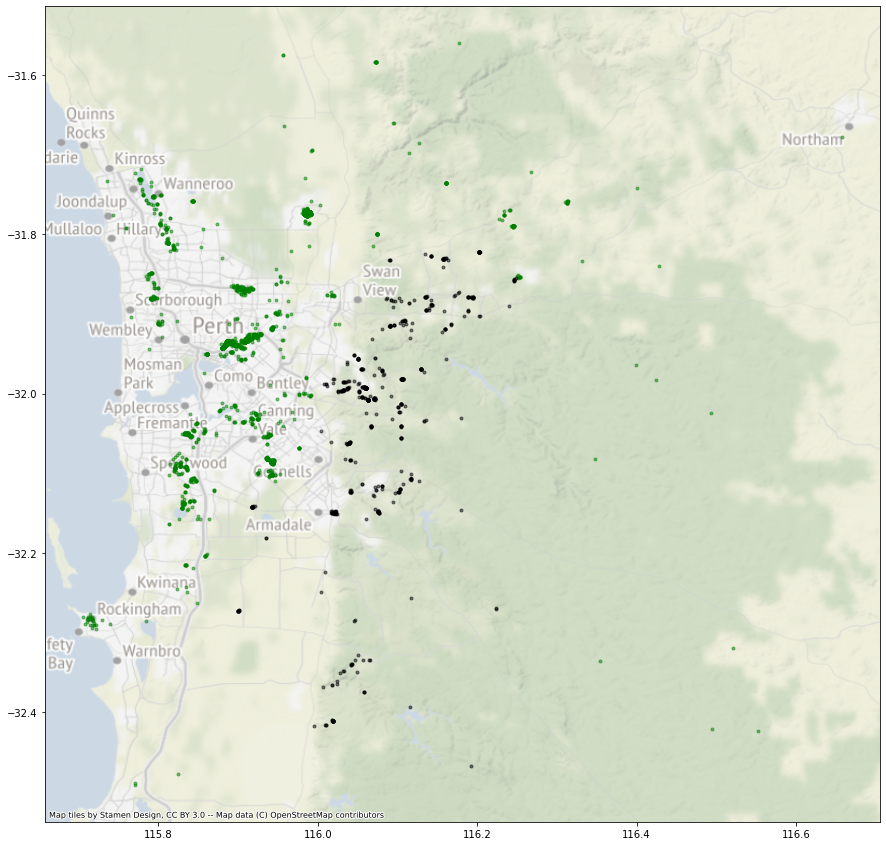

In [ ]:
# Read in test regions
test_1_regions = []
with open('/content/drive/MyDrive/EY/challenge_1_test_regions.txt', 'r') as file: 
    for i, line in enumerate(file):
        if i > 0:
            test_1_regions.append(eval("("+line+")"))

regions = [{'title':i, 'bbox':bbox} for i, bbox in enumerate(test_1_regions)]
# regions = [{'bbox': (153.4, -28.6, 153.6, -28.4), 'title': 0}]
for coordenates in regions:

  fig, ax = plt.subplots(figsize = (15, 15))
  coord = df[(df.decimalLongitude >= coordenates["bbox"][0]) & (df.decimalLongitude <= coordenates["bbox"][2]) & (df.decimalLatitude >= coordenates["bbox"][1]) & (df.decimalLatitude <= coordenates["bbox"][3])]

  for i, color in enumerate(['green', 'yellow', 'red', 'blue', 'black', 'brown', 'orange', 'pink', 'white', 'magenta', 'C0', 'C1']):
    ax.scatter(coord[coord.cluster == i].decimalLongitude,coord[coord.cluster == i].decimalLatitude,
              color = color, marker='.', alpha=0.5)

  cx.add_basemap(ax, crs={'init':'epsg:4326'}, alpha=0.5)


# MODEL SELECTION

In [ ]:
df = frog_data_2019
df = df.dropna()

df = (df.drop(['decimalLatitude', 'decimalLongitude'], 1))

y = df.occurrenceStatus.astype(int)
X = df.drop(columns=['occurrenceStatus'])

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3,  random_state=1, stratify=y)

RandomForestClassifier()
ExtraTreesClassifier()
GradientBoostingClassifier()
BaggingClassifier()
AdaBoostClassifier()
XGBClassifier()
XGBRFClassifier()
DecisionTreeClassifier()


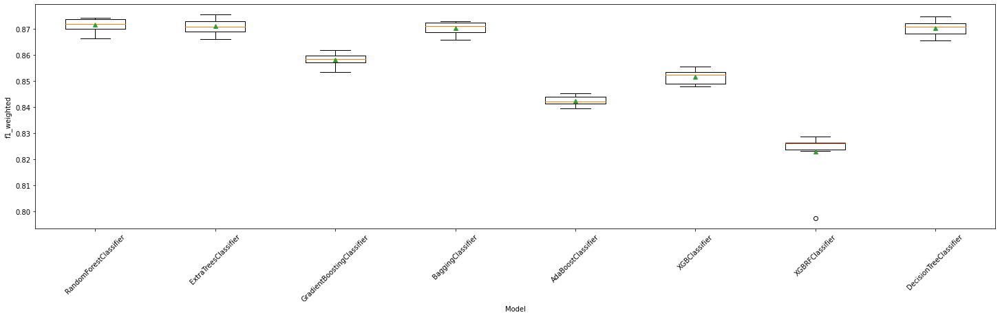

In [ ]:
modelos = [RandomForestClassifier(), ExtraTreesClassifier(), GradientBoostingClassifier(),
    BaggingClassifier(), AdaBoostClassifier(), XGBClassifier(),
    XGBRFClassifier(), DecisionTreeClassifier()]

lista_modelos = ['RandomForestClassifier', 'ExtraTreesClassifier',
                 'GradientBoostingClassifier', 'BaggingClassifier', 'AdaBoostClassifier', 'XGBClassifier',
                 'XGBRFClassifier', 'DecisionTreeClassifier']

results = []
for m in modelos:
    print (m)
    
    cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=2, random_state=42)
    scores = cross_val_score(m, X_train, y_train, scoring= 'f1_weighted' , cv=cv, n_jobs=-1)
    results.append(scores)
    
fig,axes = plt.subplots(1,figsize=(25,6))
plt.xticks(rotation = 45)
axes.boxplot(results,labels=lista_modelos, showmeans=True)

axes.set_xlabel("Model")
axes.set_ylabel("f1_weighted")

plt.show()

In [ ]:
for i, model in enumerate(lista_modelos):
  print(model, np.mean(results[i]))

RandomForestClassifier 0.8714816012690584
ExtraTreesClassifier 0.8709566417485146
GradientBoostingClassifier 0.8581551810543718
BaggingClassifier 0.870276340399138
AdaBoostClassifier 0.8424506989707027
XGBClassifier 0.8515611000984004
XGBRFClassifier 0.8230569934849479
DecisionTreeClassifier 0.8702173868694398


RandomForestClassifier()
LGBMClassifier()


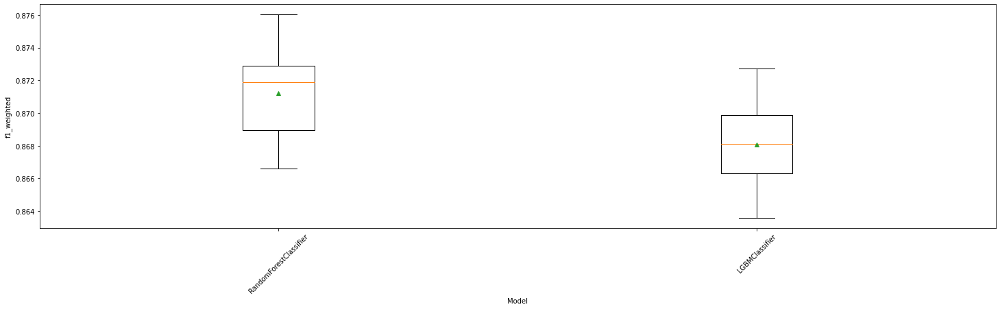

In [ ]:
modelos = [RandomForestClassifier(), lgb.LGBMClassifier()]

lista_modelos = ['RandomForestClassifier', 'LGBMClassifier']

results = []
for m in modelos:
    print (m)
    
    cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=5, random_state=42)
    scores = cross_val_score(m, X_train, y_train, scoring= 'f1_weighted' , cv=cv, n_jobs=-1)
    results.append(scores)
    
fig,axes = plt.subplots(1,figsize=(25,6))
plt.xticks(rotation = 45)
axes.boxplot(results,labels=lista_modelos, showmeans=True)

axes.set_xlabel("Model")
axes.set_ylabel("f1_weighted")

plt.show()

In [ ]:
for i, model in enumerate(lista_modelos):
  print(model, np.mean(results[i]))

RandomForestClassifier 0.871231038719296
LGBMClassifier 0.8680930478605743


# BASE MODEL

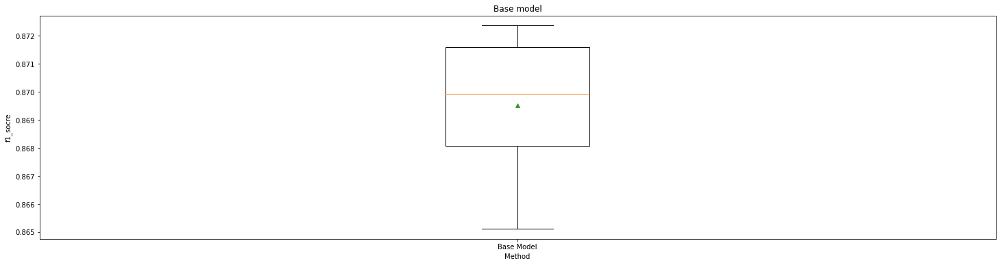

In [ ]:
results = []

cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=2, random_state=42)
scores = cross_val_score(lgb.LGBMClassifier(), X_train, y_train, scoring= 'f1_weighted' , cv=cv, n_jobs=-1)

results.append(scores)

    
fig,axes = plt.subplots(1,figsize=(25,6))
axes.boxplot(results,labels=["Base Model"],showmeans=True)
axes.set_xlabel("Method")
axes.set_ylabel("f1_socre")
axes.set_title("Base model");
plt.show()

In [ ]:
  print("lgb.LGBMClassifier", np.mean(results))

lgb.LGBMClassifier 0.8695060663246297


# VARIABLE TRANSFORMATION

QuantileTransformer(output_distribution='normal')
QuantileTransformer()
StandardScaler()
RobustScaler()
MaxAbsScaler()
MinMaxScaler()
PowerTransformer()
KBinsDiscretizer(n_bins=10)
Normalizer()


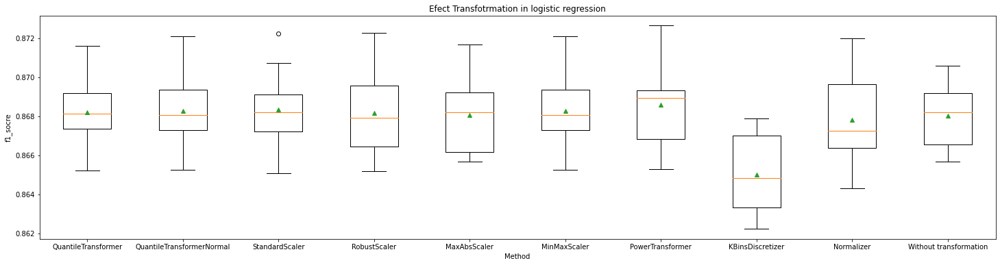

In [ ]:
qt = QuantileTransformer(output_distribution='normal')
ut = QuantileTransformer(output_distribution='uniform')
ss = StandardScaler()
rs = RobustScaler()
ms = MaxAbsScaler()
mms = MinMaxScaler()
pt = PowerTransformer(method='yeo-johnson')
kb = KBinsDiscretizer(n_bins=10 )
nor = Normalizer()

modelos =[qt, ut, ss, rs, ms, mms, pt,kb, nor]
results = []


numeric_features = [ 'ws', 'pet', 'tmax',
       'tmin', 'ppt', 'soil', 'def', 'vap', 'vpd', 'aet', 'srad', 'q', 'pdsi',
       'bio1', 'bio2', 'bio5', 'bio6', 'bio7', 'bio3', 'bio4', 'bio4a', 'bio8',
       'bio9', 'bio11', 'bio12', 'bio13', 'bio14', 'bio15', 'bio18', 'bio19']

for trans in modelos:
    print(trans)


    numeric_transformer = Pipeline(steps=[("scaler", trans)])
    preprocessor = ColumnTransformer(
    transformers=[("num", numeric_transformer, numeric_features)])


    model = Pipeline(steps=[("preprocessor", preprocessor),
                          ("classifier", lgb.LGBMClassifier())
                          ])
      

    cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=2, random_state=42)
    scores = cross_val_score(model, X_train, y_train, scoring= 'f1_weighted' , cv=cv, n_jobs=-1)

    results.append(scores)

cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=2, random_state=42)
scores = cross_val_score(lgb.LGBMClassifier(), X_train, y_train, scoring= 'f1_weighted' , cv=cv, n_jobs=-1)

results.append(scores)
    
fig,axes = plt.subplots(1,figsize=(25,6))
axes.boxplot(results,labels=['QuantileTransformer', 'QuantileTransformerNormal', 'StandardScaler', 'RobustScaler', 'MaxAbsScaler', 'MinMaxScaler', 
                             'PowerTransformer', 'KBinsDiscretizer', 'Normalizer', "Without transformation" ],showmeans=True)
axes.set_xlabel("Method")
axes.set_ylabel("f1_socre")
axes.set_title("Efect Transfotrmation in logistic regression");
plt.show()

In [ ]:
for i, model in enumerate(['QuantileTransformer', 'QuantileTransformerNormal', 'StandardScaler', 'RobustScaler', 'MaxAbsScaler', 'MinMaxScaler', 
                             'PowerTransformer', 'KBinsDiscretizer', 'Normalizer', "without transformation" ]):
  print(model, np.mean(results[i]))

QuantileTransformer 0.8682205542807079
QuantileTransformerNormal 0.8682843826338758
StandardScaler 0.868328623343392
RobustScaler 0.8681829380363861
MaxAbsScaler 0.8680796309988992
MinMaxScaler 0.8682843826338758
PowerTransformer 0.8685961775552158
KBinsDiscretizer 0.8650255257245487
Normalizer 0.8678256374987416
without transformation 0.8680170838760788


# RESAMPLING

RandomUnderSampler(replacement=True)


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:  1.0min finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


SMOTE(n_jobs=-1)


[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:  2.7min finished


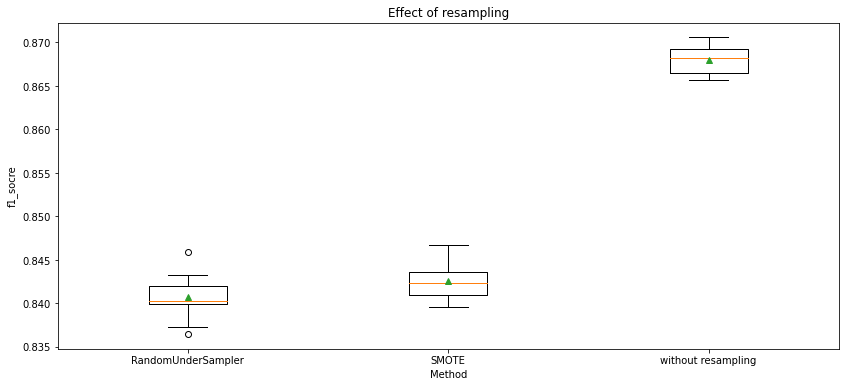

In [ ]:
#Transformer:

trans = PowerTransformer(method='yeo-johnson')

rs = RandomUnderSampler(replacement=True)
smote = SMOTE(sampling_strategy='auto', n_jobs=-1)



modelos = [rs, smote]


numeric_features = ['aet', 'bio1', 'bio11', 'bio12', 'bio13', 'bio14', 'bio15', 'bio18',
       'bio19', 'bio2', 'bio3', 'bio4', 'bio4a', 'bio5', 'bio6', 'bio7',
       'bio8', 'bio9', 'def', 'pdsi', 'pet', 'ppt', 'q', 'soil', 'srad',
       'tmax', 'tmin', 'vap', 'vpd', 'ws']


results = []

for resampler in modelos:
    print(resampler)


    numeric_transformer = Pipeline(steps=[("scaler", trans)])
    preprocessor = ColumnTransformer(
    transformers=[("num", numeric_transformer, numeric_features)])


    model = Pipeline(steps=[("preprocessor", preprocessor),
                            ("resampling", resampler),
                          ("classifier", lgb.LGBMClassifier())
                          ])
      

    cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=2, random_state=42)
    scores = cross_val_score(model, X, y, scoring= 'f1_weighted' , cv=cv, n_jobs=-1, verbose=2)

    results.append(scores)

cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=2, random_state=42)
scores = cross_val_score(lgb.LGBMClassifier(), X_train, y_train, scoring= 'f1_weighted' , cv=cv, n_jobs=-1)

results.append(scores)


fig,axes = plt.subplots(1,figsize=(14,6))
axes.boxplot(results,labels=['RandomUnderSampler', 'SMOTE', 'without resampling'],showmeans=True)
axes.set_xlabel("Method")
axes.set_ylabel("f1_socre")
axes.set_title("Effect of resampling");
plt.show()


In [ ]:
for i, model in enumerate(['RandomUnderSampler', 'SMOTE', 'without resampling']):
  print(model, np.mean(results[i]))

RandomUnderSampler 0.8407121787049119
SMOTE 0.8426090380897792
without resampling 0.8680170838760788


# CALIBRATION

In [ ]:
df = frog_data_2019
df = df.dropna()

df = (df.drop(['decimalLatitude', 'decimalLongitude'], 1))

y = df.occurrenceStatus.astype(int)
X = df.drop(columns=['occurrenceStatus'])

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3,  random_state=1, stratify=y)

In [ ]:
lgb_clasifier =  lgb.LGBMClassifier(baggingFraction=0.7919582030577866, colsample_bytree= 0.22555774633464717, featureFraction= 0.8580616162813256, 
 lambdaL1= 0.7027042200235055, lambdaL2=59.87623577428611, learning_rate= 0.9749307583148132, max_bin= 59, max_depth=72, minSumHessianInLeaf= 0.11309715489381478,
 min_child_weight= 46, min_data_in_leaf= 43, min_split_gain= 0.10351855586031637, n_estimators=660, num_leaves=112, 
 reg_alpha= 0.26899007162731453, reg_lambda=0.19664148137953907, subsample= 0.5890662698522485,  is_unbalance=True)

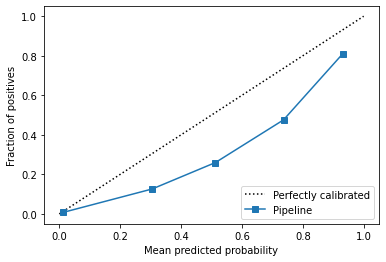

In [ ]:
trans = PowerTransformer(method='yeo-johnson')

numeric_features = ['aet', 'bio1', 'bio11', 'bio12', 'bio13', 'bio14', 'bio15', 'bio18',
       'bio19', 'bio2', 'bio3', 'bio4', 'bio4a', 'bio5', 'bio6', 'bio7',
       'bio8', 'bio9', 'def', 'pdsi', 'pet', 'ppt', 'q', 'soil', 'srad',
       'tmax', 'tmin', 'vap', 'vpd', 'ws']


results = []

numeric_transformer = Pipeline(steps=[("scaler", trans)])
preprocessor = ColumnTransformer(
transformers=[("num", numeric_transformer, numeric_features)])


model = Pipeline(steps=[("preprocessor", preprocessor),
                      ("classifier", lgb_clasifier)
                      ])
  
model.fit(X_train, y_train)

disp = CalibrationDisplay.from_estimator(model, X_test, y_test)

plt.show()


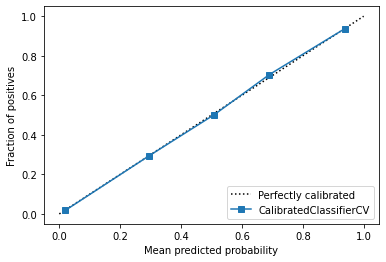

In [ ]:
model = Pipeline(steps=[
                        ("preprocessor", preprocessor), 
                        ("classifier", lgb_clasifier)])


    
calibrated = CalibratedClassifierCV(model, method='isotonic', cv=5)

calibrated.fit(X_train, y_train)

disp2 = CalibrationDisplay.from_estimator(calibrated, X_test, y_test)

plt.show()

# HYPERPARAMTER TUNNING

## HYPEROPT

In [ ]:
space = {
    'num_leaves':       hp.choice('num_leaves', range(2, 200, 1)),
    'max_depth':        hp.choice('max_depth', range(2, 100, 1)),
    'min_sum_hessian_in_leaf': hp.uniform('minSumHessianInLeaf', 0.0005, 0.010),

    'n_estimators ':    hp.choice('n_estimators ', range(2, 1000, 1)),
    'max_bin':          hp.choice('max_bin',   range(2, 100, 1)),
    'learning_rate':    hp.uniform('learning_rate',0.0001,1),
    'min_child_weight': hp.choice('min_child_weight', np.arange(1, 50, 1, dtype=int)),
    'colsample_bytree': hp.uniform('colsample_bytree',0.1,1),
    'subsample':        hp.uniform('subsample', 0.1, 1),
    'min_split_gain':   hp.uniform('min_split_gain', 0, 1),
    'reg_alpha':        hp.uniform('reg_alpha',0,1),
    'reg_lambda':       hp.uniform('reg_lambda',0,1),
    'bagging_fraction':  hp.uniform('baggingFraction', 0, 1),
    'bagging_freq':  hp.choice('bagging_freq', range(2, 100, 1)),

    'feature_fraction':  hp.uniform('featureFraction', 0, 1),
    'min_sum_hessian_in_leaf': hp.uniform('minSumHessianInLeaf', 0.0005, 0.010),
    'lambda_l1': hp.uniform('lambdaL1', 0, 100),
    'lambda_l2': hp.uniform('lambdaL2', 0, 100),
    'n_jobs':  [-1]}

    

In [ ]:
def hyperparameter_tuning(params):

  trans = PowerTransformer(method='yeo-johnson')



  numeric_features = ['aet', 'bio1', 'bio11', 'bio12', 'bio13', 'bio14', 'bio15', 'bio18',
       'bio19', 'bio2', 'bio3', 'bio4', 'bio4a', 'bio5', 'bio6', 'bio7',
       'bio8', 'bio9', 'def', 'pdsi', 'pet', 'ppt', 'q', 'soil', 'srad',
       'tmax', 'tmin', 'vap', 'vpd', 'ws']


  numeric_transformer = Pipeline(steps=[("scaler", trans)])
  preprocessor = ColumnTransformer(
  transformers=[
          ("num", numeric_transformer, numeric_features),
          ])

  model = Pipeline(steps=[("preprocessor", preprocessor),
                          ("classifier", lgb.LGBMClassifier(**params))
                          ])
  
  
  cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=1, random_state=42)
  scores = cross_val_score(model, X_train, y_train, scoring= 'f1_weighted' , cv=cv)

  return {"loss": -np.mean(scores), "status": STATUS_OK}

In [ ]:
trials = Trials()

best = fmin(hyperparameter_tuning, space, algo=tpe.suggest, trials=trials, max_evals=100)

print(best)



  0%|          | 0/100 [00:00<?, ?it/s, best loss: ?]

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



[CV] END .................................................... total time=  13.7s
  0%|          | 0/100 [00:13<?, ?it/s, best loss: ?]

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   13.8s remaining:    0.0s



[CV] END .................................................... total time=   5.7s
[CV] END .................................................... total time=   5.9s
[CV] END .................................................... total time=   5.6s
[CV] END .................................................... total time=   6.0s
  1%|          | 1/100 [00:37<1:01:26, 37.24s/it, best loss: -0.865565065830759]

[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:   37.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



[CV] END .................................................... total time=   4.7s
  1%|          | 1/100 [00:42<1:01:26, 37.24s/it, best loss: -0.865565065830759]

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    4.7s remaining:    0.0s



[CV] END .................................................... total time=   5.3s
[CV] END .................................................... total time=   5.5s
[CV] END .................................................... total time=   5.1s
[CV] END .................................................... total time=   4.8s
  2%|▏         | 2/100 [01:02<49:39, 30.40s/it, best loss: -0.865565065830759]  

[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:   25.4s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



[CV] END .................................................... total time=   5.5s
  2%|▏         | 2/100 [01:08<49:39, 30.40s/it, best loss: -0.865565065830759]

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    5.5s remaining:    0.0s



[CV] END .................................................... total time=   6.0s
[CV] END .................................................... total time=   6.2s
[CV] END .................................................... total time=   5.9s
[CV] END .................................................... total time=   5.6s
  3%|▎         | 3/100 [01:32<48:24, 29.94s/it, best loss: -0.865565065830759]

[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:   29.3s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



[CV] END .................................................... total time=   4.9s
  3%|▎         | 3/100 [01:37<48:24, 29.94s/it, best loss: -0.865565065830759]

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    5.0s remaining:    0.0s



[CV] END .................................................... total time=   5.4s
[CV] END .................................................... total time=   5.7s
[CV] END .................................................... total time=   5.4s
[CV] END .................................................... total time=   5.8s
  4%|▍         | 4/100 [01:59<46:24, 29.00s/it, best loss: -0.865565065830759]

[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:   27.3s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



[CV] END .................................................... total time=   5.1s
  4%|▍         | 4/100 [02:05<46:24, 29.00s/it, best loss: -0.865565065830759]

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    5.1s remaining:    0.0s



[CV] END .................................................... total time=   5.7s
[CV] END .................................................... total time=   5.8s
[CV] END .................................................... total time=   5.5s
[CV] END .................................................... total time=   5.2s
  5%|▌         | 5/100 [02:27<45:00, 28.42s/it, best loss: -0.865565065830759]

[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:   27.3s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



[CV] END .................................................... total time=   4.7s
  5%|▌         | 5/100 [02:32<45:00, 28.42s/it, best loss: -0.865565065830759]

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    4.8s remaining:    0.0s



[CV] END .................................................... total time=   5.3s
[CV] END .................................................... total time=   5.5s
[CV] END .................................................... total time=   5.2s
[CV] END .................................................... total time=   5.0s
  6%|▌         | 6/100 [02:53<43:15, 27.62s/it, best loss: -0.865565065830759]

[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:   25.8s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



[CV] END .................................................... total time=   4.7s
  6%|▌         | 6/100 [02:58<43:15, 27.62s/it, best loss: -0.865565065830759]

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    4.7s remaining:    0.0s



[CV] END .................................................... total time=  10.1s
[CV] END .................................................... total time=   5.4s
[CV] END .................................................... total time=   5.0s
[CV] END .................................................... total time=   4.8s
  7%|▋         | 7/100 [03:23<44:04, 28.43s/it, best loss: -0.865565065830759]

[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:   30.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



  7%|▋         | 7/100 [03:27<45:59, 29.67s/it, best loss: -0.865565065830759]


KeyboardInterrupt: ignored

## OPTUNA

In [ ]:
df = frog_data_2019
df = df.dropna()

df = (df.drop(['decimalLatitude', 'decimalLongitude'], 1))

y = df.occurrenceStatus.astype(int)
X = df.drop(columns=['occurrenceStatus'])

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3,  random_state=1, stratify=y)

In [ ]:
def objective(trial):
    space = {
        'objective': 'binary',
        'metric': 'binary_logloss',
        'lambda_l1': trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
        'lambda_l2': trial.suggest_loguniform('lambda_l2', 1e-8, 10.0),
        'num_leaves': trial.suggest_int('num_leaves', 2, 256),
        'feature_fraction': trial.suggest_uniform('feature_fraction', 0.4, 1.0),
        'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.4, 1.0),
        'bagging_freq': trial.suggest_int('bagging_freq', 1, 7),
        'min_child_samples': trial.suggest_int('min_child_samples', 5, 100),
        'learning_rate':    trial.suggest_float ('learning_rate', 0.001, 1),
        'max_depth':        trial.suggest_int('max_depth', 20, 100),
        'min_child_weight': trial.suggest_int('min_child_weight', 1, 50),
        'colsample_bytree': trial.suggest_float('colsample_bytree',0,1),
        'n_estimators ':    trial.suggest_int('n_estimators ', 10, 1000, 1),
        'min_data_in_leaf': trial.suggest_int('min_data_in_leaf',10, 1000),
        'max_bin':          trial.suggest_int('max_bin', 50, 255),
        'subsample':        trial.suggest_float('subsample', 0.5, 1),
        'num_leaves':       trial.suggest_int('num_leaves', 1, 500),
        'min_split_gain':   trial.suggest_float('min_split_gain', 0, 1),
        'reg_alpha':        trial.suggest_float('reg_alpha', 0, 1),
        'reg_lambda':       trial.suggest_float('reg_lambda',0,1),
        'baggingFraction':  trial.suggest_float('baggingFraction',0,1),
        'featureFraction':  trial.suggest_float('featureFraction',0,1),
        'lambdaL1':  trial.suggest_float('lambdaL1',0,1),
        'lambdaL2':        trial.suggest_int('lambdaL2', 1, 100),
        'minSumHessianInLeaf':  trial.suggest_float('minSumHessianInLeaf',0,1)
    }


    trans = PowerTransformer(method='yeo-johnson')


    numeric_features = ['aet', 'bio1', 'bio11', 'bio12', 'bio13', 'bio14', 'bio15', 'bio18',
       'bio19', 'bio2', 'bio3', 'bio4', 'bio4a', 'bio5', 'bio6', 'bio7',
       'bio8', 'bio9', 'def', 'pdsi', 'pet', 'ppt', 'q', 'soil', 'srad',
       'tmax', 'tmin', 'vap', 'vpd', 'ws']


    numeric_transformer = Pipeline(steps=[("scaler", trans)])
    preprocessor = ColumnTransformer(
    transformers=[
            ("num", numeric_transformer, numeric_features),
            ])

    model = Pipeline(steps=[("preprocessor", preprocessor),
                            ("classifier", lgb.LGBMClassifier(**space))
                            ])
    
    
    cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=1, random_state=42)
    scores = cross_val_score(model, X_train, y_train, scoring= 'f1_weighted' , cv=cv, verbose=2, n_jobs=-1)
    

    return np.mean(scores)

In [ ]:
study = optuna.create_study(direction="maximize")
study.optimize(objective, n_trials=1000)

[I 2022-06-06 03:28:37,807] A new study created in memory with name: no-name-be879fc0-08fb-4c6b-9f18-3a50f6630881
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   34.3s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   34.3s finished
[I 2022-06-06 03:29:12,145] Trial 0 finished with value: 0.8669303821163789 and parameters: {'lambda_l1': 0.013762874200744745, 'lambda_l2': 2.4445083445050084, 'num_leaves': 61, 'feature_fraction': 0.9367834374763068, 'bagging_fraction': 0.6856950815934619, 'bagging_freq': 4, 'min_child_samples': 10, 'learning_rate': 0.4047709524789473, 'max_depth': 97, 'min_child_weight': 39, 'colsample_bytree': 0.06589717937766904, 'n_estimators ': 110, 'min_data_in_leaf': 966, 'max_bin': 134, 'subsample': 0.6979830710359747, 'min_split_gain': 0.8674335202931635, 'reg_alpha': 0.9645229858236435, 'reg_lambda': 0.020663012413835613, 'baggingFraction': 0.625118697089

In [ ]:
# Trial 97 finished with value: 0.8718924674519656 and parameters: 
{'lambda_l1': 1.7264163387964263e-05, 'lambda_l2': 0.012501280119952229, 'num_leaves': 79, 'feature_fraction': 0.7171386254264894, 'bagging_fraction': 0.9966248303369079, 
 'bagging_freq': 3, 'min_child_samples': 100, 'learning_rate': 0.4262649209710804, 'max_depth': 97, 'min_child_weight': 22, 'colsample_bytree': 0.7951450305551477, 
 'n_estimators ': 402, 'min_data_in_leaf': 22, 'max_bin': 208, 'subsample': 0.595924198366133, 'min_split_gain': 0.07367289367185967, 'reg_alpha': 0.9902310366077077, 
 'reg_lambda': 0.7068310681044431}

# Trial 160 finished with value: 0.8719233495253871 and parameters: 
{'lambda_l1': 1.01887850176657e-07, 'lambda_l2': 0.089369861123979, 'num_leaves': 200, 'feature_fraction': 0.9700864681364272, 'bagging_fraction': 0.9747108917530212, 
 'bagging_freq': 6, 'min_child_samples': 19, 'learning_rate': 0.07291060560034256, 'max_depth': 69, 'min_child_weight': 1, 'colsample_bytree': 0.37855011028487595, 
 'n_estimators ': 633, 'min_data_in_leaf': 12, 'max_bin': 245, 'subsample': 0.9169686749968303, 'min_split_gain': 0.5111947302676384, 'reg_alpha': 0.8500768927922729, 
 'reg_lambda': 0.3991168213971825, 'baggingFraction': 0.3337715388088834, 'featureFraction': 0.6351815835112369, 'lambdaL1': 0.22328716988866407, 'lambdaL2': 100, 
 'minSumHessianInLeaf': 0.46025814888273564}



# EVALUATION FUNCTION

In [ ]:
def model_evaluation(all_frog_data_weather, clasifier, balance=False):

  results = {'predicted':[], 'actual':[]}

  all_frog_data_weather = all_frog_data_weather.dropna(axis= 0)

  df = (all_frog_data_weather.drop(['decimalLatitude', 'decimalLongitude'], 1))

  y = df.occurrenceStatus.astype(int)
  X = df.drop(columns=['occurrenceStatus'])

  X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3,  random_state=1, stratify=y)


  trans = PowerTransformer(method='yeo-johnson')


  numeric_features = ['aet', 'bio1', 'bio11', 'bio12', 'bio13', 'bio14', 'bio15', 'bio18',
       'bio19', 'bio2', 'bio3', 'bio4', 'bio4a', 'bio5', 'bio6', 'bio7',
       'bio8', 'bio9', 'def', 'pdsi', 'pet', 'ppt', 'q', 'soil', 'srad',
       'tmax', 'tmin', 'vap', 'vpd', 'ws']



  numeric_transformer = Pipeline(steps=[("scaler", trans)])
  preprocessor = ColumnTransformer(
  transformers=[
          ("num", numeric_transformer, numeric_features),
          ])


  model = Pipeline(steps=[("preprocessor", preprocessor),
                          ("classifier", CalibratedClassifierCV(clasifier, method='isotonic', cv=5))
                          ])
      

  cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=5, random_state=42)
  scores = cross_val_score(model, X, y, scoring= 'f1_weighted' , cv=cv, n_jobs=-1, verbose=2)

  fig,axes = plt.subplots(1,figsize=(14,6))
  axes.boxplot(scores,labels=['LGBMClassifier'],showmeans=True)
  axes.set_xlabel("Método")
  axes.set_ylabel("f1")

  model.fit(X_train, y_train)
      
  predictions = model.predict(X_test)
      
  results['predicted'].extend(predictions)
  results['actual'].extend(list(y_test))   
  print(classification_report(y_test, predictions,digits=5))

  disp = ConfusionMatrixDisplay.from_predictions(results['actual'], results['predicted'], display_labels=['Absent', 'Present'], cmap='Blues')
  disp.figure_.set_size_inches((7, 7))
  disp.ax_.set_title('Model Level 1: Logistic Regression Model\n10-fold Cross Validation Results')
  plt.show()
  
  return scores


# FEATURE IMPORTANCE LGBMClassifier

In [ ]:
lgb_clasifier =  lgb.LGBMClassifier(baggingFraction=0.7919582030577866, featureFraction= 0.8580616162813256, colsample_bytree= 0.7951450305551477, 
 lambdaL1= 0.7027042200235055, lambdaL2=59.87623577428611, learning_rate= 0.4262649209710804, max_bin= 208, max_depth=97, minSumHessianInLeaf= 0.11309715489381478,
 min_child_weight= 22, min_data_in_leaf= 22, min_split_gain= 0.07367289367185967, n_estimators=402, num_leaves=79, 
 reg_alpha= 0.9902310366077077, reg_lambda=0.7068310681044431, subsample= 0.595924198366133,  is_unbalance=True)

              precision    recall  f1-score   support

           0    0.97540   0.81239   0.88646     27674
           1    0.61213   0.93528   0.73996      8761

    accuracy                        0.84194     36435
   macro avg    0.79377   0.87383   0.81321     36435
weighted avg    0.88805   0.84194   0.85124     36435



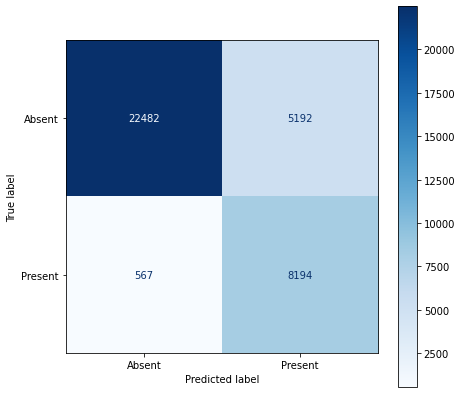

In [ ]:
lgb_clasifier.fit(X_train, y_train)

predictions = lgb_clasifier.predict(X_test)
results = {'predicted':[], 'actual':[]}     
results['predicted'].extend(predictions)
results['actual'].extend(list(y_test))   
print(classification_report(y_test, predictions,digits=5))

disp = ConfusionMatrixDisplay.from_predictions(results['actual'], results['predicted'], display_labels=['Absent', 'Present'], cmap='Blues')
disp.figure_.set_size_inches((7, 7))
plt.show()

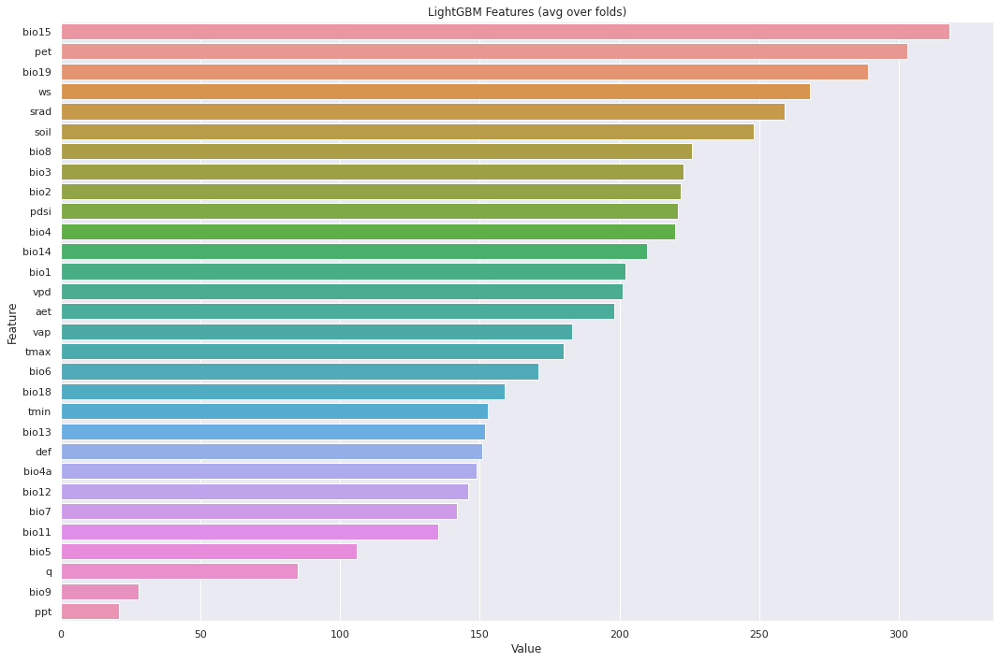

In [ ]:
feature_imp = pd.DataFrame({'Value':lgb_clasifier.feature_importances_,'Feature':X.columns})
plt.figure(figsize=(15,10))
sns.set(font_scale = 1)
sns.barplot(x="Value", y="Feature", data=feature_imp.sort_values(by="Value", 
                                                    ascending=False)[0:34])
plt.title('LightGBM Features (avg over folds)')
plt.tight_layout()
plt.savefig('lgbm_importances-01.png')
plt.show()

# MODEL EVALUATION FOR DIFERENT YEARS

## FINAL CLASIFIER

In [ ]:
lgb_clasifier =  lgb.LGBMClassifier(baggingFraction=0.7919582030577866, colsample_bytree= 0.22555774633464717, featureFraction= 0.8580616162813256, 
 lambdaL1= 0.7027042200235055, lambdaL2=59.87623577428611, learning_rate= 0.9749307583148132, max_bin= 59, max_depth=72, minSumHessianInLeaf= 0.11309715489381478,
 min_child_weight= 46, min_data_in_leaf= 43, min_split_gain= 0.10351855586031637, n_estimators=660, num_leaves=112, 
 reg_alpha= 0.26899007162731453, reg_lambda=0.19664148137953907, subsample= 0.5890662698522485,  is_unbalance=True)

## EVALUATION WEATHER DATA 2019

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 out of  25 | elapsed:  8.3min finished


              precision    recall  f1-score   support

           0    0.91912   0.91311   0.91611     27691
           1    0.73093   0.74603   0.73841      8761

    accuracy                        0.87296     36452
   macro avg    0.82503   0.82957   0.82726     36452
weighted avg    0.87389   0.87296   0.87340     36452



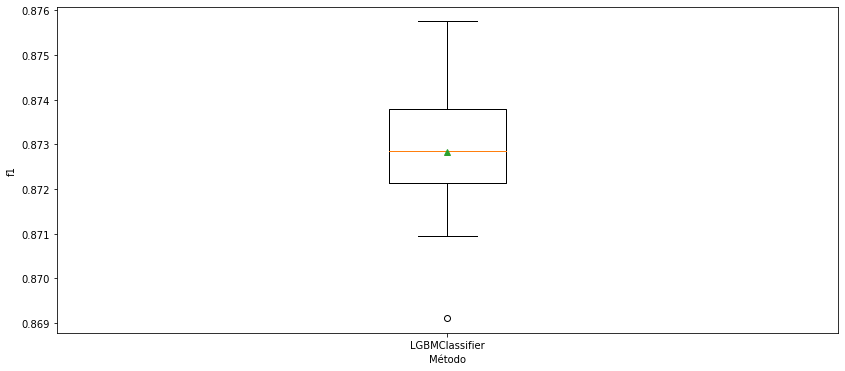

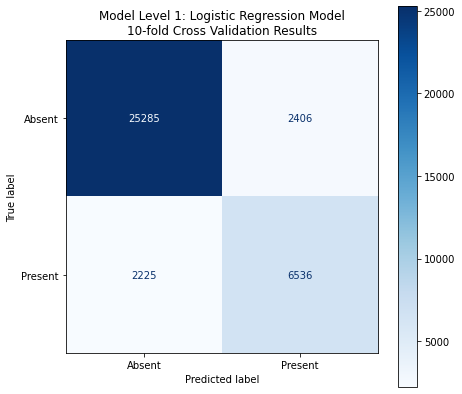

In [ ]:
score_2019 = model_evaluation(frog_data_2019, lgb_clasifier)

In [ ]:
np.mean(score_2019)

0.8726330552149393

In [ ]:
score_2019.sort()
score_2019

array([0.8682564 , 0.86901207, 0.86931822, 0.86989193, 0.87092421,
       0.87107481, 0.87144142, 0.87172635, 0.8720785 , 0.8721435 ,
       0.87236233, 0.87238996, 0.87239181, 0.87254942, 0.87280327,
       0.87373279, 0.87418339, 0.87418401, 0.87431155, 0.87457385,
       0.8747232 , 0.87500406, 0.87523729, 0.87553383, 0.87597819])

## EVALUATION WEATHER DATA 2018

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 out of  25 | elapsed:  8.1min finished


              precision    recall  f1-score   support

           0    0.92031   0.91247   0.91637     27693
           1    0.73058   0.75026   0.74029      8761

    accuracy                        0.87348     36454
   macro avg    0.82544   0.83136   0.82833     36454
weighted avg    0.87471   0.87348   0.87405     36454



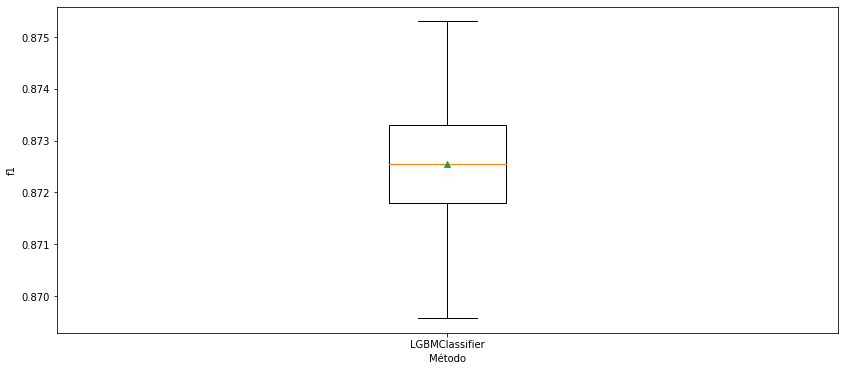

In [ ]:
score_2018 = model_evaluation(frog_data_2018, lgb_clasifier)

## EVALUATION WEATHER DATA 2017

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 out of  25 | elapsed:  8.5min finished


              precision    recall  f1-score   support

           0    0.92092   0.91165   0.91626     27731
           1    0.72898   0.75220   0.74041      8761

    accuracy                        0.87337     36492
   macro avg    0.82495   0.83192   0.82833     36492
weighted avg    0.87484   0.87337   0.87404     36492



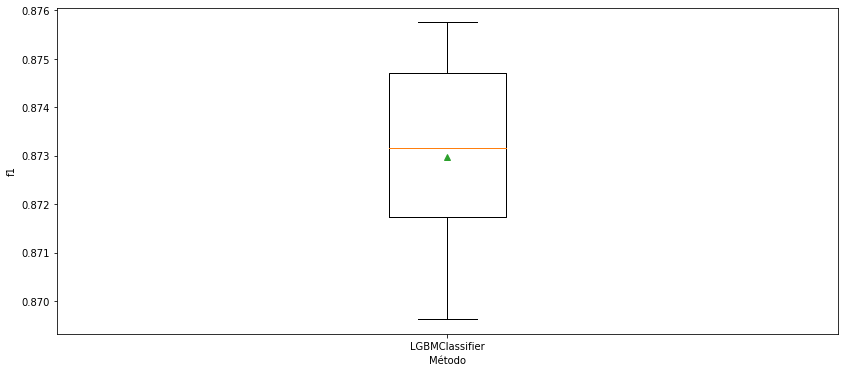

In [ ]:
score_2017 = model_evaluation(frog_data_2017, lgb_clasifier)

## EVALUATION WEATHER DATA 2016

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 out of  25 | elapsed:  9.0min finished


              precision    recall  f1-score   support

           0    0.91895   0.91168   0.91530     27707
           1    0.72751   0.74569   0.73649      8761

    accuracy                        0.87181     36468
   macro avg    0.82323   0.82869   0.82589     36468
weighted avg    0.87296   0.87181   0.87234     36468



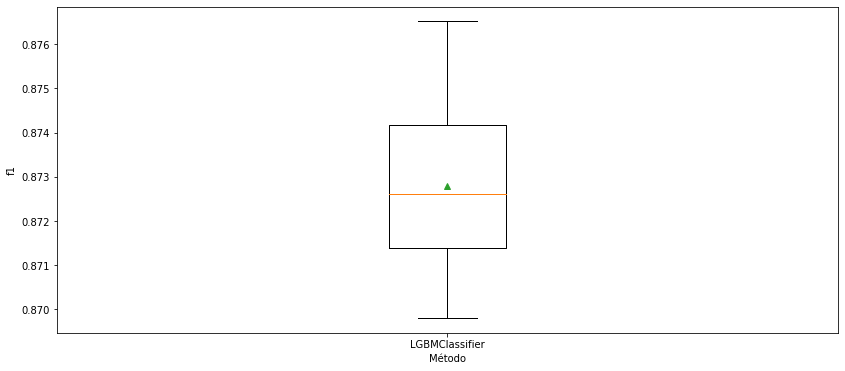

In [ ]:
score_2016 = model_evaluation(frog_data_2016, lgb_clasifier)

## EVALUATION WEATHER DATA 2015

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 out of  25 | elapsed:  9.4min finished


              precision    recall  f1-score   support

           0    0.91881   0.91174   0.91526     27703
           1    0.72755   0.74523   0.73628      8761

    accuracy                        0.87174     36464
   macro avg    0.82318   0.82849   0.82577     36464
weighted avg    0.87285   0.87174   0.87226     36464



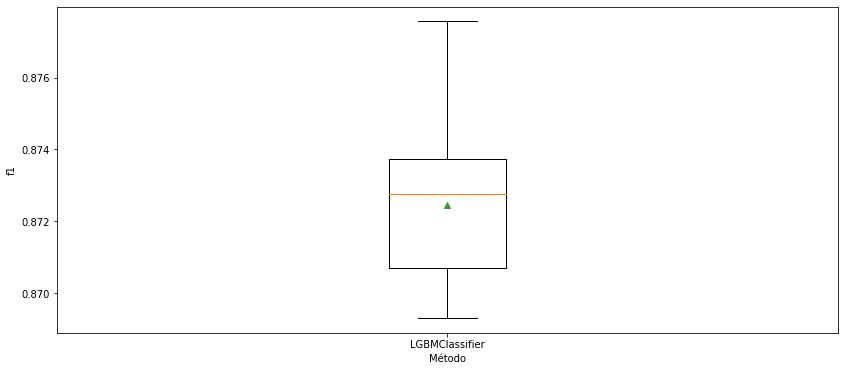

In [ ]:
score_2015 = model_evaluation(frog_data_2015, lgb_clasifier)

# FINAL EVALUATION

In [ ]:
score_year = []
score_year.append(score_2019)
score_year.append(score_2018)
score_year.append(score_2017)
score_year.append(score_2016)
score_year.append(score_2015)

Text(0, 0.5, 'f1')

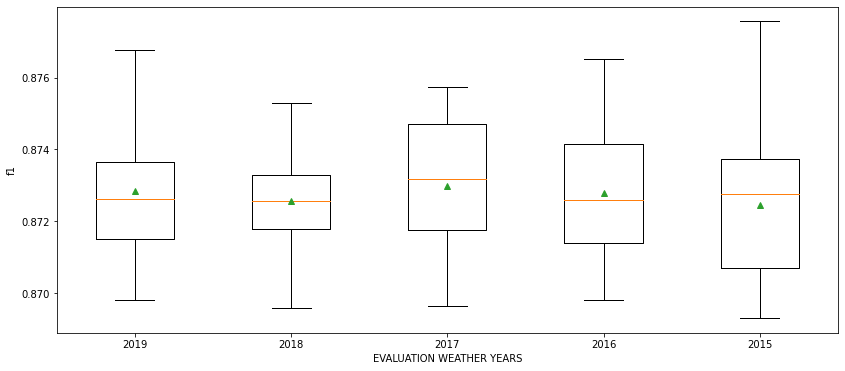

In [ ]:
fig,axes = plt.subplots(1,figsize=(14,6))
axes.boxplot(score_year,labels=['2019', "2018", "2017", "2016", "2015"],showmeans=True)
axes.set_xlabel("EVALUATION WEATHER YEARS")
axes.set_ylabel("f1")

# TRAIN MODEL

In [ ]:
def train_model(all_frog_data_weather, clasifier, balance=False):

  all_frog_data_weather = all_frog_data_weather.dropna(axis= 0)

  df = (all_frog_data_weather.drop(['decimalLatitude', 'decimalLongitude'], 1))

  y = df.occurrenceStatus.astype(int)
  X = df.drop(columns=['occurrenceStatus'])


  trans = PowerTransformer(method='yeo-johnson')


  numeric_features = ['aet', 'bio1', 'bio11', 'bio12', 'bio13', 'bio14', 'bio15', 'bio18',
       'bio19', 'bio2', 'bio3', 'bio4', 'bio4a', 'bio5', 'bio6', 'bio7',
       'bio8', 'bio9', 'def', 'pdsi', 'pet', 'ppt', 'q', 'soil', 'srad',
       'tmax', 'tmin', 'vap', 'vpd', 'ws']

  numeric_transformer = Pipeline(steps=[("scaler", trans)])
  preprocessor = ColumnTransformer(
  transformers=[
          ("num", numeric_transformer, numeric_features),
          ])


  model = Pipeline(steps=[("preprocessor", preprocessor),
                          ("classifier", CalibratedClassifierCV(clasifier, method='isotonic', cv=5))
                          ])
      
  model.fit(X, y)
      
  return model

In [ ]:
model_2019 = train_model(frog_data_2019, lgb_clasifier)

In [ ]:
import pickle

In [ ]:
with open('/content/drive/MyDrive/EY/model_2019.pkl','wb') as f:
    pickle.dump(model_2019,f)